# cuda:4

In [1]:
import sys
sys.path.insert(1,'/home/bwhiteak/ChaosESN/ESN_utils/')

import numpy as np
import torch
import rc_tools as rct
import rc_analysis as rca
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
from scipy.optimize import fsolve
from scipy.signal import argrelextrema
import warnings
import time

import pdb

from skopt.space import Real,Integer
from skopt.utils import use_named_args
from skopt import gp_minimize

from scipy.integrate import odeint
from mpl_toolkits.mplot3d import Axes3D

import traceback
import warnings
warnings.filterwarnings("ignore")

from jupyterthemes import jtplot
jtplot.style()

np.random.seed(11)
torch.set_printoptions(precision=10)
dtype = torch.float32 

print(f'Python: {sys.version}')
print(f'Numpy: {np.__version__}')
print(f'Torch: {torch.__version__}')

DEVICE = 'cuda:4'

FREERUN = 20
DT = .02

rho = 28.0
sigma = 10.0
beta = 8/3

def f(state, t):
    x,y,z = state
    return sigma*(y-x), x*(rho-z)-y, x*y - beta*z

state0 = [1.,1.,1.]
t = np.arange(0,300+FREERUN,DT)
states = odeint(f,state0,t)

muX = np.mean(states[:,0])
signal = states[:,0]-muX

M = signal.shape[0] - int(FREERUN/DT)
K = 1
L = 1
RF = .5
TEST = 1000
LEAD = 100
BURNIN = 100
REG = 1e-8
TRAINLENGTH = M-TEST


MINMAX = np.max(signal[:TRAINLENGTH+TEST]) - np.min(signal[:TRAINLENGTH+TEST])
STD = np.std(signal[:TRAINLENGTH+TEST])
BINS = 50

print(f'Signal length M={M}')
print(f'Normalizing value max-min id {MINMAX:.3f}')
print(f'Normalizing value std id {STD:.3f}')

Python: 3.8.12 (default, Oct 12 2021, 13:49:34) 
[GCC 7.5.0]
Numpy: 1.21.2
Torch: 1.10.0
Signal length M=15000
Normalizing value max-min id 38.053
Normalizing value std id 7.912


In [2]:
def get_weight_matricesGPU(k,n,l,ri,ro):
    win = torch.rand((n,k),dtype=dtype,
                      device=torch.device(DEVICE)).sub(.5).mul(ri)
    wfb = torch.zeros((n,l),dtype=dtype, device=torch.device(DEVICE))
    wout = torch.rand((l,n+k),dtype=dtype,
                      device=torch.device(DEVICE)).sub(.5).mul(ro)
    return win, wfb, wout

def set_vectorsGPU(n,l,r):
    x0 = torch.rand((n,1),dtype=dtype,
                      device=torch.device(DEVICE)).sub(.5).mul(r)
    y0 = torch.zeros((l,1),dtype=dtype, device=torch.device(DEVICE))
    return x0, y0

def update_res_stateGPU(wnet,xt,uxy,a,g):
    z = torch.matmul(wnet,uxy)
    return torch.mul(xt,1-a) + torch.mul(torch.tanh(z),a*g)

def predict_yGPU(wout,xu):
    return torch.matmul(wout, xu)

def get_matrixGPU(n,r,sr):
    A = (torch.rand((n,n),dtype=dtype,
                   device=torch.device(DEVICE))-.5)*r
    At = torch.transpose(A,0,1)
    D = torch.diag(torch.diag(A))   
    W = A + At - D
    eig = torch.eig(W, eigenvectors=False)
    wsr = torch.max(torch.abs(eig[0]))
    return W.div(wsr).mul(sr)

def resize_spaces(mn, mx, best, isAlpha=False):
    #pdb.set_trace()
    if(best.size==0):
        new_mn = np.max([0, mn - .5*mn])
        new_mx = 1.5*mx
    else:
        best_mn = np.min(best)
        best_mx = np.max(best)
        mn_bound = (best_mn-mn)/2
        mx_bound = (mx -best_mx)/2
        new_mn, new_mx = best_mn-mn_bound, best_mx+mx_bound
        print(f'\nBest mn:{best_mn:.3f}\t mn:{best_mx:.3f}')
        print(f'New bounds mn--mx: {mn_bound:.3f}--{mx_bound:.3f}')
    if(isAlpha):
        if(new_mx>1):
            new_mx = 1
    
    return new_mn, new_mx

In [3]:
import json
from json import JSONEncoder

# numpy arrays cannot be written to json 
# convert to list
class NumpyArrayEncoder(JSONEncoder):
    def default(self,obj):
        if isinstance(obj,np.ndarray):
            return obj.tolist()
        return JSONEncoder.default(self,obj)

In [4]:
#min_a, max_a = .25, .4
#min_sr, max_sr = 1.25, 1.45
#min_ri, max_ri = .001, 4.
#min_rr, max_rr = .001, 4.

#min_a, max_a = .55, .85
#min_sr, max_sr = 1.2, 1.5
#min_g, max_g = .4, 1.1
#min_ri, max_ri = .001, .15
#min_rr, max_rr = 1.5, 2.3

min_a, max_a = .5, .9
min_sr, max_sr = 1., 1.5
min_g, max_g = .4, 1.1
min_ri, max_ri = .001, .3
min_rr, max_rr = 1, 3

space = [Real(min_a, max_a, name='a'),
         Real(min_sr, max_sr, name='sr'),
         Real(min_ri, max_ri, name='ri'),
         Real(min_rr, max_rr, name='rr')
        ]

@use_named_args(space)
def loop(a=1.0,sr=1.0,ri=1.0,rr=1.0):
    start = time.time()
    amp = 1.
    global running_error, s, counter, signal, N, \
           alphas, rhos, gammas, inScales, resScales, dict_model, \
           model_counter, error_per_N, error_over_N, best_N_model
    
    ut = torch.zeros((1,1),dtype=dtype,
                     device=torch.device(DEVICE))
    tp = torch.zeros((1,1),dtype=dtype,
                     device=torch.device(DEVICE))
    
    Wres = get_matrixGPU(N,rr,sr)
    Win, Wfb, Wout = get_weight_matricesGPU(K,N,L,ri,RF)
    Wnet = torch.cat((Win,Wres,Wfb),1)
    xt, yt = set_vectorsGPU(N,L,rr)

    states = torch.zeros((TRAINLENGTH, N+K),dtype=dtype,
                          device=DEVICE)
    targets = torch.zeros((TRAINLENGTH),dtype=dtype,
                          device=DEVICE)
    for i in range(TRAINLENGTH):
        ut[0,0] = s[i]
        tp[0,0] = s[i+1]
        targets[i] = s[i+1]
        uxy = torch.cat((ut,xt,yt),0)
        xt1 = update_res_stateGPU(Wnet,xt,uxy,a,amp)
        xu = torch.transpose(torch.cat((xt1,ut),0),0,1).to(DEVICE)
        states[i,:] = xu[0,:]
        xt, yt = xt1, tp 

    state = states.detach().cpu().numpy()

    torch.cuda.synchronize()
    wout = rct.get_trained_weights(state[BURNIN:],
                                   signal[BURNIN+1:TRAINLENGTH+1],
                                   REG)
    Wout = torch.from_numpy(wout.reshape(L,N+K)).type(dtype).cuda(DEVICE)
    torch.cuda.synchronize()

    predictions = torch.zeros((M+int(FREERUN/DT),1),
                              dtype=dtype,
                              device=torch.device(DEVICE))

    xt, yt = set_vectorsGPU(N,L,rr)
    ut.fill_(0.0)
    for i in range(M+int(FREERUN/DT)):
        if(i < TRAINLENGTH):
            ut[0,0] = s[i]
        else:
            ut = yt
        uxy = torch.cat((ut,xt,yt),0)
        xt1 = update_res_stateGPU(Wnet,xt,uxy,a,amp)
        xu = torch.cat((xt1,ut),0)
        yt1 = predict_yGPU(Wout,xu)
        predictions[i] = yt1[0,0]
        xt, yt = xt1, yt1

    yHat_GPU = predictions.detach().cpu().numpy()
    
    nrmse = 1000.0
    try:
        nrmse = rca.NRMSE(signal[TRAINLENGTH:TRAINLENGTH+TEST],
                          yHat_GPU[TRAINLENGTH:TRAINLENGTH+TEST],
                          MINMAX) 
    except Exception as e:
        pass #traceback.print_exc()
        
    
    try:
        nrmse_std = rca.NRMSE(signal[TRAINLENGTH:TRAINLENGTH+TEST],
                          yHat_GPU[TRAINLENGTH:TRAINLENGTH+TEST],
                          STD) 
    except Exception as e:
        pass #traceback.print_exc()
    
    
    av = signal[TRAINLENGTH:TRAINLENGTH+TEST].reshape(TEST,1)
    bv = np.squeeze(yHat_GPU[TRAINLENGTH:TRAINLENGTH+TEST]).reshape(TEST,1)
    num = np.squeeze(np.dot(av.T,bv))
    den = np.linalg.norm(av)*np.linalg.norm(bv)
    cosine_similarity = num/den
    cosine_distance = 1 - cosine_similarity
    dist = cosine_distance
    
    loss = nrmse + dist
    if(np.isnan(loss) or (np.isinf(loss) or (loss > 1000.0))):
        loss = 1000
    
    if((loss < running_error) and (nrmse < .3)):
        print(f'Dist {dist:3f}')
        running_error = loss
        wnet = Wnet.detach().cpu().numpy()
        currentParams = np.array([a,sr,amp,ri,rr,loss])
        if(error_over_N > running_error):
            print('\n\nNew N best!!!!!!!!!!!!\n\n')
            error_over_N = running_error  #set the lowest error
            best_N_model = [N,ref,rn,counter]
            states_dict = {'States': state}
            with open(f'Dicts/States/states_L3D_{N}.json', 'w') as fp:
                json.dump(states_dict, fp, cls=NumpyArrayEncoder)
            dict_model[str(N)] = {'Wnet': wnet,
                                  'Wout': wout,
                                  'Preds': yHat_GPU,
                                  'Params': currentParams}
            print(best_N_model)
            
        alphas.append(a)
        rhos.append(sr)
        gammas.append(amp)
        inScales.append(ri)
        resScales.append(rr)
        
        fig = plt.figure(figsize=(10,8))
        ax1 = plt.subplot(111)
        ax1.plot(signal[TRAINLENGTH-LEAD:], label='Target')
        ax1.plot(yHat_GPU[TRAINLENGTH-LEAD:], label='GPU')
        ax1.axvline(LEAD,c='orange',linestyle='dashed')
        ax1.axvline(LEAD+TEST,c='r',linestyle='dashed')
        ax1.set_ylim(-25,25)
        ax1.legend()
        plt.show()
        plt.close()
        model_counter += 1
        error_per_N.append(nrmse)
        
        print(f' Iter={counter} a={a:.3f} sr={sr:.3f} amp={amp:.3f}',
              f' ri={ri:.3f} rr={rr:.3f} loss={loss:3f} nrmse={nrmse:3f} CD {dist:3f}')
    ####### Running info ##############################
    print(f'Iter: {counter} #### Time {(time.time()-start):.2f}',
          f' NRMSE {nrmse:.3f} CD {dist:.3f}')
    ###### Store this run #############################
    dict_counters[str(N)] = {'numModels': model_counter,
                             'meanError': np.mean(np.array(error_per_N),axis=0).tolist(),
                             'varError' : np.var(np.array(error_per_N),axis=0).tolist()}
    counter += 1
    return loss

********** Size 50 -- Run 0 ***********
Iter: 0 #### Time 7.79  NRMSE 12.769 CD 0.974
Iter: 1 #### Time 3.81  NRMSE 0.618 CD 1.032
Iter: 2 #### Time 3.79  NRMSE 0.438 CD 1.083
Iter: 3 #### Time 3.77  NRMSE 0.475 CD 1.033
Dist 0.844615


New N best!!!!!!!!!!!!


[50, 0, 0, 4]


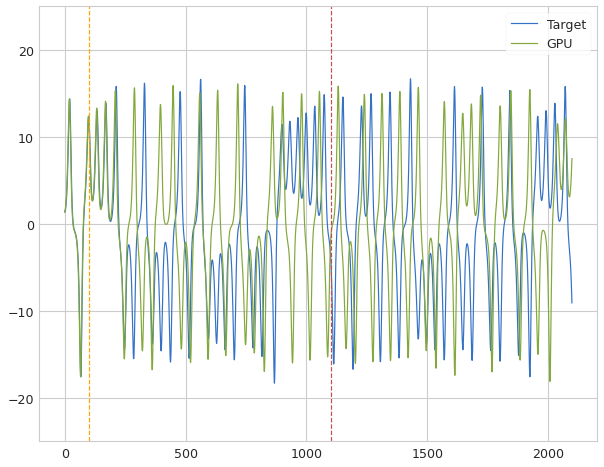

 Iter=4 a=0.888 sr=1.398 amp=1.000  ri=0.078 rr=2.025 loss=1.115108 nrmse=0.270493 CD 0.844615
Iter: 4 #### Time 4.96  NRMSE 0.270 CD 0.845
Iter: 5 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 6 #### Time 3.75  NRMSE 0.494 CD 0.949
Iter: 7 #### Time 3.79  NRMSE 1.568 CD 1.003
Iter: 8 #### Time 3.79  NRMSE 1.892 CD 0.988
Iter: 9 #### Time 3.77  NRMSE 3.051 CD 1.107
Iter: 10 #### Time 3.78  NRMSE 0.355 CD 1.074
Iter: 11 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 12 #### Time 3.74  NRMSE 0.290 CD 0.900
Iter: 13 #### Time 3.77  NRMSE 0.322 CD 1.064
Iter: 14 #### Time 3.75  NRMSE 1000.000 CD nan
Iter: 15 #### Time 3.74  NRMSE 0.521 CD 0.957
Iter: 16 #### Time 3.76  NRMSE 0.324 CD 1.054
Iter: 17 #### Time 3.75  NRMSE 1.110 CD 1.130
Iter: 18 #### Time 3.74  NRMSE 0.505 CD 1.065
Iter: 19 #### Time 3.76  NRMSE 0.289 CD 0.981
Iter: 20 #### Time 4.03  NRMSE 0.280 CD 0.917
Iter: 21 #### Time 4.01  NRMSE 0.380 CD 0.878
Iter: 22 #### Time 3.74  NRMSE 1000.000 CD nan
Iter: 23 #### Time 3.74  NRMSE 0.

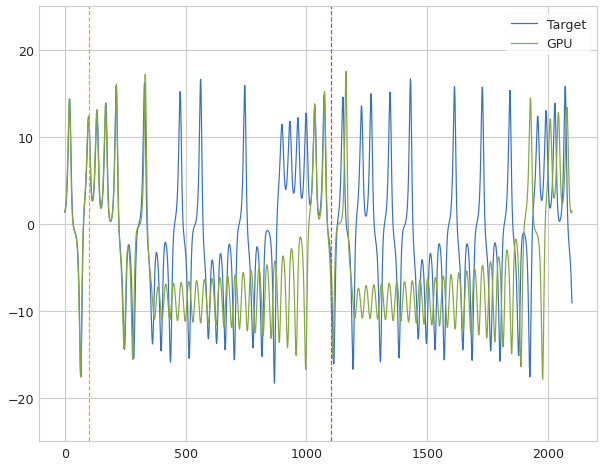

 Iter=24 a=0.543 sr=1.242 amp=1.000  ri=0.086 rr=2.711 loss=0.757950 nrmse=0.222218 CD 0.535732
Iter: 24 #### Time 5.06  NRMSE 0.222 CD 0.536
Iter: 25 #### Time 3.76  NRMSE 1000.000 CD nan
Iter: 26 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 27 #### Time 3.75  NRMSE 0.248 CD 0.732
Iter: 28 #### Time 3.77  NRMSE 1.694 CD 0.996
Iter: 29 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 30 #### Time 3.90  NRMSE 1000.000 CD nan
Iter: 31 #### Time 3.77  NRMSE 0.302 CD 0.838
Iter: 32 #### Time 3.78  NRMSE 0.288 CD 0.982
Iter: 33 #### Time 3.82  NRMSE 0.322 CD 1.061
Iter: 34 #### Time 3.76  NRMSE 1.107 CD 1.006
Iter: 35 #### Time 3.78  NRMSE 0.339 CD 1.016
Iter: 36 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 37 #### Time 3.79  NRMSE 0.302 CD 1.081
Iter: 38 #### Time 3.75  NRMSE 1000.000 CD nan
Iter: 39 #### Time 3.77  NRMSE 0.531 CD 1.075
Iter: 40 #### Time 3.76  NRMSE 1.772 CD 0.846
Iter: 41 #### Time 3.80  NRMSE 0.718 CD 1.036
Iter: 42 #### Time 3.77  NRMSE 0.347 CD 0.976
Iter: 43 #### Time 3.76 

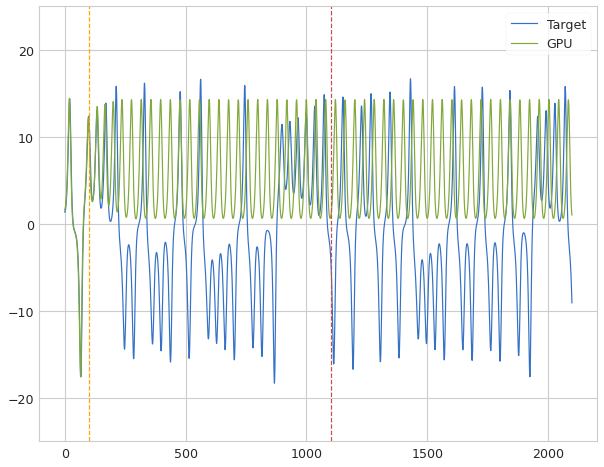

 Iter=2 a=0.552 sr=1.261 amp=1.000  ri=0.058 rr=2.578 loss=1.285274 nrmse=0.287356 CD 0.997918
Iter: 2 #### Time 4.08  NRMSE 0.287 CD 0.998
Iter: 3 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 4 #### Time 3.97  NRMSE 0.502 CD 1.027
Iter: 5 #### Time 3.95  NRMSE 1.217 CD 1.114
Iter: 6 #### Time 3.99  NRMSE 0.325 CD 1.074
Dist 0.512704


New N best!!!!!!!!!!!!


[50, 0, 1, 7]


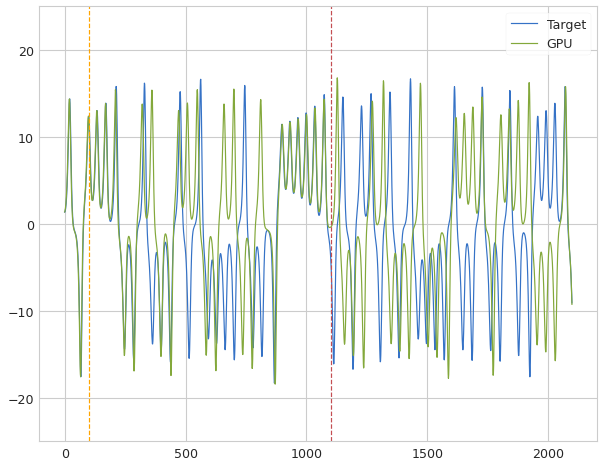

 Iter=7 a=0.764 sr=1.294 amp=1.000  ri=0.061 rr=2.582 loss=0.721345 nrmse=0.208640 CD 0.512704
Iter: 7 #### Time 5.15  NRMSE 0.209 CD 0.513
Iter: 8 #### Time 3.97  NRMSE 0.501 CD 0.973
Iter: 9 #### Time 3.96  NRMSE 0.287 CD 0.903
Iter: 10 #### Time 3.96  NRMSE 0.886 CD 0.996
Iter: 11 #### Time 3.96  NRMSE 3.096 CD 1.156
Iter: 12 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 13 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 14 #### Time 3.95  NRMSE 0.363 CD 0.923
Iter: 15 #### Time 3.96  NRMSE 0.314 CD 1.033
Iter: 16 #### Time 3.96  NRMSE 0.323 CD 0.904
Iter: 17 #### Time 3.95  NRMSE 0.305 CD 1.050
Iter: 18 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 19 #### Time 3.94  NRMSE 0.638 CD 1.045
Iter: 20 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 21 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 22 #### Time 3.87  NRMSE 0.918 CD 1.020
Iter: 23 #### Time 3.83  NRMSE 1000.000 CD nan
Iter: 24 #### Time 3.82  NRMSE 0.792 CD 1.036
Iter: 25 #### Time 3.82  NRMSE 0.379 CD 1.212
Iter: 26 #### Time 3.79  NRM

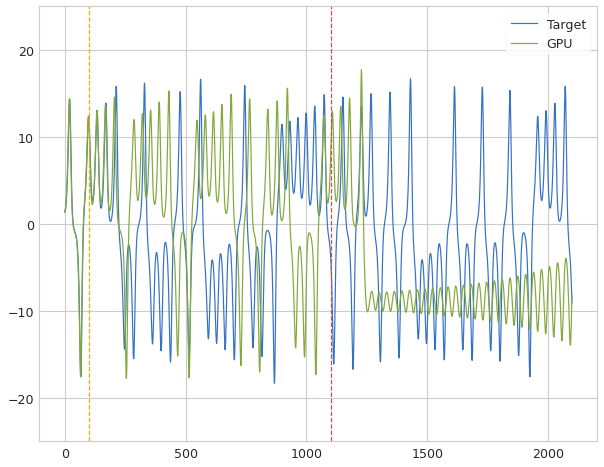

 Iter=14 a=0.706 sr=1.291 amp=1.000  ri=0.081 rr=2.316 loss=1.357830 nrmse=0.299211 CD 1.058619
Iter: 14 #### Time 5.42  NRMSE 0.299 CD 1.059
Iter: 15 #### Time 5.29  NRMSE 0.380 CD 0.945
Iter: 16 #### Time 5.25  NRMSE 1000.000 CD nan
Iter: 17 #### Time 5.25  NRMSE 0.314 CD 1.055
Iter: 18 #### Time 5.30  NRMSE 1000.000 CD nan
Iter: 19 #### Time 5.29  NRMSE 0.674 CD 0.970
Iter: 20 #### Time 5.26  NRMSE 1000.000 CD nan
Dist 0.820262


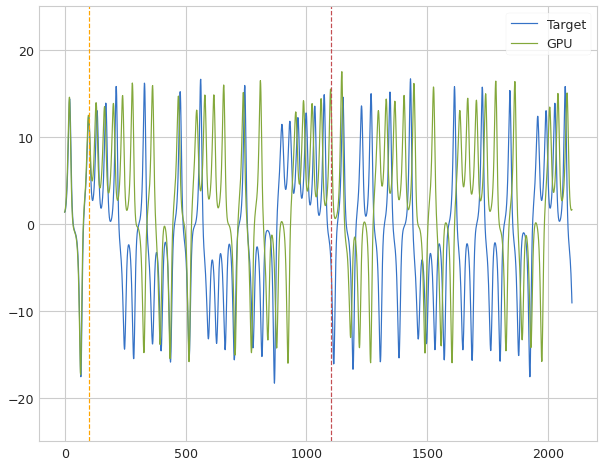

 Iter=21 a=0.632 sr=1.272 amp=1.000  ri=0.053 rr=2.425 loss=1.089699 nrmse=0.269437 CD 0.820262
Iter: 21 #### Time 5.41  NRMSE 0.269 CD 0.820
Iter: 22 #### Time 5.30  NRMSE 1.483 CD 0.998
Iter: 23 #### Time 5.26  NRMSE 0.383 CD 0.965
Dist 0.719631


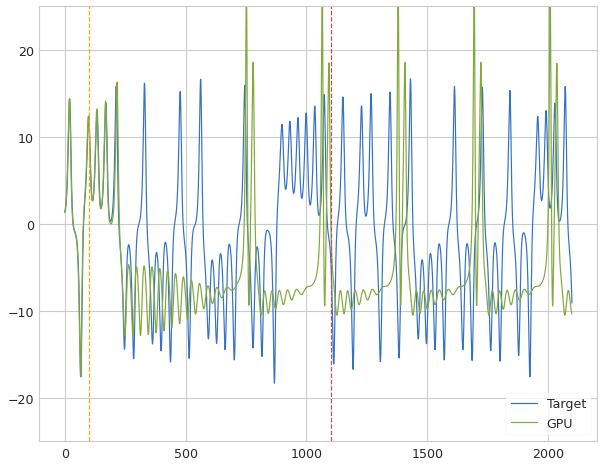

 Iter=24 a=0.613 sr=1.376 amp=1.000  ri=0.055 rr=2.828 loss=0.980078 nrmse=0.260447 CD 0.719631
Iter: 24 #### Time 5.38  NRMSE 0.260 CD 0.720
Iter: 25 #### Time 5.24  NRMSE 0.314 CD 1.063
Iter: 26 #### Time 5.25  NRMSE 0.289 CD 0.862
Iter: 27 #### Time 5.26  NRMSE 0.324 CD 0.878
Iter: 28 #### Time 5.26  NRMSE 0.318 CD 0.922
Iter: 29 #### Time 5.30  NRMSE 1000.000 CD nan
Iter: 30 #### Time 5.29  NRMSE 0.308 CD 1.058
Iter: 31 #### Time 5.28  NRMSE 0.474 CD 0.943
Iter: 32 #### Time 5.27  NRMSE 2.694 CD 0.847
Iter: 33 #### Time 5.26  NRMSE 15.676 CD 1.126
Iter: 34 #### Time 5.27  NRMSE 0.279 CD 0.935
Iter: 35 #### Time 5.26  NRMSE 1.158 CD 0.991
Iter: 36 #### Time 5.27  NRMSE 1000.000 CD nan
Iter: 37 #### Time 5.27  NRMSE 0.364 CD 1.015
Iter: 38 #### Time 5.29  NRMSE 1.492 CD 1.005
Iter: 39 #### Time 5.28  NRMSE 1000.000 CD nan
Iter: 40 #### Time 5.28  NRMSE 0.312 CD 1.055
Iter: 41 #### Time 5.27  NRMSE 1000.000 CD nan
Iter: 42 #### Time 5.25  NRMSE 0.288 CD 0.970
Iter: 43 #### Time 5.26  

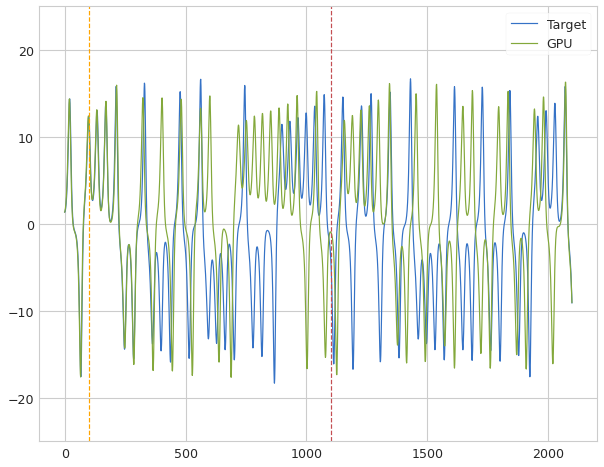

 Iter=65 a=0.542 sr=1.343 amp=1.000  ri=0.083 rr=2.635 loss=0.917201 nrmse=0.239934 CD 0.677267
Iter: 65 #### Time 3.90  NRMSE 0.240 CD 0.677
Iter: 66 #### Time 3.85  NRMSE 0.351 CD 1.084
Iter: 67 #### Time 3.79  NRMSE 0.293 CD 0.991
Iter: 68 #### Time 3.77  NRMSE 0.384 CD 0.892
Iter: 69 #### Time 3.77  NRMSE 7.479 CD 0.908
Iter: 70 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 71 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 72 #### Time 3.77  NRMSE 0.288 CD 0.961
Iter: 73 #### Time 3.79  NRMSE 0.766 CD 0.971
Iter: 74 #### Time 3.88  NRMSE 1000.000 CD nan
Iter: 75 #### Time 3.78  NRMSE 0.293 CD 0.944
Iter: 76 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 77 #### Time 3.79  NRMSE 0.287 CD 0.897
Iter: 78 #### Time 3.77  NRMSE 0.565 CD 0.933
Iter: 79 #### Time 3.79  NRMSE 0.888 CD 0.961
Iter: 80 #### Time 3.77  NRMSE 1.423 CD 1.374
Iter: 81 #### Time 3.81  NRMSE 4.162 CD 0.995
Iter: 82 #### Time 3.79  NRMSE 0.241 CD 1.113
Iter: 83 #### Time 3.77  NRMSE 0.301 CD 1.003
Iter: 84 #### Time 3.79  N

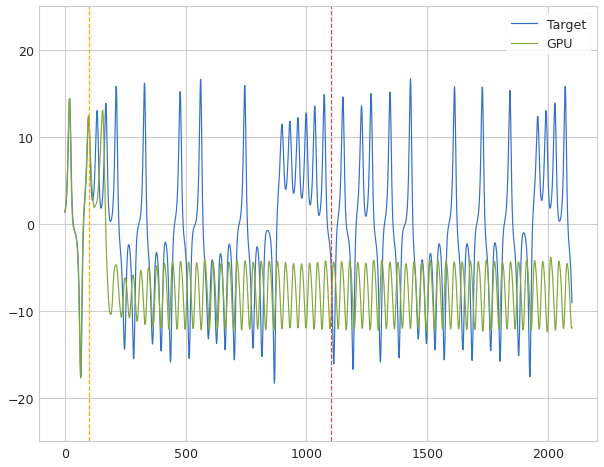

 Iter=2 a=0.610 sr=1.312 amp=1.000  ri=0.003 rr=2.665 loss=1.111670 nrmse=0.275429 CD 0.836242
Iter: 2 #### Time 3.90  NRMSE 0.275 CD 0.836
Iter: 3 #### Time 3.81  NRMSE 0.281 CD 0.905
Iter: 4 #### Time 3.77  NRMSE 0.719 CD 0.911
Iter: 5 #### Time 3.76  NRMSE 1000.000 CD nan
Iter: 6 #### Time 3.80  NRMSE 0.318 CD 1.109
Iter: 7 #### Time 3.80  NRMSE 1000.000 CD nan
Iter: 8 #### Time 3.76  NRMSE 4.492 CD 1.000
Iter: 9 #### Time 3.77  NRMSE 0.326 CD 1.075
Iter: 10 #### Time 3.77  NRMSE 1.990 CD 0.999
Iter: 11 #### Time 3.75  NRMSE 0.313 CD 1.060
Iter: 12 #### Time 3.76  NRMSE 0.296 CD 1.067
Iter: 13 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 14 #### Time 3.81  NRMSE 0.353 CD 1.062
Iter: 15 #### Time 3.76  NRMSE 0.291 CD 0.950
Iter: 16 #### Time 3.78  NRMSE 0.452 CD 0.995
Iter: 17 #### Time 3.78  NRMSE 0.350 CD 0.894
Iter: 18 #### Time 3.77  NRMSE 0.379 CD 0.944
Iter: 19 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 20 #### Time 3.77  NRMSE 0.273 CD 0.883
Iter: 21 #### Time 3.77  NRMSE 1000

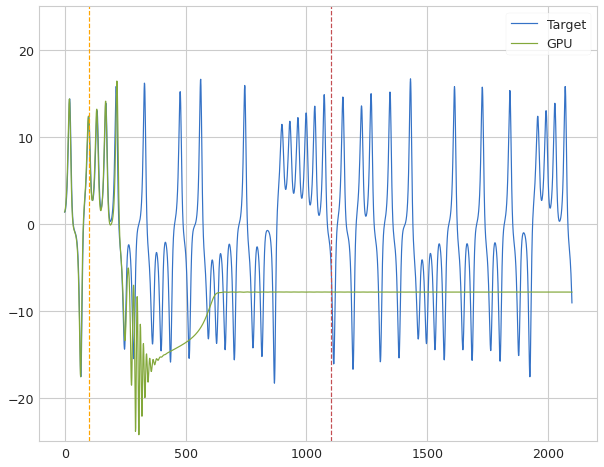

 Iter=22 a=0.768 sr=1.235 amp=1.000  ri=0.084 rr=2.581 loss=1.025777 nrmse=0.298028 CD 0.727749
Iter: 22 #### Time 3.88  NRMSE 0.298 CD 0.728
Iter: 23 #### Time 3.78  NRMSE 0.805 CD 0.977
Iter: 24 #### Time 3.76  NRMSE 1.200 CD 0.998
Iter: 25 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 26 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 27 #### Time 3.81  NRMSE 1000.000 CD nan
Iter: 28 #### Time 3.78  NRMSE 0.278 CD 0.796
Iter: 29 #### Time 3.76  NRMSE 0.297 CD 1.020
Iter: 30 #### Time 3.77  NRMSE 0.277 CD 1.039
Iter: 31 #### Time 3.76  NRMSE 0.355 CD 1.063
Iter: 32 #### Time 3.77  NRMSE 1.084 CD 0.952
Iter: 33 #### Time 3.78  NRMSE 1.968 CD 0.995
Iter: 34 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 35 #### Time 3.76  NRMSE 0.279 CD 0.892
Iter: 36 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 37 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 38 #### Time 3.76  NRMSE 0.643 CD 0.942
Iter: 39 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 40 #### Time 3.76  NRMSE 0.497 CD 1.046
Iter: 41 #### Time 3.77

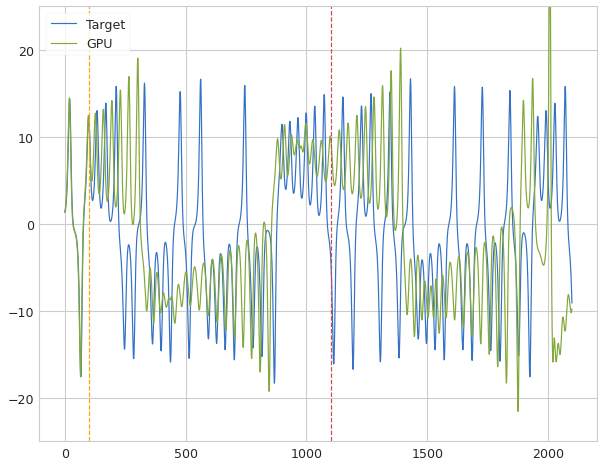

 Iter=114 a=0.570 sr=1.200 amp=1.000  ri=0.065 rr=3.000 loss=0.777971 nrmse=0.223746 CD 0.554225
Iter: 114 #### Time 4.10  NRMSE 0.224 CD 0.554
Iter: 115 #### Time 3.96  NRMSE 0.461 CD 0.972
Iter: 116 #### Time 3.95  NRMSE 0.321 CD 1.056
Iter: 117 #### Time 3.94  NRMSE 0.899 CD 0.889
Iter: 118 #### Time 3.79  NRMSE 0.285 CD 0.959
Iter: 119 #### Time 3.98  NRMSE 0.473 CD 1.072
Iter: 120 #### Time 3.86  NRMSE 0.319 CD 1.053
Iter: 121 #### Time 3.79  NRMSE 0.314 CD 1.068
Iter: 122 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 123 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 124 #### Time 3.99  NRMSE 0.256 CD 0.743
Iter: 125 #### Time 3.93  NRMSE 0.350 CD 1.066
Iter: 126 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 127 #### Time 3.97  NRMSE 0.304 CD 0.983
Iter: 128 #### Time 3.96  NRMSE 0.370 CD 1.111
Iter: 129 #### Time 3.98  NRMSE 0.408 CD 0.922
Iter: 130 #### Time 3.96  NRMSE 0.343 CD 0.934
Iter: 131 #### Time 3.97  NRMSE 1000.000 CD nan
Iter: 132 #### Time 3.98  NRMSE 0.319 CD 1.061
Iter: 

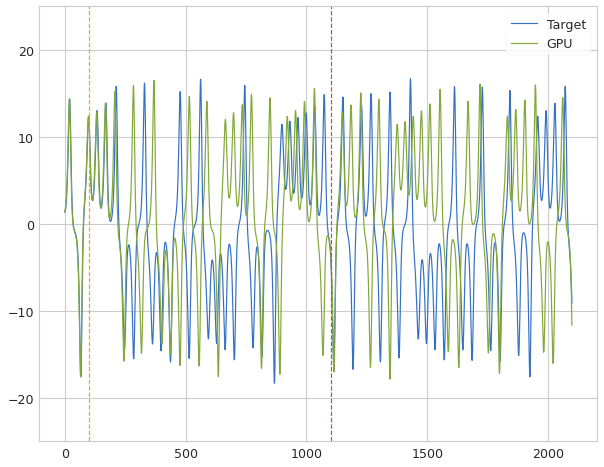

 Iter=3 a=0.540 sr=1.268 amp=1.000  ri=0.047 rr=2.527 loss=1.228147 nrmse=0.283724 CD 0.944423
Iter: 3 #### Time 4.08  NRMSE 0.284 CD 0.944
Iter: 4 #### Time 3.96  NRMSE 1.169 CD 1.005
Iter: 5 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 6 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 7 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 8 #### Time 3.95  NRMSE 0.324 CD 1.061
Dist 0.819313


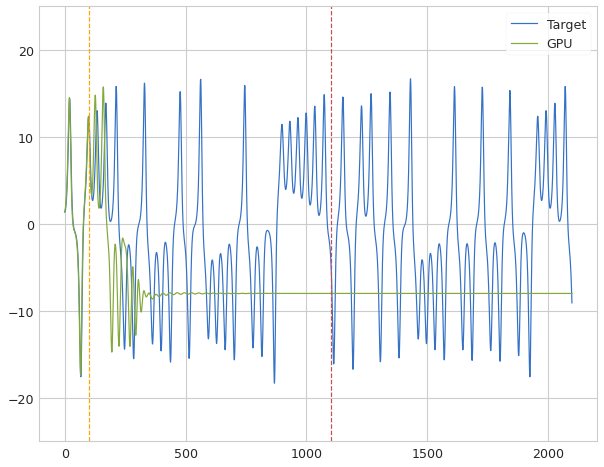

 Iter=9 a=0.597 sr=1.362 amp=1.000  ri=0.097 rr=2.798 loss=1.089390 nrmse=0.270078 CD 0.819313
Iter: 9 #### Time 4.06  NRMSE 0.270 CD 0.819
Iter: 10 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 11 #### Time 3.98  NRMSE 2.604 CD 0.995
Iter: 12 #### Time 3.95  NRMSE 2.761 CD 1.000
Iter: 13 #### Time 5.08  NRMSE 1.757 CD 1.000
Iter: 14 #### Time 5.34  NRMSE 1000.000 CD nan
Iter: 15 #### Time 5.30  NRMSE 2.360 CD 0.928
Iter: 16 #### Time 5.31  NRMSE 0.930 CD 0.892
Iter: 17 #### Time 5.27  NRMSE 0.487 CD 0.976
Iter: 18 #### Time 5.29  NRMSE 0.318 CD 1.060
Iter: 19 #### Time 3.87  NRMSE 1000.000 CD nan
Dist 0.781456


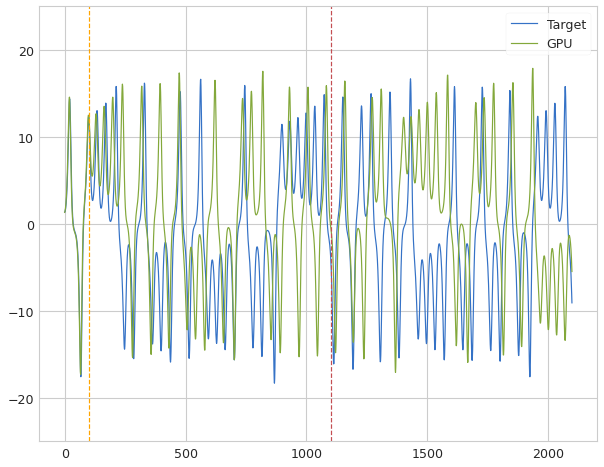

 Iter=20 a=0.580 sr=1.321 amp=1.000  ri=0.077 rr=2.158 loss=1.042319 nrmse=0.260863 CD 0.781456
Iter: 20 #### Time 3.91  NRMSE 0.261 CD 0.781
Iter: 21 #### Time 3.80  NRMSE 0.291 CD 0.959
Iter: 22 #### Time 3.79  NRMSE 0.459 CD 0.986
Iter: 23 #### Time 3.77  NRMSE 0.599 CD 0.971
Iter: 24 #### Time 3.79  NRMSE 0.330 CD 1.065
Iter: 25 #### Time 3.80  NRMSE 0.457 CD 1.074
Iter: 26 #### Time 3.79  NRMSE 0.724 CD 1.001
Iter: 27 #### Time 3.79  NRMSE 0.335 CD 1.067
Iter: 28 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 29 #### Time 3.79  NRMSE 0.315 CD 0.968
Iter: 30 #### Time 3.78  NRMSE 0.303 CD 1.061
Iter: 31 #### Time 3.78  NRMSE 0.507 CD 1.006
Iter: 32 #### Time 3.78  NRMSE 0.382 CD 0.955
Iter: 33 #### Time 3.79  NRMSE 1000.000 CD nan
Iter: 34 #### Time 3.78  NRMSE 0.332 CD 1.039
Iter: 35 #### Time 3.79  NRMSE 1000.000 CD nan
Iter: 36 #### Time 3.81  NRMSE 1000.000 CD nan
Iter: 37 #### Time 3.77  NRMSE 17.805 CD 1.108
Iter: 38 #### Time 3.84  NRMSE 0.340 CD 1.071
Iter: 39 #### Time 3.79  

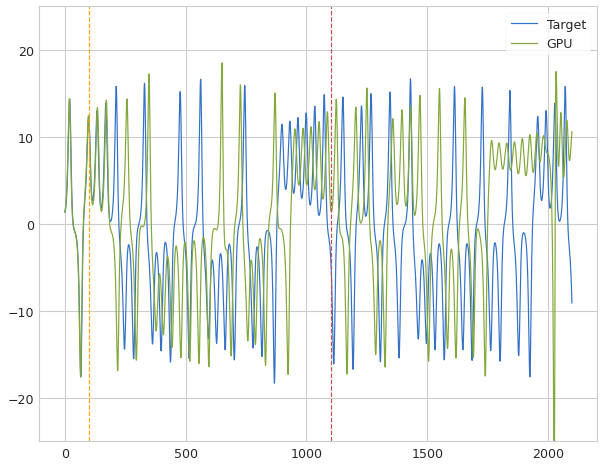

 Iter=62 a=0.505 sr=1.216 amp=1.000  ri=0.020 rr=2.007 loss=1.040348 nrmse=0.260306 CD 0.780042
Iter: 62 #### Time 3.92  NRMSE 0.260 CD 0.780
Iter: 63 #### Time 3.79  NRMSE 1000.000 CD nan
Iter: 64 #### Time 3.79  NRMSE 0.286 CD 1.049
Iter: 65 #### Time 3.79  NRMSE 1000.000 CD nan
Iter: 66 #### Time 3.78  NRMSE 0.303 CD 1.006
Iter: 67 #### Time 3.88  NRMSE 1000.000 CD nan
Iter: 68 #### Time 3.81  NRMSE 0.227 CD 1.034
Iter: 69 #### Time 3.82  NRMSE 1000.000 CD nan
Iter: 70 #### Time 3.77  NRMSE 2.710 CD 1.001
Iter: 71 #### Time 3.83  NRMSE 0.595 CD 1.001
Iter: 72 #### Time 3.78  NRMSE 1.450 CD 0.978
Iter: 73 #### Time 3.80  NRMSE 0.277 CD 0.824
Iter: 74 #### Time 3.79  NRMSE 0.312 CD 0.934
Iter: 75 #### Time 3.79  NRMSE 2.088 CD 1.007
Iter: 76 #### Time 3.79  NRMSE 0.309 CD 1.040
Iter: 77 #### Time 3.78  NRMSE 0.259 CD 0.876
Iter: 78 #### Time 3.80  NRMSE 1.681 CD 1.002
Iter: 79 #### Time 3.80  NRMSE 0.316 CD 1.057
Iter: 80 #### Time 3.81  NRMSE 0.321 CD 1.058
Iter: 81 #### Time 3.80  N

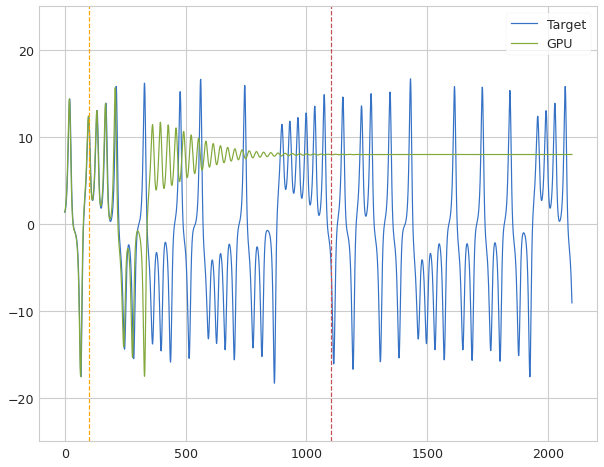

 Iter=3 a=0.814 sr=1.318 amp=1.000  ri=0.074 rr=2.673 loss=1.264252 nrmse=0.289881 CD 0.974371
Iter: 3 #### Time 4.08  NRMSE 0.290 CD 0.974
Iter: 4 #### Time 3.94  NRMSE 22624050954353320504555232292765696.000 CD 1.000
Iter: 5 #### Time 3.98  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.00  NRMSE 1000.000 CD nan
Iter: 7 #### Time 3.92  NRMSE 1.102 CD 0.971
Iter: 8 #### Time 3.86  NRMSE 0.905 CD 0.965
Iter: 9 #### Time 3.87  NRMSE 0.411 CD 1.141
Iter: 10 #### Time 3.79  NRMSE 0.352 CD 0.919
Dist 0.870663


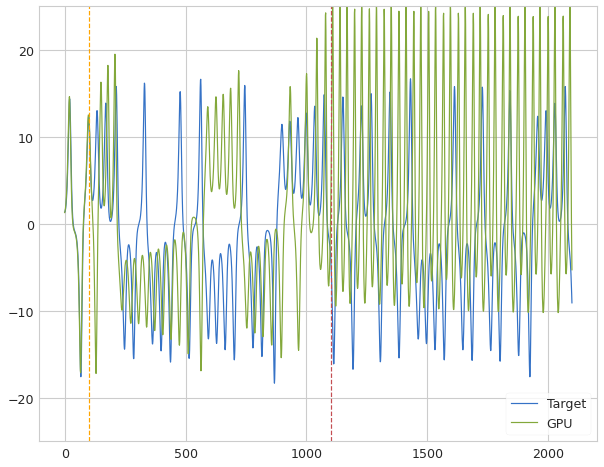

 Iter=11 a=0.502 sr=1.385 amp=1.000  ri=0.068 rr=2.988 loss=1.152962 nrmse=0.282299 CD 0.870663
Iter: 11 #### Time 4.19  NRMSE 0.282 CD 0.871
Dist 0.833845


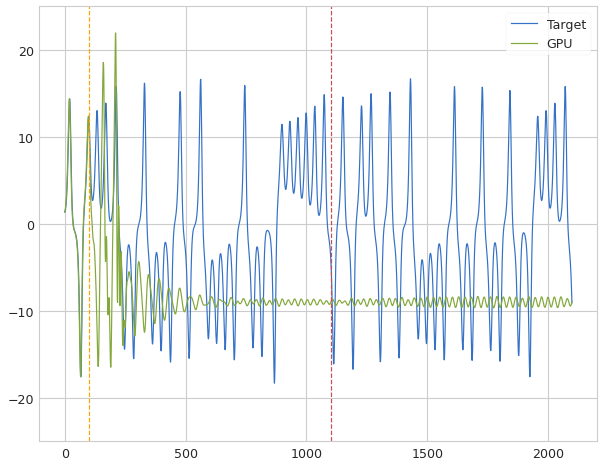

 Iter=12 a=0.688 sr=1.365 amp=1.000  ri=0.006 rr=2.744 loss=1.123759 nrmse=0.289914 CD 0.833845
Iter: 12 #### Time 4.43  NRMSE 0.290 CD 0.834
Dist 0.785051


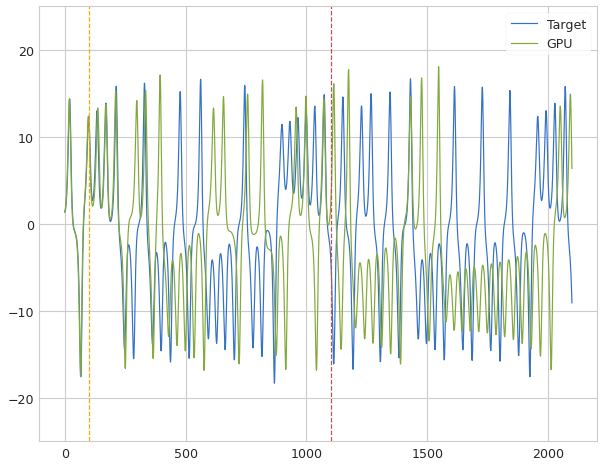

 Iter=13 a=0.605 sr=1.395 amp=1.000  ri=0.067 rr=2.994 loss=1.041128 nrmse=0.256077 CD 0.785051
Iter: 13 #### Time 5.42  NRMSE 0.256 CD 0.785
Iter: 14 #### Time 5.31  NRMSE 6.771 CD 1.001
Iter: 15 #### Time 5.26  NRMSE 0.300 CD 0.998
Iter: 16 #### Time 5.26  NRMSE 0.321 CD 1.076
Iter: 17 #### Time 5.27  NRMSE 1000.000 CD nan
Iter: 18 #### Time 5.30  NRMSE 0.814 CD 0.983
Iter: 19 #### Time 5.25  NRMSE 1000.000 CD nan
Iter: 20 #### Time 5.26  NRMSE 0.544 CD 0.839
Iter: 21 #### Time 5.27  NRMSE 3.543 CD 1.167
Iter: 22 #### Time 5.26  NRMSE 2.757 CD 0.984
Iter: 23 #### Time 5.30  NRMSE 0.346 CD 1.103
Iter: 24 #### Time 5.26  NRMSE 1000.000 CD nan
Dist 0.770697


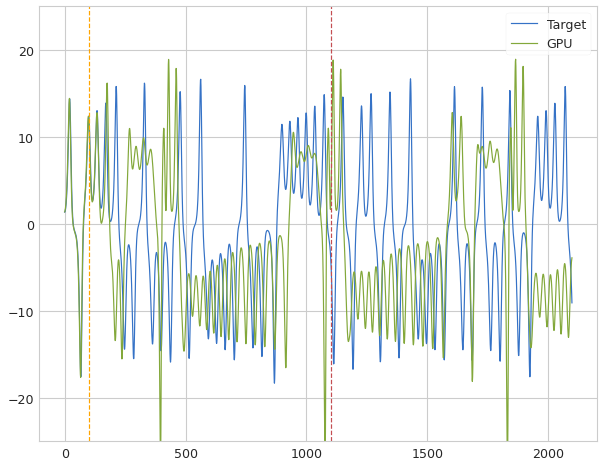

 Iter=25 a=0.602 sr=1.345 amp=1.000  ri=0.091 rr=2.877 loss=1.039616 nrmse=0.268920 CD 0.770697
Iter: 25 #### Time 5.39  NRMSE 0.269 CD 0.771
Dist 0.766998


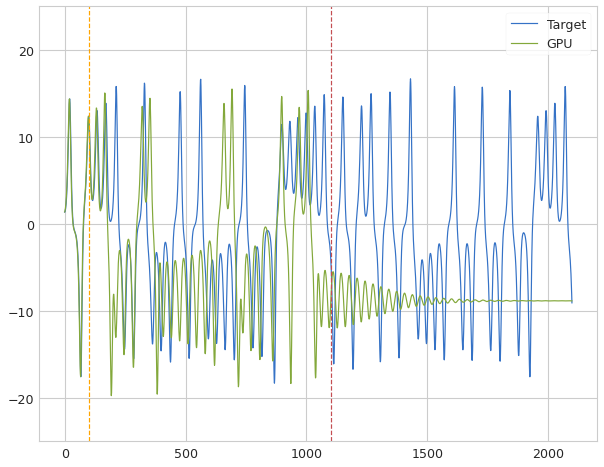

 Iter=26 a=0.823 sr=1.233 amp=1.000  ri=0.036 rr=2.165 loss=1.038155 nrmse=0.271157 CD 0.766998
Iter: 26 #### Time 5.38  NRMSE 0.271 CD 0.767
Iter: 27 #### Time 5.25  NRMSE 1.104 CD 0.998
Iter: 28 #### Time 5.24  NRMSE 0.333 CD 1.263
Iter: 29 #### Time 5.25  NRMSE 0.322 CD 1.063
Iter: 30 #### Time 5.25  NRMSE 1000.000 CD nan
Iter: 31 #### Time 5.25  NRMSE 0.304 CD 1.053
Iter: 32 #### Time 5.29  NRMSE 1.111 CD 1.096
Iter: 33 #### Time 3.84  NRMSE 1.311 CD 0.948
Iter: 34 #### Time 3.77  NRMSE 1.306 CD 0.995
Iter: 35 #### Time 3.78  NRMSE 5.440 CD 0.891
Iter: 36 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 37 #### Time 3.77  NRMSE 0.318 CD 1.054
Iter: 38 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 39 #### Time 3.77  NRMSE 0.274 CD 0.870
Iter: 40 #### Time 3.77  NRMSE 0.280 CD 0.822
Iter: 41 #### Time 3.77  NRMSE 0.261 CD 0.804
Iter: 42 #### Time 3.78  NRMSE 0.287 CD 0.956
Iter: 43 #### Time 3.79  NRMSE 1000.000 CD nan
Iter: 44 #### Time 3.80  NRMSE 1000.000 CD nan
Iter: 45 #### Time 3.80  

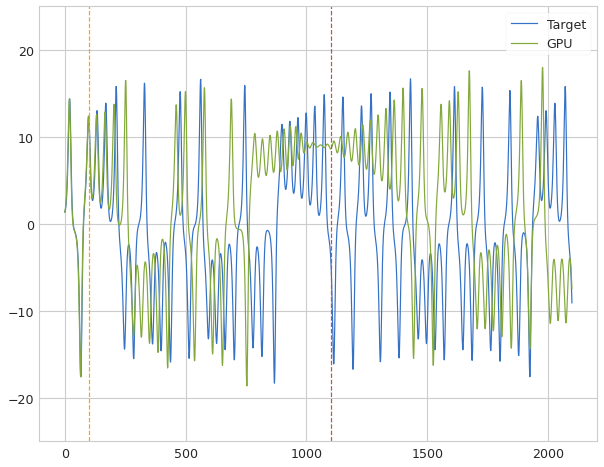

 Iter=120 a=0.700 sr=1.244 amp=1.000  ri=0.095 rr=2.775 loss=0.994639 nrmse=0.255938 CD 0.738701
Iter: 120 #### Time 4.16  NRMSE 0.256 CD 0.739
Iter: 121 #### Time 4.01  NRMSE 0.289 CD 0.960
Iter: 122 #### Time 3.96  NRMSE 0.279 CD 0.887
Iter: 123 #### Time 3.98  NRMSE 1000.000 CD nan
Iter: 124 #### Time 3.93  NRMSE 0.316 CD 0.817
Dist 0.660530


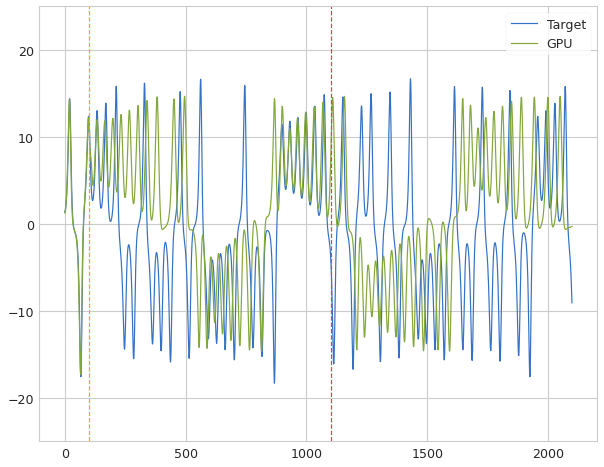

 Iter=125 a=0.614 sr=1.332 amp=1.000  ri=0.076 rr=2.509 loss=0.896744 nrmse=0.236214 CD 0.660530
Iter: 125 #### Time 4.06  NRMSE 0.236 CD 0.661
Iter: 126 #### Time 3.95  NRMSE 0.324 CD 1.058
Iter: 127 #### Time 4.00  NRMSE 0.316 CD 1.051
Iter: 128 #### Time 3.99  NRMSE 1.307 CD 0.997
Iter: 129 #### Time 3.99  NRMSE 0.327 CD 1.157
Iter: 130 #### Time 3.97  NRMSE 0.426 CD 0.890
Iter: 131 #### Time 3.97  NRMSE 2.136 CD 1.007
Iter: 132 #### Time 4.00  NRMSE 0.307 CD 1.133
Iter: 133 #### Time 3.97  NRMSE 0.278 CD 0.916
Iter: 134 #### Time 3.97  NRMSE 0.412 CD 0.954
Iter: 135 #### Time 4.08  NRMSE 3.459 CD 0.954
Iter: 136 #### Time 3.85  NRMSE 0.424 CD 0.834
Iter: 137 #### Time 4.06  NRMSE 0.428 CD 1.048
Iter: 138 #### Time 4.10  NRMSE 0.320 CD 1.061
Iter: 139 #### Time 5.30  NRMSE 0.286 CD 0.918
Iter: 140 #### Time 3.85  NRMSE 1000.000 CD nan
Iter: 141 #### Time 3.91  NRMSE 2.276 CD 0.995
Iter: 142 #### Time 4.05  NRMSE 0.266 CD 0.828
Iter: 143 #### Time 3.94  NRMSE 0.479 CD 1.000
Iter: 144

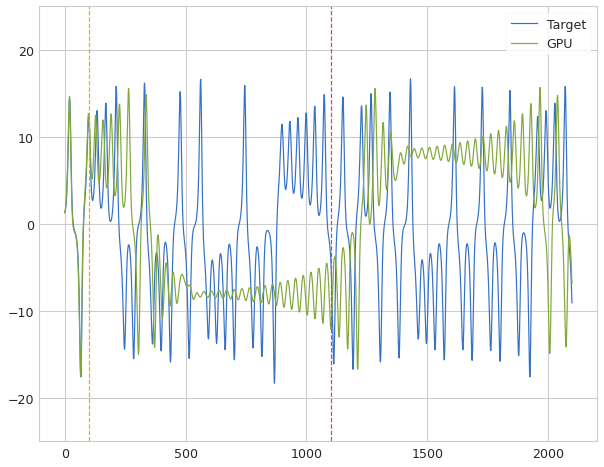

 Iter=0 a=0.556 sr=1.305 amp=1.000  ri=0.076 rr=2.310 loss=1.080623 nrmse=0.267315 CD 0.813309
Iter: 0 #### Time 4.09  NRMSE 0.267 CD 0.813
Iter: 1 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 2 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 3 #### Time 4.01  NRMSE 0.309 CD 1.047
Iter: 4 #### Time 3.95  NRMSE 0.340 CD 1.007
Iter: 5 #### Time 3.94  NRMSE 1.213 CD 1.052
Iter: 6 #### Time 3.95  NRMSE 0.477 CD 0.968
Iter: 7 #### Time 3.94  NRMSE 0.321 CD 1.056
Iter: 8 #### Time 3.95  NRMSE 0.314 CD 1.062
Iter: 9 #### Time 3.96  NRMSE 35.790 CD 0.898
Iter: 10 #### Time 3.94  NRMSE 0.325 CD 1.070
Iter: 11 #### Time 3.95  NRMSE 0.637 CD 0.992
Iter: 12 #### Time 3.96  NRMSE 0.290 CD 0.947
Iter: 13 #### Time 3.96  NRMSE 0.285 CD 0.927
Iter: 14 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 15 #### Time 3.95  NRMSE 0.302 CD 1.048
Iter: 16 #### Time 3.95  NRMSE 0.317 CD 1.066
Iter: 17 #### Time 3.94  NRMSE 4.945 CD 1.106
Iter: 18 #### Time 3.94  NRMSE 0.329 CD 1.261
Iter: 19 #### Time 3.94  NRMSE 0.323 

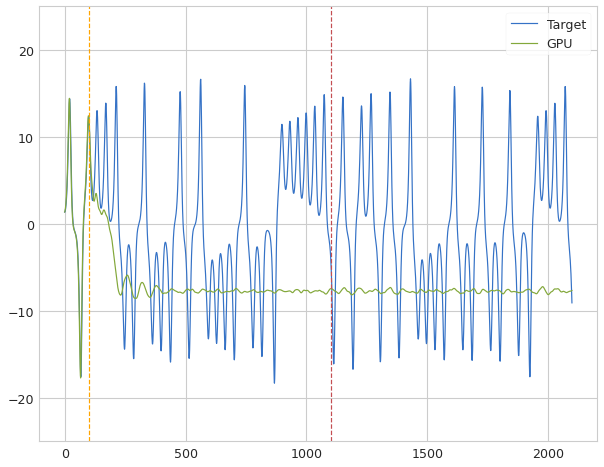

 Iter=65 a=0.584 sr=1.338 amp=1.000  ri=0.002 rr=2.425 loss=1.079507 nrmse=0.257624 CD 0.821883
Iter: 65 #### Time 4.18  NRMSE 0.258 CD 0.822
Iter: 66 #### Time 3.94  NRMSE 0.287 CD 0.911
Iter: 67 #### Time 3.95  NRMSE 1.027 CD 1.001
Iter: 68 #### Time 3.94  NRMSE 0.526 CD 0.948
Iter: 69 #### Time 3.95  NRMSE 0.349 CD 1.182
Iter: 70 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 71 #### Time 3.96  NRMSE 0.273 CD 0.905
Iter: 72 #### Time 3.94  NRMSE 0.315 CD 1.046
Iter: 73 #### Time 3.97  NRMSE 1000.000 CD nan
Iter: 74 #### Time 3.94  NRMSE 0.334 CD 1.070
Iter: 75 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 76 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 77 #### Time 3.94  NRMSE 0.705 CD 1.032
Iter: 78 #### Time 3.94  NRMSE 1.004 CD 1.072
Iter: 79 #### Time 3.95  NRMSE 0.323 CD 0.911
Iter: 80 #### Time 3.94  NRMSE 0.305 CD 0.901
Iter: 81 #### Time 3.96  NRMSE 0.883 CD 0.989
Iter: 82 #### Time 3.94  NRMSE 2.857 CD 0.995
Iter: 83 #### Time 3.94  NRMSE 0.296 CD 1.032
Iter: 84 #### Time 3.95  N

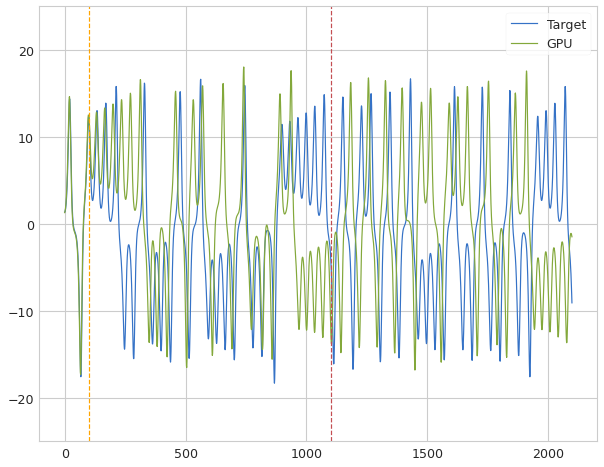

 Iter=111 a=0.721 sr=1.400 amp=1.000  ri=0.069 rr=2.439 loss=1.062630 nrmse=0.263557 CD 0.799074
Iter: 111 #### Time 4.04  NRMSE 0.264 CD 0.799
Iter: 112 #### Time 3.80  NRMSE 0.417 CD 0.933
Iter: 113 #### Time 3.78  NRMSE 1.410 CD 1.085
Iter: 114 #### Time 3.79  NRMSE 1000.000 CD nan
Iter: 115 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 116 #### Time 3.78  NRMSE 0.275 CD 0.895
Iter: 117 #### Time 3.78  NRMSE 0.294 CD 1.050
Iter: 118 #### Time 3.77  NRMSE 0.461 CD 0.997
Iter: 119 #### Time 3.78  NRMSE 0.323 CD 1.057
Iter: 120 #### Time 3.76  NRMSE 0.287 CD 0.847
Iter: 121 #### Time 3.78  NRMSE 0.344 CD 1.051
Iter: 122 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 123 #### Time 3.79  NRMSE 0.321 CD 1.079
Iter: 124 #### Time 3.79  NRMSE 0.281 CD 0.929
Iter: 125 #### Time 3.77  NRMSE 0.410 CD 0.846
Iter: 126 #### Time 3.76  NRMSE 4.157 CD 1.127
Iter: 127 #### Time 3.80  NRMSE 5.397 CD 0.906
Iter: 128 #### Time 3.80  NRMSE 1.052 CD 1.133
Iter: 129 #### Time 3.80  NRMSE 0.312 CD 1.182
Iter: 1

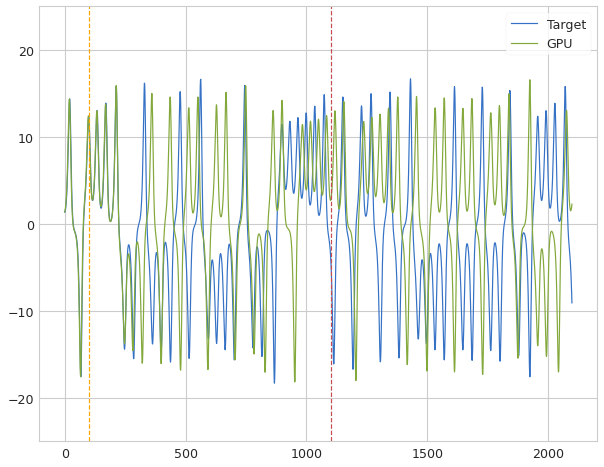

 Iter=133 a=0.599 sr=1.374 amp=1.000  ri=0.073 rr=2.074 loss=1.021820 nrmse=0.255757 CD 0.766063
Iter: 133 #### Time 3.94  NRMSE 0.256 CD 0.766
Iter: 134 #### Time 3.81  NRMSE 1000.000 CD nan
Iter: 135 #### Time 3.85  NRMSE 2.602 CD 1.002
Iter: 136 #### Time 3.80  NRMSE 0.292 CD 0.990
Iter: 137 #### Time 3.85  NRMSE 0.632 CD 1.134
Iter: 138 #### Time 3.82  NRMSE 0.322 CD 1.060
Iter: 139 #### Time 3.81  NRMSE 0.353 CD 0.964
Iter: 140 #### Time 3.84  NRMSE 1000.000 CD nan
Dist 0.744595


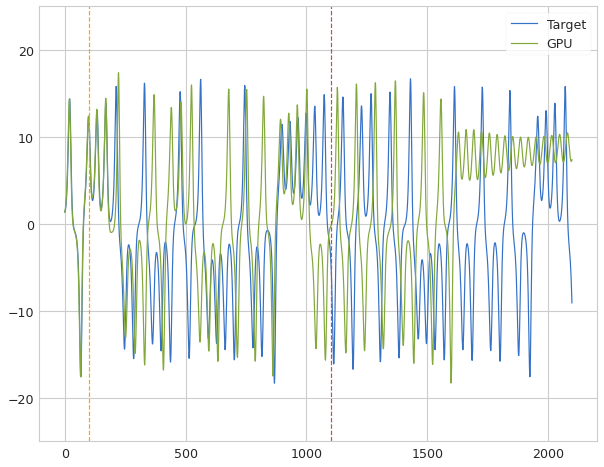

 Iter=141 a=0.833 sr=1.326 amp=1.000  ri=0.066 rr=2.371 loss=0.997961 nrmse=0.253366 CD 0.744595
Iter: 141 #### Time 3.95  NRMSE 0.253 CD 0.745
Iter: 142 #### Time 3.83  NRMSE 0.324 CD 1.060
Iter: 143 #### Time 3.83  NRMSE 0.267 CD 0.813
Iter: 144 #### Time 3.82  NRMSE 0.819 CD 0.954
Iter: 145 #### Time 5.31  NRMSE 0.313 CD 0.766
Iter: 146 #### Time 5.29  NRMSE 0.295 CD 1.025
Iter: 147 #### Time 5.30  NRMSE 0.693 CD 0.868
Iter: 148 #### Time 3.81  NRMSE 0.306 CD 1.019
Iter: 149 #### Time 3.84  NRMSE 0.284 CD 0.919
End Run 1 Time 712.797

Best result = 0.9979612763565
a = 0.8333890982908732
sr = 1.3263704970331596
amp = 0.06618058888185431
ri = 2.3712056230010337
********** Size 50 -- Run 2 ***********
Iter: 0 #### Time 3.86  NRMSE 1000.000 CD nan
Iter: 1 #### Time 3.83  NRMSE 1000.000 CD nan
Iter: 2 #### Time 3.79  NRMSE 42.822 CD 1.069
Iter: 3 #### Time 4.00  NRMSE 1000.000 CD nan
Iter: 4 #### Time 3.98  NRMSE 1000.000 CD nan
Iter: 5 #### Time 4.01  NRMSE 0.802 CD 1.004
Iter: 6 #### T

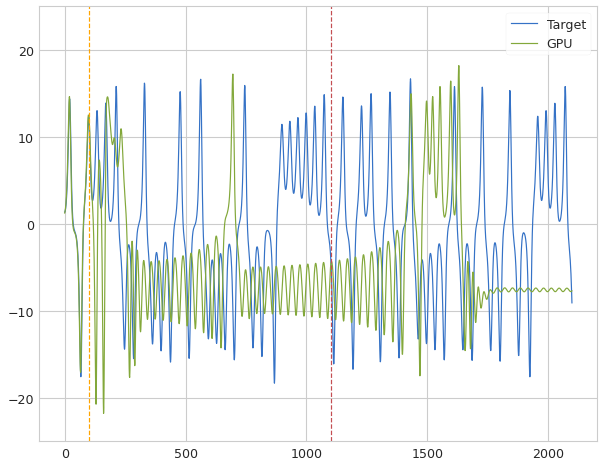

 Iter=10 a=0.725 sr=1.350 amp=1.000  ri=0.061 rr=2.203 loss=1.253764 nrmse=0.292894 CD 0.960870
Iter: 10 #### Time 4.10  NRMSE 0.293 CD 0.961
Iter: 11 #### Time 3.95  NRMSE 1.337 CD 0.993
Iter: 12 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 13 #### Time 3.93  NRMSE 2.124 CD 0.997
Iter: 14 #### Time 3.89  NRMSE 0.348 CD 0.991
Iter: 15 #### Time 3.81  NRMSE 2.102 CD 1.011
Iter: 16 #### Time 3.81  NRMSE 1000.000 CD nan
Iter: 17 #### Time 3.77  NRMSE 1.532 CD 1.004
Iter: 18 #### Time 3.82  NRMSE 1000.000 CD nan
Iter: 19 #### Time 3.78  NRMSE 0.316 CD 0.897
Iter: 20 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 21 #### Time 3.79  NRMSE 0.320 CD 1.062
Dist 0.943916


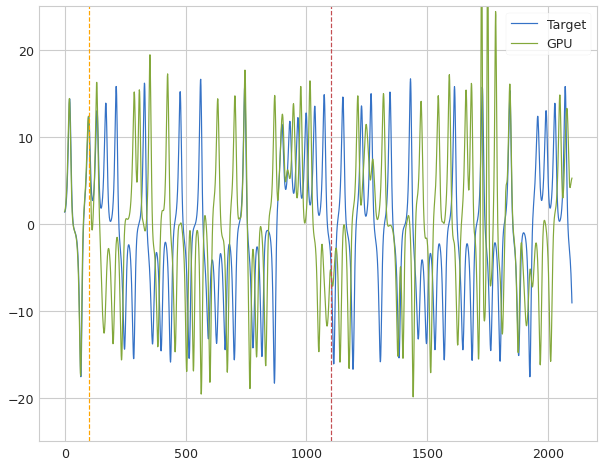

 Iter=22 a=0.828 sr=1.314 amp=1.000  ri=0.088 rr=2.801 loss=1.239252 nrmse=0.295336 CD 0.943916
Iter: 22 #### Time 3.99  NRMSE 0.295 CD 0.944
Iter: 23 #### Time 3.97  NRMSE 0.945 CD 0.991
Iter: 24 #### Time 3.97  NRMSE 0.370 CD 0.963
Dist 0.757356


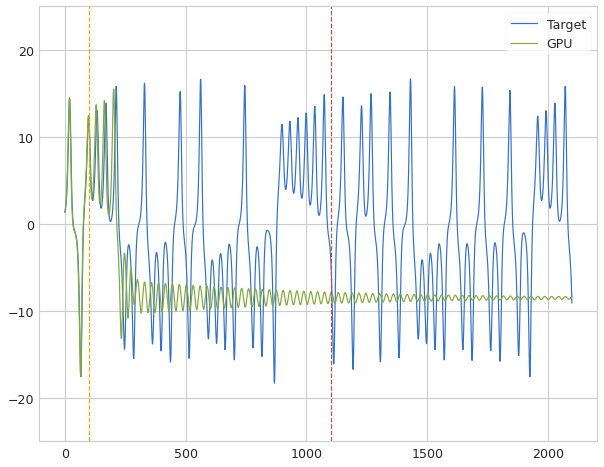

 Iter=25 a=0.593 sr=1.241 amp=1.000  ri=0.096 rr=2.766 loss=1.021525 nrmse=0.264168 CD 0.757356
Iter: 25 #### Time 4.09  NRMSE 0.264 CD 0.757
Iter: 26 #### Time 3.98  NRMSE 0.949 CD 1.021
Iter: 27 #### Time 3.95  NRMSE 0.326 CD 1.200
Iter: 28 #### Time 3.93  NRMSE 0.313 CD 1.061
Iter: 29 #### Time 3.94  NRMSE 0.304 CD 1.030
Iter: 30 #### Time 3.95  NRMSE 0.318 CD 1.088
Iter: 31 #### Time 4.00  NRMSE 1.737 CD 1.005
Iter: 32 #### Time 3.94  NRMSE 0.354 CD 1.139
Iter: 33 #### Time 3.92  NRMSE 0.309 CD 1.060
Iter: 34 #### Time 3.97  NRMSE 1000.000 CD nan
Iter: 35 #### Time 3.94  NRMSE 4.948 CD 1.116
Iter: 36 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 37 #### Time 3.93  NRMSE 0.324 CD 1.068
Iter: 38 #### Time 3.94  NRMSE 0.418 CD 1.016
Iter: 39 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 40 #### Time 3.92  NRMSE 3.712 CD 0.905
Iter: 41 #### Time 3.93  NRMSE 0.319 CD 1.050
Iter: 42 #### Time 3.94  NRMSE 2.761 CD 0.995
Iter: 43 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 44 #### Time 3.93  N

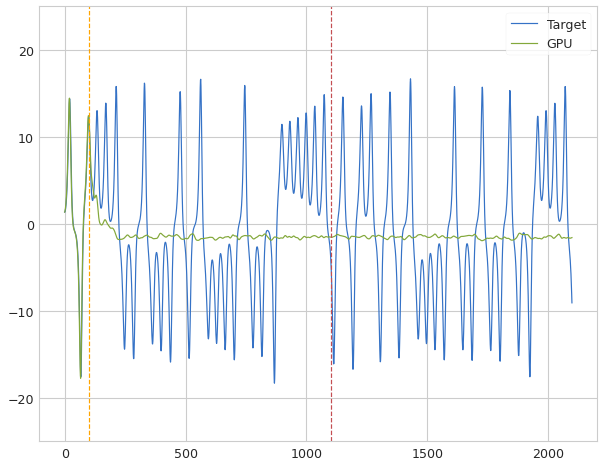

 Iter=88 a=0.534 sr=1.269 amp=1.000  ri=0.002 rr=2.051 loss=0.985546 nrmse=0.202973 CD 0.782573
Iter: 88 #### Time 4.04  NRMSE 0.203 CD 0.783
Iter: 89 #### Time 3.94  NRMSE 1.336 CD 1.007
Iter: 90 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 91 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 92 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 93 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 94 #### Time 3.92  NRMSE 0.300 CD 1.040
Iter: 95 #### Time 3.93  NRMSE 0.325 CD 1.053
Iter: 96 #### Time 3.92  NRMSE 0.886 CD 1.007
Iter: 97 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 98 #### Time 3.93  NRMSE 0.534 CD 0.966
Iter: 99 #### Time 3.92  NRMSE 0.301 CD 1.056
Iter: 100 #### Time 3.93  NRMSE 0.381 CD 0.906
Iter: 101 #### Time 3.92  NRMSE 0.314 CD 1.117
Iter: 102 #### Time 3.93  NRMSE 0.769 CD 0.935
Iter: 103 #### Time 3.93  NRMSE 0.342 CD 1.060
Iter: 104 #### Time 3.91  NRMSE 0.467 CD 0.922
Iter: 105 #### Time 3.93  NRMSE 0.314 CD 1.055
Iter: 106 #### Time 3.92  NRMSE 0.320 CD 1.077
Iter: 107 #### Tim

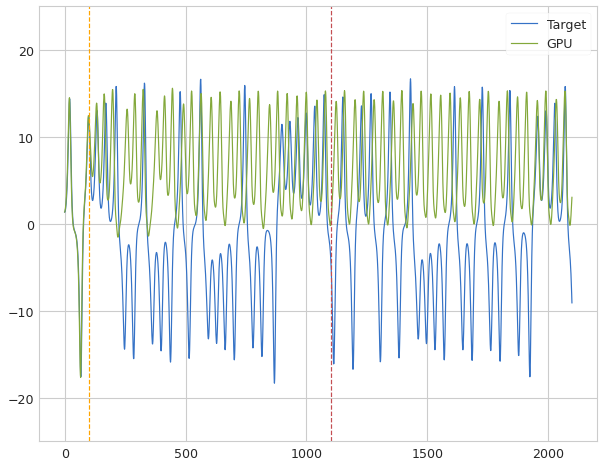

 Iter=2 a=0.610 sr=1.312 amp=1.000  ri=0.003 rr=2.665 loss=1.280182 nrmse=0.299346 CD 0.980836
Iter: 2 #### Time 3.98  NRMSE 0.299 CD 0.981
Iter: 3 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 4 #### Time 3.88  NRMSE 0.307 CD 0.844
Iter: 5 #### Time 3.77  NRMSE 0.352 CD 0.985
Dist 0.853502


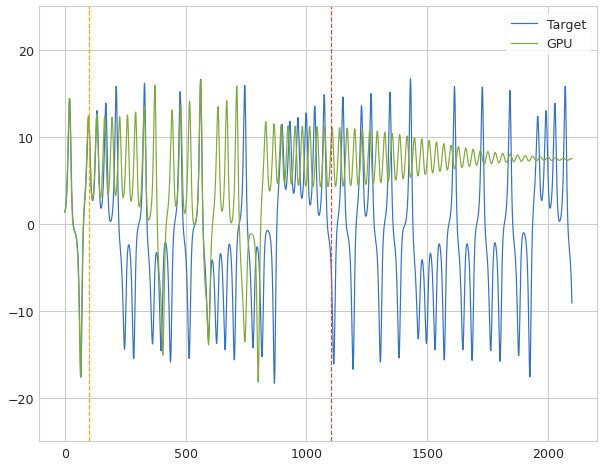

 Iter=6 a=0.638 sr=1.389 amp=1.000  ri=0.092 rr=2.953 loss=1.122385 nrmse=0.268883 CD 0.853502
Iter: 6 #### Time 4.06  NRMSE 0.269 CD 0.854
Iter: 7 #### Time 3.99  NRMSE 1000.000 CD nan
Iter: 8 #### Time 3.94  NRMSE 1.702 CD 0.996
Iter: 9 #### Time 3.96  NRMSE 0.830 CD 0.799
Iter: 10 #### Time 3.93  NRMSE 0.303 CD 0.902
Iter: 11 #### Time 3.93  NRMSE 0.298 CD 0.996
Iter: 12 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 13 #### Time 3.92  NRMSE 0.323 CD 1.059
Iter: 14 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 15 #### Time 3.92  NRMSE 0.323 CD 1.060
Iter: 16 #### Time 3.92  NRMSE 0.369 CD 1.155
Iter: 17 #### Time 3.92  NRMSE 1.746 CD 1.003
Iter: 18 #### Time 3.92  NRMSE 0.291 CD 0.931
Iter: 19 #### Time 3.92  NRMSE 0.281 CD 0.930
Iter: 20 #### Time 3.90  NRMSE 0.290 CD 1.006
Iter: 21 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 22 #### Time 3.91  NRMSE 0.317 CD 1.063
Iter: 23 #### Time 3.92  NRMSE 0.276 CD 0.893
Iter: 24 #### Time 3.91  NRMSE 0.343 CD 1.005
Iter: 25 #### Time 3.96  NRMSE 

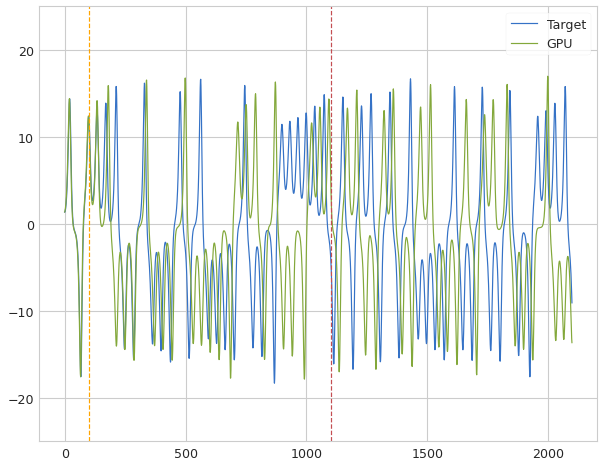

 Iter=35 a=0.573 sr=1.347 amp=1.000  ri=0.077 rr=2.695 loss=1.065815 nrmse=0.264356 CD 0.801459
Iter: 35 #### Time 4.06  NRMSE 0.264 CD 0.801
Iter: 36 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 37 #### Time 3.92  NRMSE 1.857 CD 1.165
Iter: 38 #### Time 3.91  NRMSE 0.310 CD 1.009
Iter: 39 #### Time 3.91  NRMSE 0.358 CD 1.021
Iter: 40 #### Time 3.92  NRMSE 0.318 CD 1.063
Iter: 41 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 42 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 43 #### Time 3.92  NRMSE 0.287 CD 0.933
Iter: 44 #### Time 3.93  NRMSE 0.511 CD 0.646
Iter: 45 #### Time 3.91  NRMSE 0.306 CD 1.060
Iter: 46 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 47 #### Time 3.97  NRMSE 0.317 CD 1.057
Iter: 48 #### Time 3.96  NRMSE 0.286 CD 0.989
Iter: 49 #### Time 3.92  NRMSE 10.248 CD 1.137
Iter: 50 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 51 #### Time 3.91  NRMSE 1000.000 CD nan
Dist 0.732221


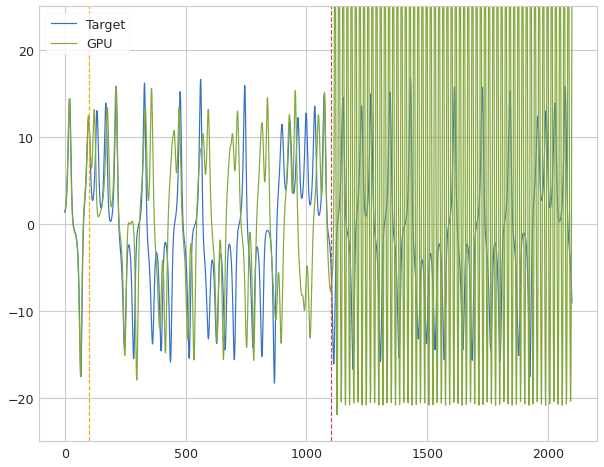

 Iter=52 a=0.860 sr=1.261 amp=1.000  ri=0.081 rr=2.385 loss=0.987875 nrmse=0.255654 CD 0.732221
Iter: 52 #### Time 4.09  NRMSE 0.256 CD 0.732
Iter: 53 #### Time 3.91  NRMSE 0.638 CD 0.956
Iter: 54 #### Time 3.91  NRMSE 0.337 CD 0.812
Iter: 55 #### Time 3.93  NRMSE 0.527 CD 0.978
Iter: 56 #### Time 3.92  NRMSE 0.311 CD 1.064
Iter: 57 #### Time 3.92  NRMSE 0.638 CD 1.088
Iter: 58 #### Time 3.95  NRMSE 266.760 CD 0.989
Iter: 59 #### Time 3.74  NRMSE 1000.000 CD nan
Iter: 60 #### Time 3.78  NRMSE 1000.000 CD nan
Iter: 61 #### Time 3.77  NRMSE 5.074 CD 1.003
Iter: 62 #### Time 3.82  NRMSE 5.828 CD 1.006
Iter: 63 #### Time 3.74  NRMSE 0.311 CD 1.057
Iter: 64 #### Time 3.73  NRMSE 1611569706460.057 CD 1.000
Iter: 65 #### Time 3.81  NRMSE 7.627 CD 1.001
Iter: 66 #### Time 3.79  NRMSE 1000.000 CD nan
Iter: 67 #### Time 3.73  NRMSE 0.335 CD 1.157
Iter: 68 #### Time 3.73  NRMSE 2.946 CD 0.999
Iter: 69 #### Time 3.74  NRMSE 0.314 CD 1.070
Iter: 70 #### Time 3.74  NRMSE 1000.000 CD nan
Iter: 71 ###

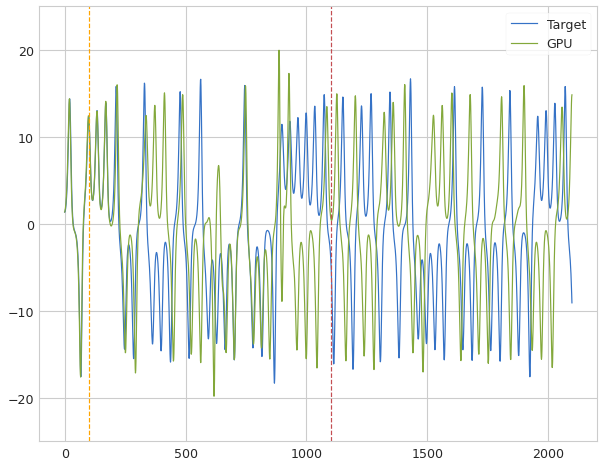

 Iter=148 a=0.865 sr=1.289 amp=1.000  ri=0.084 rr=2.987 loss=0.887886 nrmse=0.238316 CD 0.649569
Iter: 148 #### Time 4.15  NRMSE 0.238 CD 0.650
Iter: 149 #### Time 3.97  NRMSE 1000.000 CD nan
End Run 1 Time 750.716

Best result = 0.8878855886716275
a = 0.8647996372520936
sr = 1.2893430493912903
amp = 0.08395279269758649
ri = 2.98686765390469
********** Size 50 -- Run 4 ***********
Iter: 0 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 1 #### Time 3.94  NRMSE 5.202 CD 0.857
Dist 1.046504


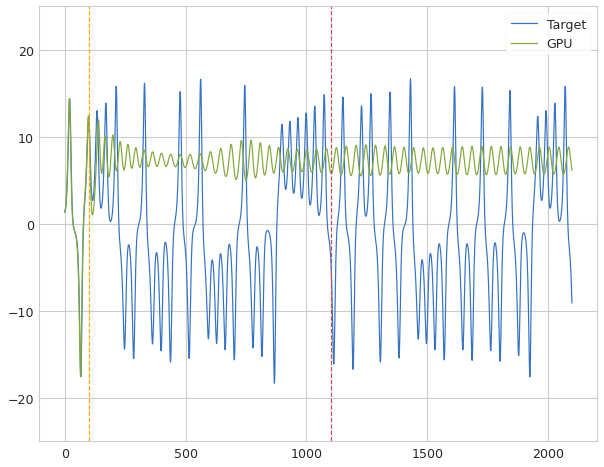

 Iter=2 a=0.615 sr=1.279 amp=1.000  ri=0.020 rr=2.460 loss=1.336687 nrmse=0.290183 CD 1.046504
Iter: 2 #### Time 4.07  NRMSE 0.290 CD 1.047
Dist 1.011717


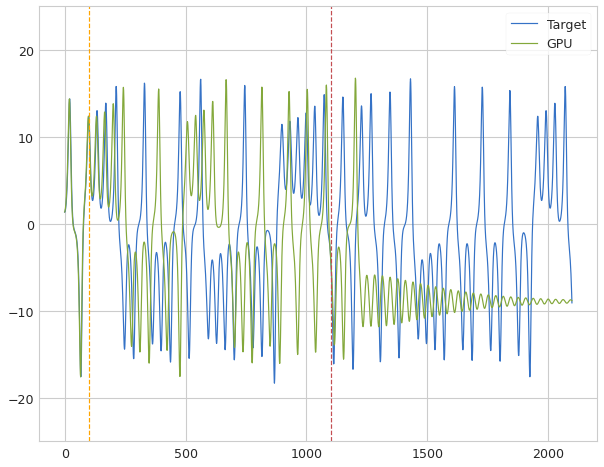

 Iter=3 a=0.540 sr=1.268 amp=1.000  ri=0.047 rr=2.527 loss=1.306756 nrmse=0.295039 CD 1.011717
Iter: 3 #### Time 4.08  NRMSE 0.295 CD 1.012
Iter: 4 #### Time 3.93  NRMSE 0.304 CD 1.060
Iter: 5 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 6 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 7 #### Time 3.93  NRMSE 0.319 CD 1.080
Iter: 8 #### Time 3.95  NRMSE 2.863 CD 0.922
Iter: 9 #### Time 3.93  NRMSE 0.311 CD 1.047
Iter: 10 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 11 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 12 #### Time 3.94  NRMSE 1.620 CD 1.018
Iter: 13 #### Time 3.95  NRMSE 1.525 CD 0.999
Iter: 14 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 15 #### Time 3.92  NRMSE 0.309 CD 1.069
Iter: 16 #### Time 3.94  NRMSE 0.541 CD 1.009
Iter: 17 #### Time 3.94  NRMSE 0.498 CD 0.981
Iter: 18 #### Time 3.93  NRMSE 0.494 CD 0.976
Iter: 19 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 20 #### Time 3.93  NRMSE 0.430 CD 1.040
Dist 0.892725


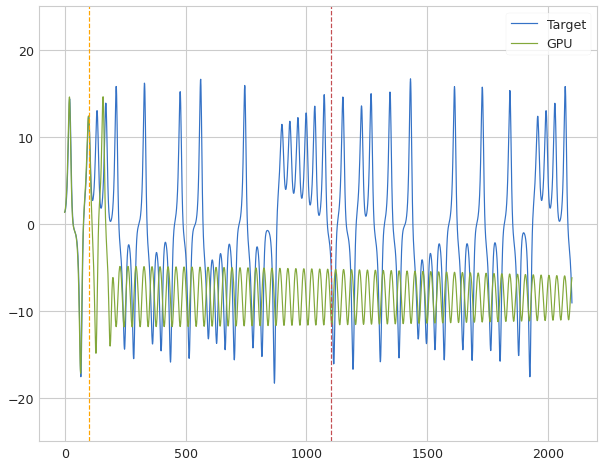

 Iter=21 a=0.578 sr=1.387 amp=1.000  ri=0.096 rr=2.349 loss=1.180621 nrmse=0.287895 CD 0.892725
Iter: 21 #### Time 4.19  NRMSE 0.288 CD 0.893
Iter: 22 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 23 #### Time 3.93  NRMSE 0.456 CD 0.951
Iter: 24 #### Time 3.92  NRMSE 0.307 CD 1.030
Iter: 25 #### Time 3.93  NRMSE 0.330 CD 1.067
Iter: 26 #### Time 3.93  NRMSE 0.300 CD 1.060
Iter: 27 #### Time 3.93  NRMSE 0.331 CD 1.064
Iter: 28 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 29 #### Time 3.93  NRMSE 0.308 CD 1.053
Iter: 30 #### Time 3.94  NRMSE 1.551 CD 0.996
Iter: 31 #### Time 3.94  NRMSE 0.402 CD 1.149
Iter: 32 #### Time 3.94  NRMSE 0.319 CD 1.040
Iter: 33 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 34 #### Time 3.94  NRMSE 0.312 CD 1.043
Iter: 35 #### Time 3.98  NRMSE 1000.000 CD nan
Iter: 36 #### Time 3.94  NRMSE 1.569 CD 0.999
Iter: 37 #### Time 3.94  NRMSE 0.546 CD 0.970
Iter: 38 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 39 #### Time 3.94  NRMSE 1.013 CD 1.037
Iter: 40 #### Time 3.94  

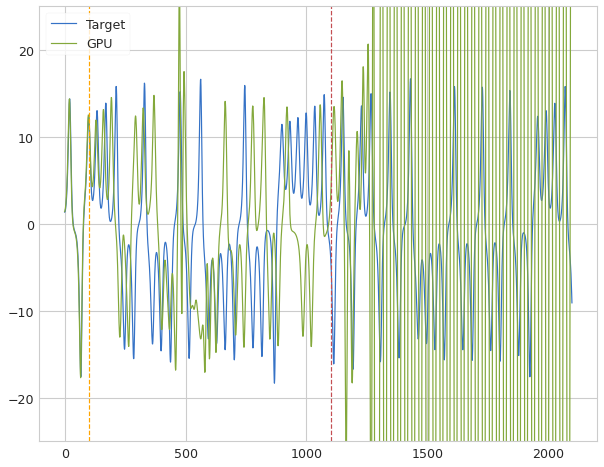

 Iter=51 a=0.739 sr=1.380 amp=1.000  ri=0.069 rr=2.288 loss=1.178349 nrmse=0.285807 CD 0.892542
Iter: 51 #### Time 4.09  NRMSE 0.286 CD 0.893
Iter: 52 #### Time 3.94  NRMSE 0.450 CD 0.947
Iter: 53 #### Time 3.94  NRMSE 0.898 CD 1.027
Iter: 54 #### Time 3.93  NRMSE 0.299 CD 1.048
Dist 0.725066


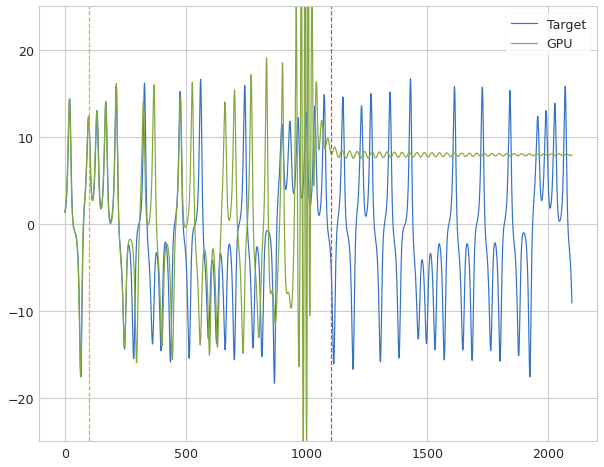

 Iter=55 a=0.600 sr=1.223 amp=1.000  ri=0.024 rr=2.868 loss=1.011576 nrmse=0.286510 CD 0.725066
Iter: 55 #### Time 4.13  NRMSE 0.287 CD 0.725
Iter: 56 #### Time 3.97  NRMSE 1000.000 CD nan
Iter: 57 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 58 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 59 #### Time 3.94  NRMSE 1.248 CD 1.147
Iter: 60 #### Time 3.95  NRMSE 0.314 CD 1.060
Iter: 61 #### Time 3.96  NRMSE 0.248 CD 1.134
Iter: 62 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 63 #### Time 3.99  NRMSE 1000.000 CD nan
Iter: 64 #### Time 3.95  NRMSE 0.315 CD 1.146
Iter: 65 #### Time 3.94  NRMSE 0.393 CD 0.964
Iter: 66 #### Time 3.94  NRMSE 1.126 CD 0.949
Iter: 67 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 68 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 69 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 70 #### Time 3.96  NRMSE 0.393 CD 1.010
Iter: 71 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 72 #### Time 3.94  NRMSE 0.683 CD 0.955
Iter: 73 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 74 #### Time 3

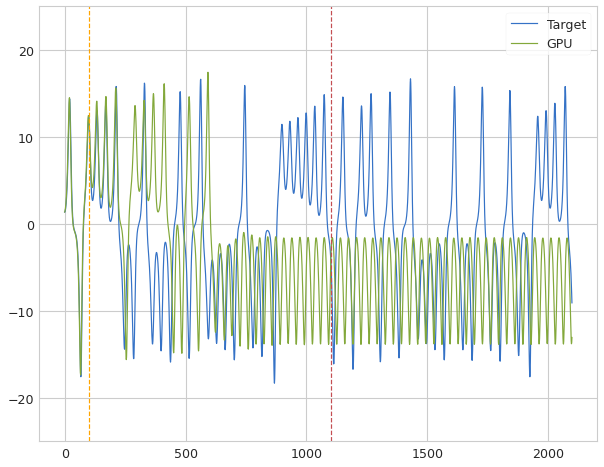

 Iter=17 a=0.591 sr=1.291 amp=1.000  ri=0.029 rr=2.729 loss=1.285381 nrmse=0.294142 CD 0.991239
Iter: 17 #### Time 5.44  NRMSE 0.294 CD 0.991
Iter: 18 #### Time 4.97  NRMSE 0.356 CD 1.067
Iter: 19 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 20 #### Time 3.99  NRMSE 0.325 CD 1.067
Iter: 21 #### Time 3.96  NRMSE 1.023 CD 0.962
Iter: 22 #### Time 5.19  NRMSE 0.378 CD 1.011
Dist 1.003429


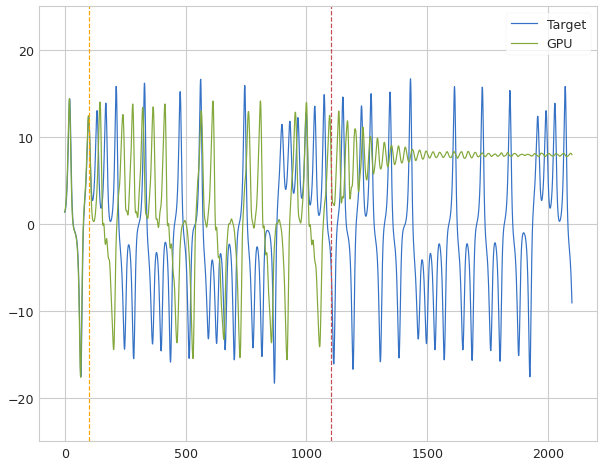

 Iter=23 a=0.579 sr=1.303 amp=1.000  ri=0.005 rr=2.594 loss=1.283666 nrmse=0.280236 CD 1.003429
Iter: 23 #### Time 5.37  NRMSE 0.280 CD 1.003
Iter: 24 #### Time 5.26  NRMSE 0.318 CD 1.067
Iter: 25 #### Time 5.27  NRMSE 0.298 CD 1.110
Iter: 26 #### Time 3.87  NRMSE 0.511 CD 0.962
Iter: 27 #### Time 3.77  NRMSE 0.334 CD 1.069
Dist 0.980137


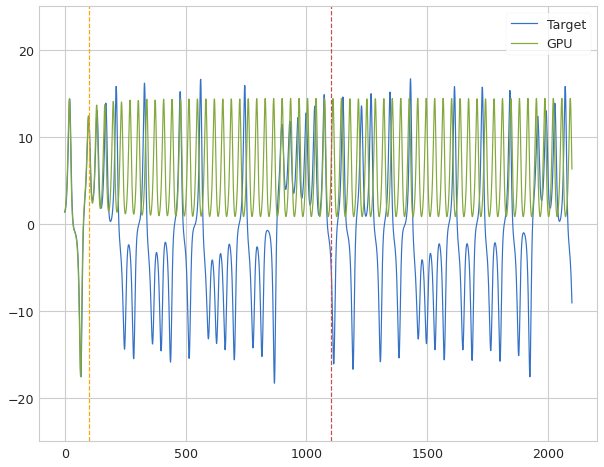

 Iter=28 a=0.622 sr=1.385 amp=1.000  ri=0.076 rr=2.304 loss=1.266877 nrmse=0.286740 CD 0.980137
Iter: 28 #### Time 4.06  NRMSE 0.287 CD 0.980
Iter: 29 #### Time 4.05  NRMSE 0.430 CD 0.995
Iter: 30 #### Time 4.05  NRMSE 0.312 CD 1.031
Iter: 31 #### Time 3.93  NRMSE 0.317 CD 1.128
Iter: 32 #### Time 3.90  NRMSE 0.326 CD 0.906
Iter: 33 #### Time 3.83  NRMSE 1.045 CD 1.007
Iter: 34 #### Time 3.86  NRMSE 0.317 CD 1.059
Iter: 35 #### Time 3.94  NRMSE 0.620 CD 1.024
Iter: 36 #### Time 3.79  NRMSE 1.661 CD 0.985
Iter: 37 #### Time 3.76  NRMSE 0.310 CD 1.057
Iter: 38 #### Time 3.96  NRMSE 1000.000 CD nan
Dist 0.942392


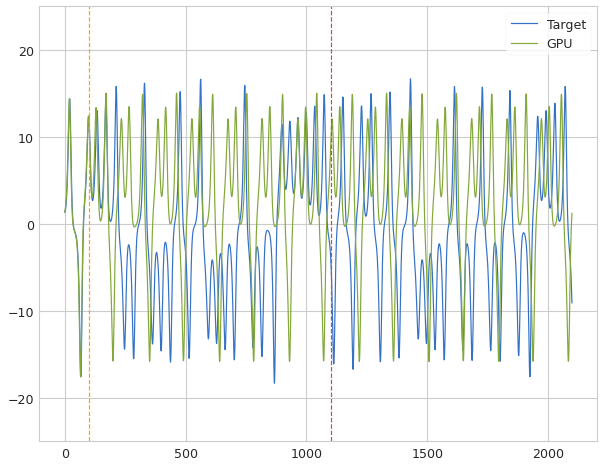

 Iter=39 a=0.607 sr=1.349 amp=1.000  ri=0.069 rr=2.424 loss=1.225079 nrmse=0.282688 CD 0.942392
Iter: 39 #### Time 4.10  NRMSE 0.283 CD 0.942
Iter: 40 #### Time 4.02  NRMSE 0.325 CD 1.061
Dist 0.911681


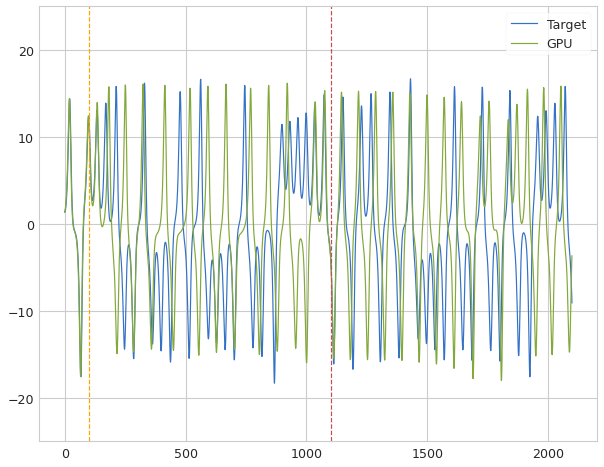

 Iter=41 a=0.587 sr=1.396 amp=1.000  ri=0.061 rr=2.796 loss=1.187241 nrmse=0.275560 CD 0.911681
Iter: 41 #### Time 4.06  NRMSE 0.276 CD 0.912
Iter: 42 #### Time 3.92  NRMSE 5.755 CD 0.899
Iter: 43 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 44 #### Time 3.92  NRMSE 0.288 CD 0.978
Iter: 45 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 46 #### Time 3.91  NRMSE 0.402 CD 0.978
Iter: 47 #### Time 3.93  NRMSE 1.000 CD 0.991
Iter: 48 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 49 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 50 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 51 #### Time 3.94  NRMSE 0.380 CD 1.024
Dist 0.729071


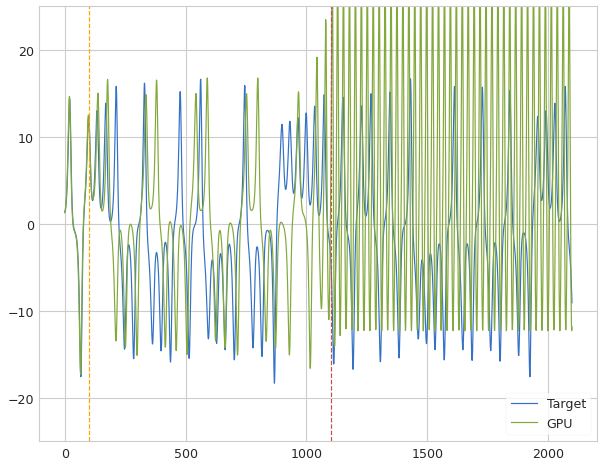

 Iter=52 a=0.668 sr=1.331 amp=1.000  ri=0.082 rr=2.054 loss=0.978292 nrmse=0.249221 CD 0.729071
Iter: 52 #### Time 4.08  NRMSE 0.249 CD 0.729
Iter: 53 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 54 #### Time 3.94  NRMSE 0.886 CD 0.973
Iter: 55 #### Time 3.93  NRMSE 2.427 CD 0.994
Iter: 56 #### Time 3.93  NRMSE 0.524 CD 0.939
Iter: 57 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 58 #### Time 3.93  NRMSE 1.345 CD 0.995
Iter: 59 #### Time 3.92  NRMSE 0.300 CD 1.055
Iter: 60 #### Time 3.91  NRMSE 0.327 CD 1.068
Iter: 61 #### Time 3.92  NRMSE 0.287 CD 0.884
Iter: 62 #### Time 3.92  NRMSE 0.267 CD 0.736
Iter: 63 #### Time 3.91  NRMSE 0.307 CD 0.933
Iter: 64 #### Time 3.93  NRMSE 2.950 CD 1.103
Iter: 65 #### Time 3.92  NRMSE 0.743 CD 1.006
Iter: 66 #### Time 3.92  NRMSE 1.070 CD 1.017
Iter: 67 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 68 #### Time 3.95  NRMSE 0.344 CD 1.086
Iter: 69 #### Time 3.91  NRMSE 5.237 CD 1.126
Iter: 70 #### Time 3.91  NRMSE 0.337 CD 1.067
Iter: 71 #### Time 3.92  NR

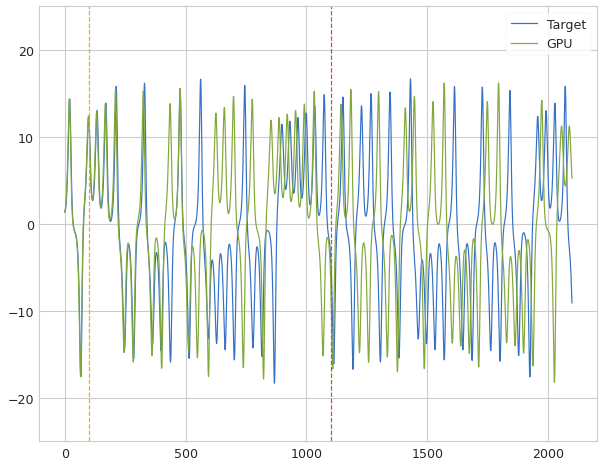

 Iter=0 a=0.556 sr=1.305 amp=1.000  ri=0.076 rr=2.310 loss=0.929500 nrmse=0.242114 CD 0.687386
Iter: 0 #### Time 4.09  NRMSE 0.242 CD 0.687
Iter: 1 #### Time 3.92  NRMSE 0.670 CD 1.076
Iter: 2 #### Time 3.95  NRMSE 0.321 CD 1.047
Iter: 3 #### Time 3.90  NRMSE 0.306 CD 1.026
Iter: 4 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 5 #### Time 3.90  NRMSE 17.684 CD 1.131
Iter: 6 #### Time 3.91  NRMSE 0.874 CD 1.004
Iter: 7 #### Time 3.92  NRMSE 1.750 CD 0.998
Iter: 8 #### Time 3.91  NRMSE 0.644 CD 0.976
Iter: 9 #### Time 3.91  NRMSE 0.388 CD 0.987
Iter: 10 #### Time 3.91  NRMSE 0.323 CD 1.063
Iter: 11 #### Time 3.90  NRMSE 0.491 CD 1.025
Iter: 12 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 13 #### Time 3.90  NRMSE 0.288 CD 0.754
Iter: 14 #### Time 3.90  NRMSE 0.305 CD 0.948
Iter: 15 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 16 #### Time 3.91  NRMSE 0.335 CD 1.065
Iter: 17 #### Time 3.90  NRMSE 1000.000 CD nan
Iter: 18 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 19 #### Time 3.90  NRMSE 1000

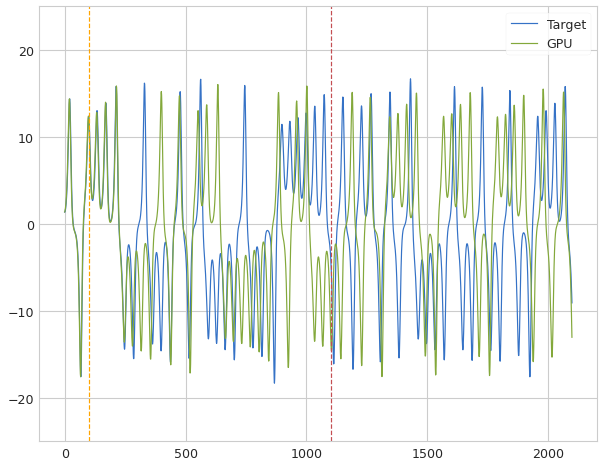

 Iter=91 a=0.673 sr=1.243 amp=1.000  ri=0.089 rr=2.925 loss=0.917888 nrmse=0.242998 CD 0.674890
Iter: 91 #### Time 5.32  NRMSE 0.243 CD 0.675
Iter: 92 #### Time 5.17  NRMSE 0.637 CD 0.974
Iter: 93 #### Time 5.15  NRMSE 0.306 CD 1.048
Iter: 94 #### Time 5.21  NRMSE 0.308 CD 1.046
Iter: 95 #### Time 5.13  NRMSE 1000.000 CD nan
Iter: 96 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 97 #### Time 3.93  NRMSE 0.319 CD 1.077
Iter: 98 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 99 #### Time 3.95  NRMSE 0.892 CD 0.993
Iter: 100 #### Time 3.98  NRMSE 2.337 CD 0.999
Iter: 101 #### Time 3.98  NRMSE 0.260 CD 0.711
Iter: 102 #### Time 3.95  NRMSE 0.341 CD 1.087
Iter: 103 #### Time 3.92  NRMSE 155925879965461345060595433472.000 CD 1.000
Iter: 104 #### Time 3.99  NRMSE 1000.000 CD nan
Iter: 105 #### Time 3.92  NRMSE 0.273 CD 0.861
Iter: 106 #### Time 3.91  NRMSE 0.326 CD 1.074
Iter: 107 #### Time 3.93  NRMSE 0.888 CD 0.950
Iter: 108 #### Time 3.92  NRMSE 0.343 CD 1.071
Iter: 109 #### Time 3.93  NRMSE 0.

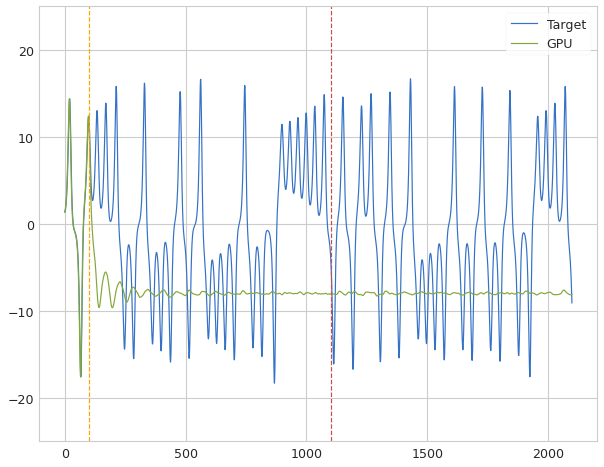

 Iter=9 a=0.815 sr=1.343 amp=1.000  ri=0.003 rr=2.316 loss=1.178919 nrmse=0.278932 CD 0.899987
Iter: 9 #### Time 5.35  NRMSE 0.279 CD 0.900
Iter: 10 #### Time 3.81  NRMSE 0.293 CD 0.996
Iter: 11 #### Time 3.74  NRMSE 0.320 CD 1.062
Iter: 12 #### Time 3.74  NRMSE 0.842 CD 1.012
Iter: 13 #### Time 3.74  NRMSE 0.318 CD 1.063
Iter: 14 #### Time 3.74  NRMSE 0.312 CD 0.939
Iter: 15 #### Time 3.74  NRMSE 3.188 CD 0.995
Iter: 16 #### Time 3.74  NRMSE 0.306 CD 1.051
Iter: 17 #### Time 3.73  NRMSE 0.974 CD 0.993
Iter: 18 #### Time 3.74  NRMSE 1000.000 CD nan
Iter: 19 #### Time 3.75  NRMSE 0.289 CD 0.973
Iter: 20 #### Time 3.77  NRMSE 1000.000 CD nan
Iter: 21 #### Time 3.91  NRMSE 0.300 CD 1.085
Iter: 22 #### Time 3.95  NRMSE 0.305 CD 1.081
Iter: 23 #### Time 3.95  NRMSE 0.346 CD 0.942
Iter: 24 #### Time 3.96  NRMSE 0.283 CD 0.937
Dist 0.746296


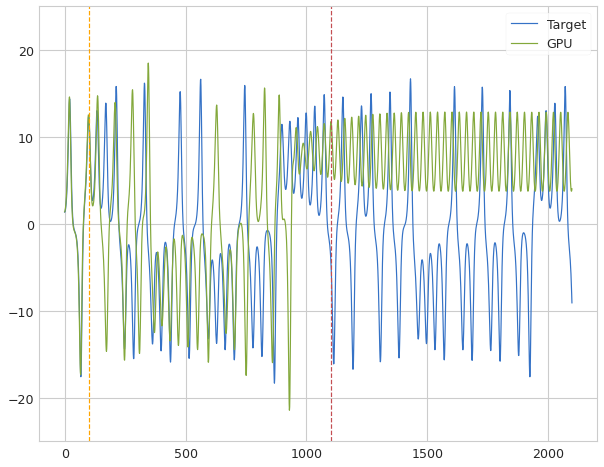

 Iter=25 a=0.593 sr=1.241 amp=1.000  ri=0.096 rr=2.766 loss=1.005035 nrmse=0.258739 CD 0.746296
Iter: 25 #### Time 4.05  NRMSE 0.259 CD 0.746
Iter: 26 #### Time 3.97  NRMSE 0.644 CD 0.896
Iter: 27 #### Time 3.91  NRMSE 0.302 CD 1.062
Iter: 28 #### Time 3.90  NRMSE 0.546 CD 0.932
Iter: 29 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 30 #### Time 3.85  NRMSE 0.835 CD 0.989
Iter: 31 #### Time 3.79  NRMSE 1000.000 CD nan
Iter: 32 #### Time 3.83  NRMSE 0.269 CD 0.838
Iter: 33 #### Time 3.81  NRMSE 1000.000 CD nan
Iter: 34 #### Time 3.74  NRMSE 1000.000 CD nan
Iter: 35 #### Time 3.80  NRMSE 0.323 CD 1.088
Iter: 36 #### Time 5.07  NRMSE 0.298 CD 0.921
Iter: 37 #### Time 5.27  NRMSE 1000.000 CD nan
Iter: 38 #### Time 5.25  NRMSE 0.697 CD 0.960
Iter: 39 #### Time 5.21  NRMSE 1000.000 CD nan
Iter: 40 #### Time 5.21  NRMSE 1.669 CD 0.987
Iter: 41 #### Time 5.24  NRMSE 0.277 CD 0.995
Iter: 42 #### Time 5.22  NRMSE 3.048 CD 1.098
Iter: 43 #### Time 5.23  NRMSE 0.313 CD 1.057
Iter: 44 #### Time 5.21 

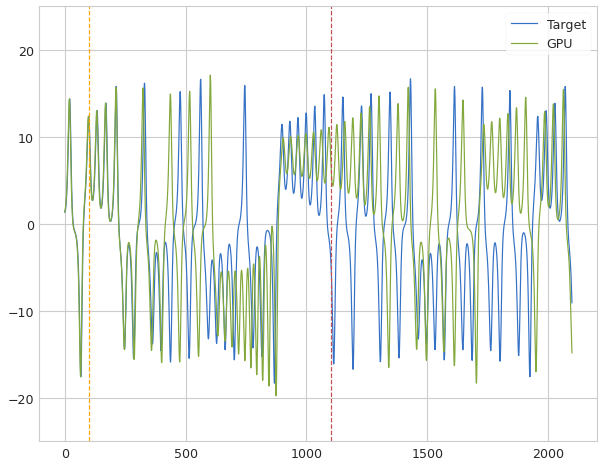

 Iter=49 a=0.860 sr=1.272 amp=1.000  ri=0.089 rr=2.306 loss=0.762478 nrmse=0.224994 CD 0.537484
Iter: 49 #### Time 4.09  NRMSE 0.225 CD 0.537
Iter: 50 #### Time 3.75  NRMSE 0.327 CD 1.061
Iter: 51 #### Time 3.76  NRMSE 1000.000 CD nan
Iter: 52 #### Time 3.79  NRMSE 7.591 CD 1.001
Iter: 53 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 54 #### Time 3.97  NRMSE 1000.000 CD nan
Iter: 55 #### Time 3.97  NRMSE 0.288 CD 0.959
Iter: 56 #### Time 4.03  NRMSE 21.287 CD 0.924
Iter: 57 #### Time 3.94  NRMSE 0.538 CD 0.897
Iter: 58 #### Time 3.94  NRMSE 0.328 CD 0.939
Iter: 59 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 60 #### Time 3.92  NRMSE 0.258 CD 0.766
Iter: 61 #### Time 3.93  NRMSE 0.300 CD 1.055
Iter: 62 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 63 #### Time 3.91  NRMSE 0.275 CD 0.804
Iter: 64 #### Time 3.91  NRMSE 0.301 CD 1.093
Iter: 65 #### Time 3.91  NRMSE 0.325 CD 1.198
Iter: 66 #### Time 3.92  NRMSE 0.685 CD 1.212
Iter: 67 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 68 #### Time 3.92

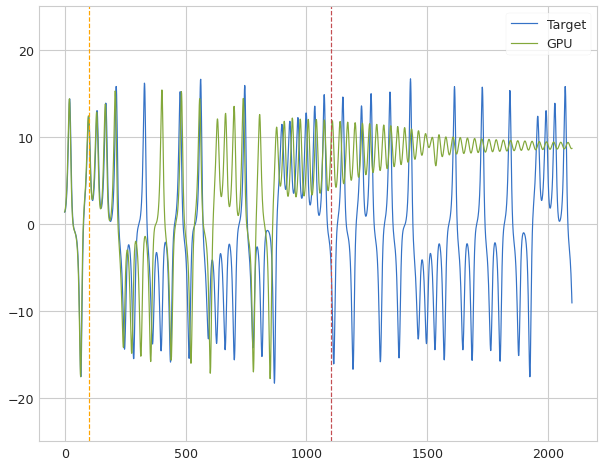

 Iter=3 a=0.661 sr=1.380 amp=1.000  ri=0.074 rr=2.275 loss=0.803895 nrmse=0.223133 CD 0.580762
Iter: 3 #### Time 4.07  NRMSE 0.223 CD 0.581
Iter: 4 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 5 #### Time 3.93  NRMSE 65.376 CD 1.142
Iter: 6 #### Time 3.91  NRMSE 0.322 CD 1.068
Iter: 7 #### Time 3.92  NRMSE 13.211 CD 0.997
Iter: 8 #### Time 3.93  NRMSE 2.089 CD 0.990
Iter: 9 #### Time 3.91  NRMSE 1.273 CD 1.117
Iter: 10 #### Time 3.92  NRMSE 0.364 CD 1.428
Iter: 11 #### Time 3.91  NRMSE 0.342 CD 1.125
Iter: 12 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 13 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 14 #### Time 3.91  NRMSE 0.401 CD 1.045
Iter: 15 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 16 #### Time 3.92  NRMSE 0.377 CD 1.073
Iter: 17 #### Time 3.94  NRMSE 0.277 CD 0.874
Iter: 18 #### Time 3.92  NRMSE 0.321 CD 1.065
Iter: 19 #### Time 3.91  NRMSE 1000.000 CD nan
Iter: 20 #### Time 3.91  NRMSE 0.511 CD 0.890
Iter: 21 #### Time 3.92  NRMSE 1000.000 CD nan
Iter: 22 #### Time 3.92  NRMSE

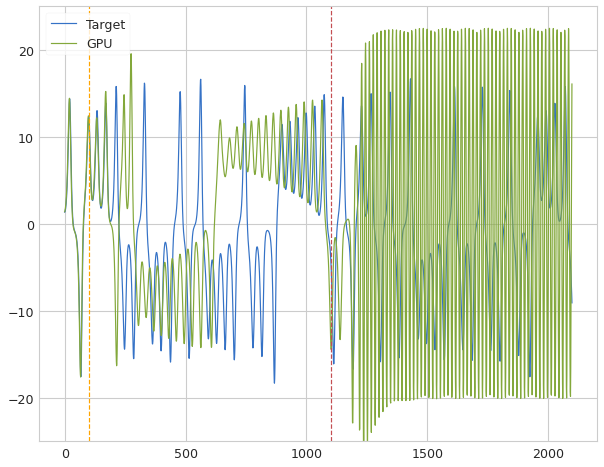

 Iter=7 a=0.528 sr=1.268 amp=1.000  ri=0.092 rr=2.247 loss=1.205229 nrmse=0.288436 CD 0.916794
Iter: 7 #### Time 4.11  NRMSE 0.288 CD 0.917
Iter: 8 #### Time 3.95  NRMSE 0.337 CD 1.065
Dist 0.779107


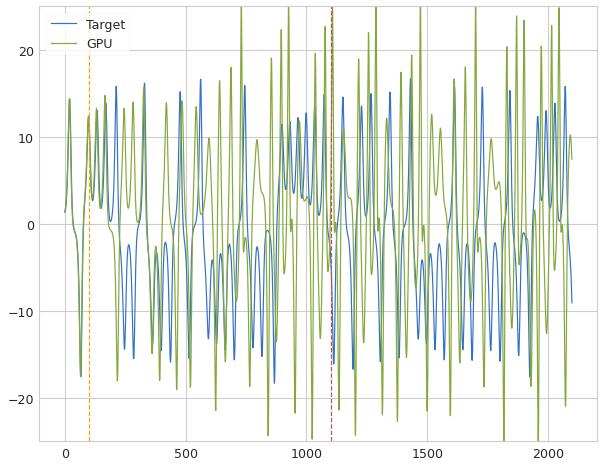

 Iter=9 a=0.597 sr=1.362 amp=1.000  ri=0.097 rr=2.798 loss=1.059772 nrmse=0.280665 CD 0.779107
Iter: 9 #### Time 4.10  NRMSE 0.281 CD 0.779
Iter: 10 #### Time 3.95  NRMSE 0.277 CD 0.868
Iter: 11 #### Time 3.90  NRMSE 1000.000 CD nan
Iter: 12 #### Time 3.92  NRMSE 0.398 CD 1.054
Iter: 13 #### Time 3.91  NRMSE 0.301 CD 1.007
Iter: 14 #### Time 3.92  NRMSE 0.676 CD 0.875
Iter: 15 #### Time 3.89  NRMSE 0.494 CD 0.891
Iter: 16 #### Time 3.93  NRMSE 1.030 CD 1.005
Iter: 17 #### Time 3.93  NRMSE 1.659 CD 1.005
Iter: 18 #### Time 3.90  NRMSE 0.362 CD 0.978
Iter: 19 #### Time 3.94  NRMSE 1000.000 CD nan
Iter: 20 #### Time 3.93  NRMSE 0.305 CD 0.896
Iter: 21 #### Time 3.90  NRMSE 0.341 CD 1.353
Iter: 22 #### Time 3.90  NRMSE 1000.000 CD nan
Iter: 23 #### Time 3.90  NRMSE 0.271 CD 0.825
Iter: 24 #### Time 3.89  NRMSE 0.338 CD 1.142
Iter: 25 #### Time 3.89  NRMSE 0.296 CD 0.961
Iter: 26 #### Time 3.90  NRMSE 10.395 CD 1.002
Iter: 27 #### Time 3.96  NRMSE 0.375 CD 0.976
Iter: 28 #### Time 3.90  NRM

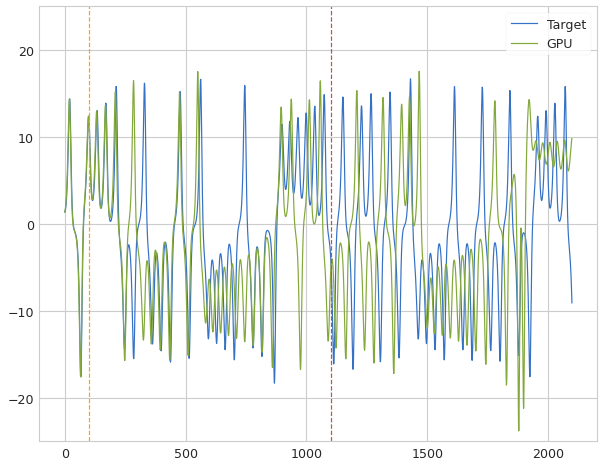

 Iter=86 a=0.568 sr=1.388 amp=1.000  ri=0.078 rr=2.509 loss=0.695450 nrmse=0.208351 CD 0.487098
Iter: 86 #### Time 5.07  NRMSE 0.208 CD 0.487
Iter: 87 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 88 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 89 #### Time 3.89  NRMSE 0.752 CD 1.120
Iter: 90 #### Time 3.90  NRMSE 1000.000 CD nan
Iter: 91 #### Time 3.90  NRMSE 0.240 CD 0.667
Iter: 92 #### Time 3.88  NRMSE 4.344 CD 1.142
Iter: 93 #### Time 3.91  NRMSE 0.323 CD 1.058
Iter: 94 #### Time 3.91  NRMSE 0.259 CD 0.807
Iter: 95 #### Time 3.91  NRMSE 1.550 CD 0.989
Iter: 96 #### Time 3.93  NRMSE 1000.000 CD nan
Iter: 97 #### Time 3.90  NRMSE 1000.000 CD nan
Iter: 98 #### Time 3.91  NRMSE 0.355 CD 0.725
Iter: 99 #### Time 3.91  NRMSE 0.321 CD 1.064
Iter: 100 #### Time 3.89  NRMSE 0.315 CD 1.056
Iter: 101 #### Time 3.90  NRMSE 0.927 CD 0.995
Iter: 102 #### Time 3.89  NRMSE 0.291 CD 0.992
Iter: 103 #### Time 3.90  NRMSE 1000.000 CD nan
Iter: 104 #### Time 3.88  NRMSE 0.549 CD 0.989
Iter: 105 #### Time

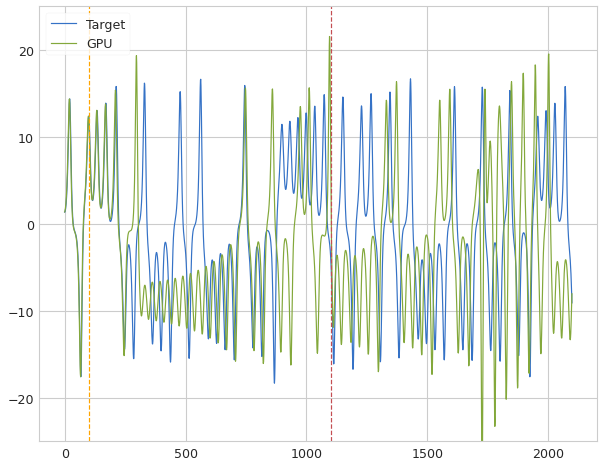

 Iter=6 a=0.846 sr=1.231 amp=1.000  ri=0.078 rr=2.483 loss=0.887538 nrmse=0.242472 CD 0.645066
Iter: 6 #### Time 4.22  NRMSE 0.242 CD 0.645
Iter: 7 #### Time 4.04  NRMSE 0.312 CD 1.062
Iter: 8 #### Time 4.04  NRMSE 0.357 CD 0.984
Iter: 9 #### Time 3.94  NRMSE 2.139 CD 0.998
Iter: 10 #### Time 4.00  NRMSE 0.277 CD 0.860
Iter: 11 #### Time 3.96  NRMSE 1000.000 CD nan
Iter: 12 #### Time 3.97  NRMSE 0.272 CD 0.863
Iter: 13 #### Time 4.01  NRMSE 0.292 CD 0.996
Iter: 14 #### Time 3.99  NRMSE 1.995 CD 0.893
Iter: 15 #### Time 3.99  NRMSE 0.269 CD 0.846
Iter: 16 #### Time 3.97  NRMSE 0.679 CD 1.064
Iter: 17 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.04  NRMSE 0.424 CD 0.969
Iter: 19 #### Time 3.97  NRMSE 0.374 CD 1.056
Iter: 20 #### Time 3.98  NRMSE 0.278 CD 0.881
Iter: 21 #### Time 3.97  NRMSE 0.269 CD 0.845
Iter: 22 #### Time 3.97  NRMSE 1.192 CD 1.129
Iter: 23 #### Time 3.95  NRMSE 0.299 CD 1.037
Iter: 24 #### Time 3.94  NRMSE 0.272 CD 0.852
Iter: 25 #### Time 3.97  NRMSE 0.

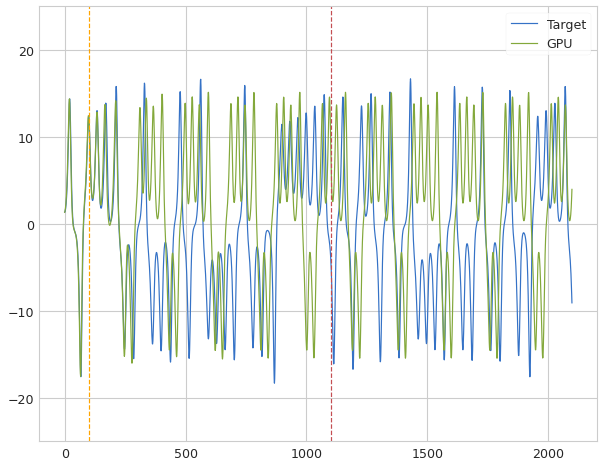

 Iter=0 a=0.556 sr=1.305 amp=1.000  ri=0.076 rr=2.310 loss=1.050756 nrmse=0.267680 CD 0.783077
Iter: 0 #### Time 4.24  NRMSE 0.268 CD 0.783
Iter: 1 #### Time 4.12  NRMSE 0.315 CD 1.058
Iter: 2 #### Time 4.10  NRMSE 1.107 CD 0.973
Iter: 3 #### Time 4.05  NRMSE 0.309 CD 1.053
Iter: 4 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 5 #### Time 4.13  NRMSE 2.566 CD 1.024
Iter: 6 #### Time 4.33  NRMSE 0.877 CD 0.959
Iter: 7 #### Time 4.18  NRMSE 0.636 CD 0.917
Iter: 8 #### Time 4.19  NRMSE 4.197 CD 1.000
Iter: 9 #### Time 4.15  NRMSE 1.037 CD 1.046
Iter: 10 #### Time 4.09  NRMSE 0.339 CD 1.067
Iter: 11 #### Time 4.09  NRMSE 0.283 CD 0.933
Iter: 12 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 14 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.06  NRMSE 0.326 CD 0.967
Iter: 17 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.04  NRMSE 0.275 CD 0.809
Iter: 19 #### Time 4.05  NRMSE 0.36

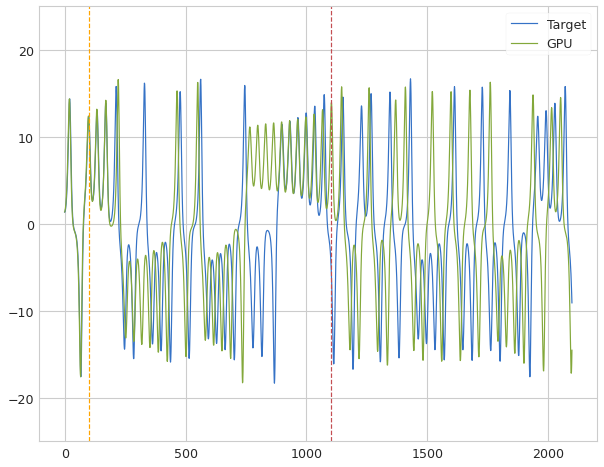

 Iter=73 a=0.549 sr=1.289 amp=1.000  ri=0.075 rr=2.162 loss=0.790614 nrmse=0.222187 CD 0.568427
Iter: 73 #### Time 4.51  NRMSE 0.222 CD 0.568
Iter: 74 #### Time 4.05  NRMSE 0.435 CD 0.984
Iter: 75 #### Time 4.06  NRMSE 0.561 CD 0.983
Iter: 76 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 77 #### Time 4.09  NRMSE 3.610 CD 1.002
Iter: 78 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 79 #### Time 4.07  NRMSE 0.807 CD 0.997
Iter: 80 #### Time 4.14  NRMSE 0.318 CD 1.155
Iter: 81 #### Time 4.00  NRMSE 1000.000 CD nan
Iter: 82 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 83 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 84 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 85 #### Time 4.04  NRMSE 0.254 CD 0.758
Iter: 86 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 87 #### Time 4.03  NRMSE 1.129 CD 1.007
Iter: 88 #### Time 3.98  NRMSE 1000.000 CD nan
Iter: 89 #### Time 4.06  NRMSE 0.842 CD 1.047
Iter: 90 #### Time 4.06  NRMSE 0.343 CD 1.055
Iter: 91 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 92 #### Time 4.

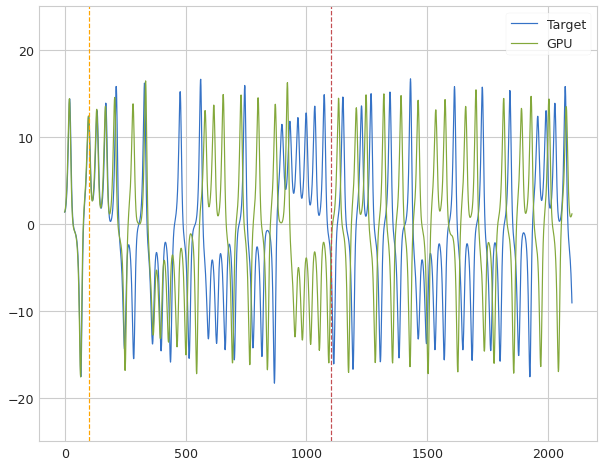

 Iter=11 a=0.761 sr=1.333 amp=1.000  ri=0.087 rr=2.811 loss=1.155126 nrmse=0.278063 CD 0.877063
Iter: 11 #### Time 4.19  NRMSE 0.278 CD 0.877
Iter: 12 #### Time 4.13  NRMSE 0.671 CD 1.005
Iter: 13 #### Time 4.11  NRMSE 1.854 CD 1.095
Iter: 14 #### Time 4.20  NRMSE 0.300 CD 0.953
Iter: 15 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.68  NRMSE 0.356 CD 0.912
Iter: 17 #### Time 4.18  NRMSE 0.340 CD 1.076
Iter: 18 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.30  NRMSE 0.331 CD 0.987
Iter: 20 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.17  NRMSE 0.308 CD 1.063
Iter: 22 #### Time 4.10  NRMSE 0.359 CD 1.033
Iter: 23 #### Time 4.11  NRMSE 0.315 CD 1.061
Dist 0.876074


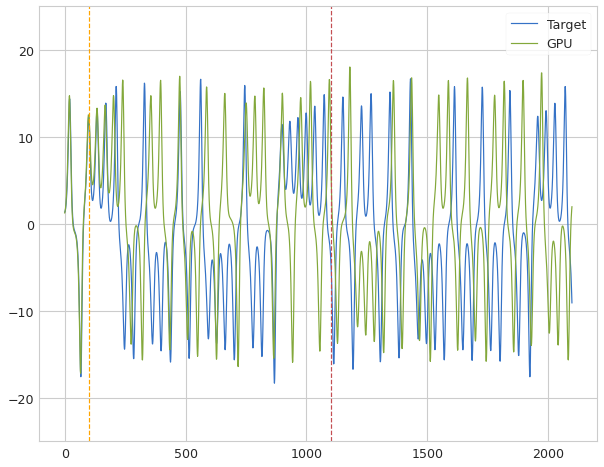

 Iter=24 a=0.613 sr=1.376 amp=1.000  ri=0.055 rr=2.828 loss=1.153523 nrmse=0.277450 CD 0.876074
Iter: 24 #### Time 4.32  NRMSE 0.277 CD 0.876
Iter: 25 #### Time 4.07  NRMSE 0.287 CD 0.880
Dist 0.845564


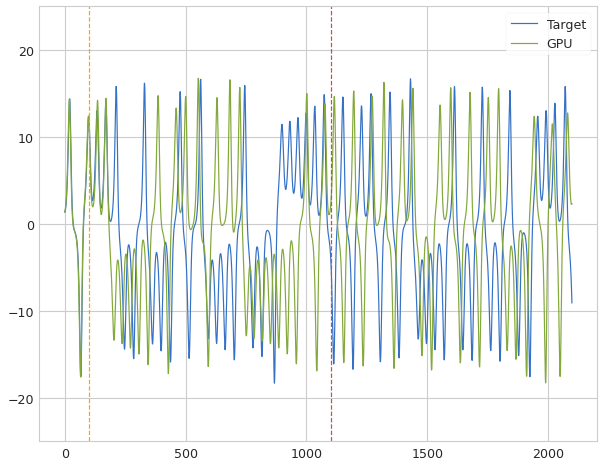

 Iter=26 a=0.575 sr=1.294 amp=1.000  ri=0.051 rr=2.172 loss=1.116879 nrmse=0.271315 CD 0.845564
Iter: 26 #### Time 4.24  NRMSE 0.271 CD 0.846
Dist 0.833313


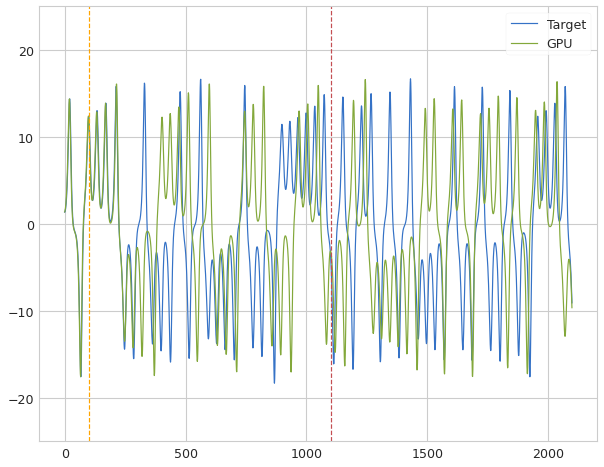

 Iter=27 a=0.619 sr=1.254 amp=1.000  ri=0.089 rr=2.503 loss=1.100881 nrmse=0.267568 CD 0.833313
Iter: 27 #### Time 4.24  NRMSE 0.268 CD 0.833
Iter: 28 #### Time 4.04  NRMSE 0.622 CD 0.912
Iter: 29 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.12  NRMSE 0.325 CD 1.068
Iter: 31 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 32 #### Time 4.06  NRMSE 0.944 CD 1.093
Iter: 33 #### Time 4.12  NRMSE 0.329 CD 1.107
Iter: 34 #### Time 4.07  NRMSE 2.029 CD 0.994
Iter: 35 #### Time 4.04  NRMSE 0.385 CD 0.922
Iter: 36 #### Time 4.10  NRMSE 0.705 CD 0.992
Iter: 37 #### Time 4.25  NRMSE 0.317 CD 1.057
Iter: 38 #### Time 4.18  NRMSE 1.967 CD 0.998
Iter: 39 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 40 #### Time 4.14  NRMSE 2.366 CD 0.991
Iter: 41 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 42 #### Time 4.06  NRMSE 0.305 CD 1.009
Iter: 43 #### Time 4.19  NRMSE 0.314 CD 1.088
Iter: 44 #### Time 4.16  NRMSE 0.295 CD 0.931
Iter: 45 #### Time 4.04  NRMSE 0.270 CD 0.839
Iter: 46 #### Time 4.14  N

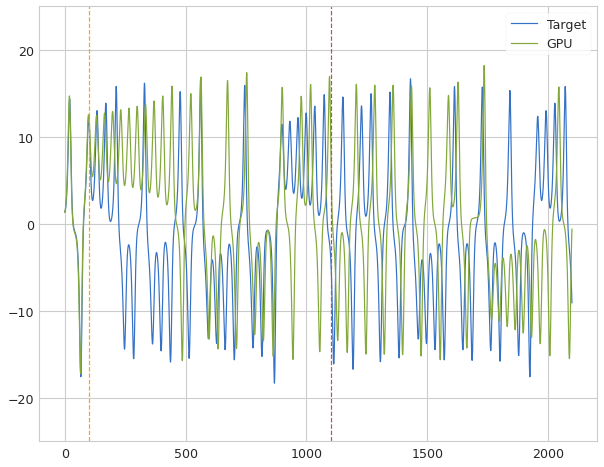

 Iter=61 a=0.540 sr=1.300 amp=1.000  ri=0.080 rr=2.070 loss=1.087808 nrmse=0.270901 CD 0.816907
Iter: 61 #### Time 4.21  NRMSE 0.271 CD 0.817
Iter: 62 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 63 #### Time 4.12  NRMSE 0.315 CD 1.050
Iter: 64 #### Time 4.10  NRMSE 1.017 CD 0.990
Iter: 65 #### Time 4.17  NRMSE 0.370 CD 1.001
Iter: 66 #### Time 4.30  NRMSE 0.304 CD 1.006
Iter: 67 #### Time 4.23  NRMSE 0.321 CD 1.063
Iter: 68 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 69 #### Time 4.06  NRMSE 1.382 CD 0.981
Iter: 70 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 71 #### Time 4.12  NRMSE 0.486 CD 0.935
Iter: 72 #### Time 4.18  NRMSE 0.305 CD 1.020
Iter: 73 #### Time 4.13  NRMSE 1.111 CD 0.996
Iter: 74 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 75 #### Time 4.13  NRMSE 0.348 CD 0.927
Iter: 76 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 77 #### Time 4.14  NRMSE 0.314 CD 0.896
Iter: 78 #### Time 4.09  NRMSE 1.704 CD 1.000
Iter: 79 #### Time 4.09  NRMSE 0.281 CD 0.876
Iter: 80 #### Time 4.08  

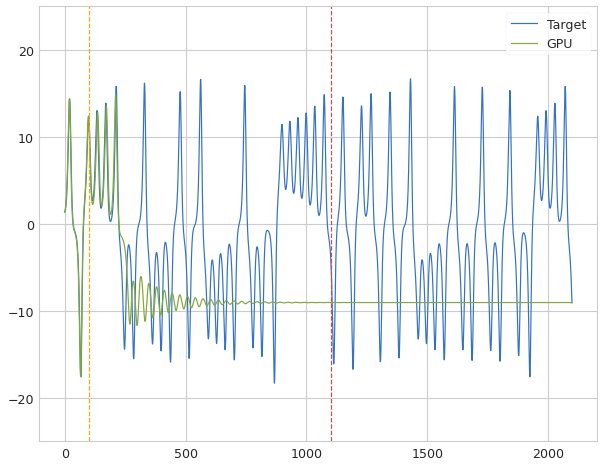

 Iter=126 a=0.900 sr=1.400 amp=1.000  ri=0.100 rr=2.000 loss=1.032018 nrmse=0.270132 CD 0.761886
Iter: 126 #### Time 4.22  NRMSE 0.270 CD 0.762
Iter: 127 #### Time 4.05  NRMSE 0.636 CD 1.018
Iter: 128 #### Time 4.17  NRMSE 1.223 CD 0.996
Iter: 129 #### Time 4.09  NRMSE 0.279 CD 0.825
Iter: 130 #### Time 4.15  NRMSE 0.304 CD 0.833
Iter: 131 #### Time 4.15  NRMSE 0.919 CD 1.019
Iter: 132 #### Time 4.09  NRMSE 0.409 CD 1.073
Iter: 133 #### Time 4.20  NRMSE 0.370 CD 1.349
Iter: 134 #### Time 4.11  NRMSE 3.813 CD 0.991
Iter: 135 #### Time 4.30  NRMSE 1.306 CD 0.991
Dist 0.753704


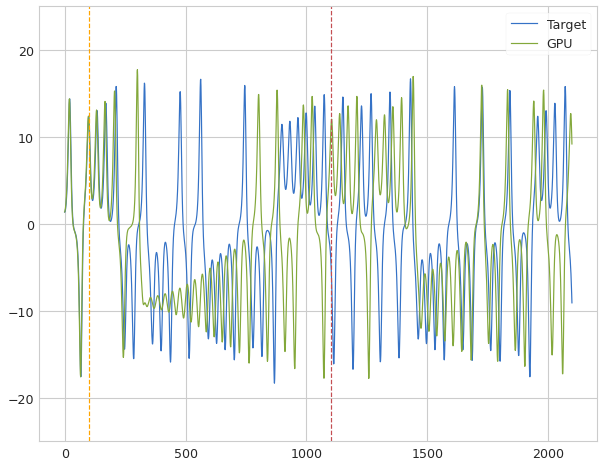

 Iter=136 a=0.900 sr=1.400 amp=1.000  ri=0.094 rr=2.000 loss=1.014197 nrmse=0.260493 CD 0.753704
Iter: 136 #### Time 4.46  NRMSE 0.260 CD 0.754
Iter: 137 #### Time 4.07  NRMSE 0.306 CD 1.061
Iter: 138 #### Time 4.16  NRMSE 0.589 CD 0.925
Iter: 139 #### Time 4.10  NRMSE 0.337 CD 0.961
Iter: 140 #### Time 4.13  NRMSE 3.692 CD 0.999
Iter: 141 #### Time 4.34  NRMSE 0.507 CD 0.968
Iter: 142 #### Time 4.11  NRMSE 0.359 CD 1.059
Iter: 143 #### Time 4.31  NRMSE 0.276 CD 0.914
Iter: 144 #### Time 4.40  NRMSE 1.179 CD 1.010
Iter: 145 #### Time 4.42  NRMSE 0.289 CD 0.979
Iter: 146 #### Time 4.14  NRMSE 0.314 CD 1.032
Dist 0.679395


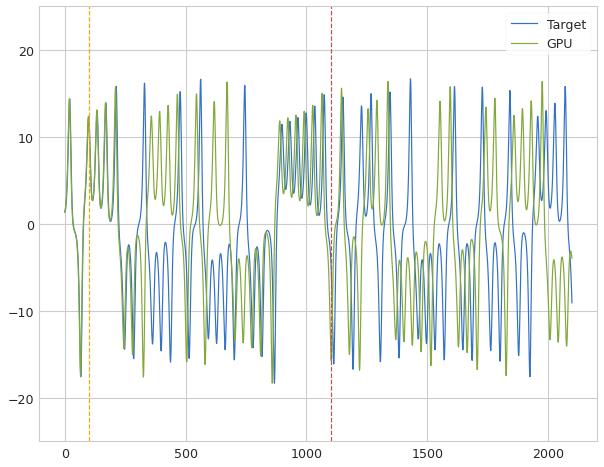

 Iter=147 a=0.900 sr=1.385 amp=1.000  ri=0.096 rr=2.142 loss=0.920545 nrmse=0.241151 CD 0.679395
Iter: 147 #### Time 4.32  NRMSE 0.241 CD 0.679
Iter: 148 #### Time 4.15  NRMSE 0.289 CD 0.962
Iter: 149 #### Time 4.27  NRMSE 0.277 CD 0.873
End Run 3 Time 767.783

Best result = 0.9205453969807214
a = 0.9
sr = 1.385351022812968
amp = 0.09560072097559577
ri = 2.1418710361071094
********** Size 50 -- Run 3 ***********
Dist 1.037127


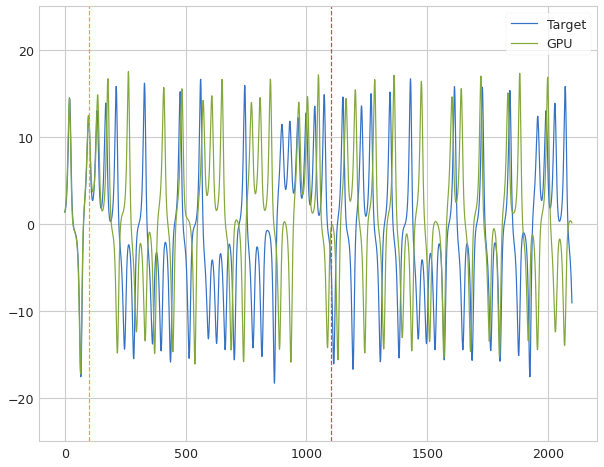

 Iter=0 a=0.618 sr=1.211 amp=1.000  ri=0.032 rr=2.984 loss=1.335760 nrmse=0.298632 CD 1.037127
Iter: 0 #### Time 4.23  NRMSE 0.299 CD 1.037
Iter: 1 #### Time 4.12  NRMSE 0.311 CD 1.056
Iter: 2 #### Time 4.29  NRMSE 0.326 CD 1.065
Dist 0.989751


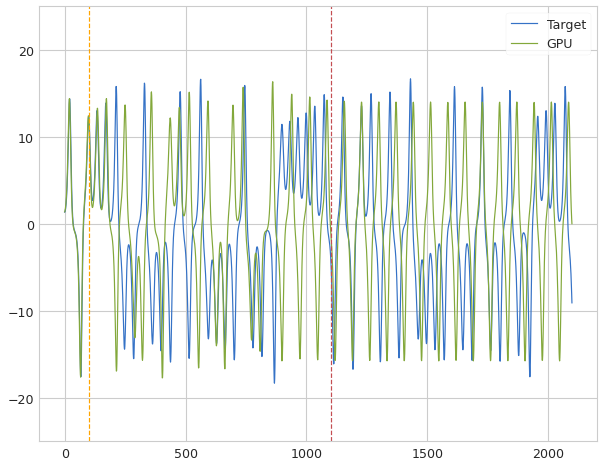

 Iter=3 a=0.661 sr=1.380 amp=1.000  ri=0.074 rr=2.275 loss=1.281314 nrmse=0.291564 CD 0.989751
Iter: 3 #### Time 4.30  NRMSE 0.292 CD 0.990
Iter: 4 #### Time 4.05  NRMSE 0.345 CD 0.937
Iter: 5 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 7 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.14  NRMSE 1.077 CD 1.059
Iter: 9 #### Time 4.20  NRMSE 0.880 CD 1.015
Iter: 10 #### Time 4.07  NRMSE 0.343 CD 1.070
Iter: 11 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 12 #### Time 4.22  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.09  NRMSE 1.826 CD 0.997
Iter: 14 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.02  NRMSE 4.979 CD 0.894
Iter: 16 #### Time 4.06  NRMSE 1.428 CD 0.994
Iter: 17 #### Time 4.06  NRMSE 3.092 CD 0.999
Iter: 18 #### Time 4.02  NRMSE 0.315 CD 1.063
Iter: 19 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.03  NRMSE 0.332 CD 1.101
Iter: 21 #### Time 4.11  NRMSE 0.300 CD 1.056
Dist 0.899599


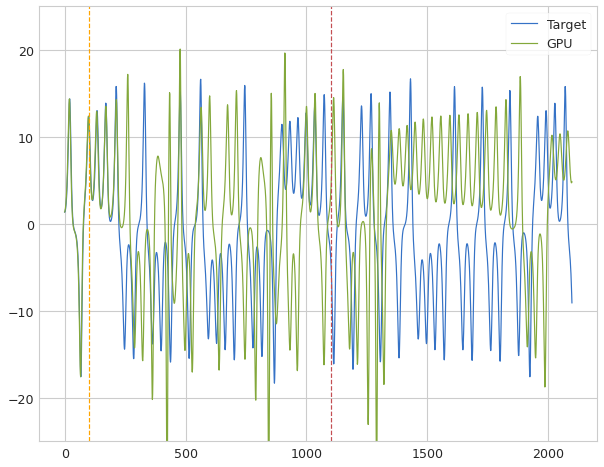

 Iter=22 a=0.768 sr=1.235 amp=1.000  ri=0.084 rr=2.581 loss=1.192647 nrmse=0.293047 CD 0.899599
Iter: 22 #### Time 4.57  NRMSE 0.293 CD 0.900
Iter: 23 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 24 #### Time 4.09  NRMSE 0.312 CD 1.062
Iter: 25 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.08  NRMSE 2.969 CD 1.138
Dist 0.748333


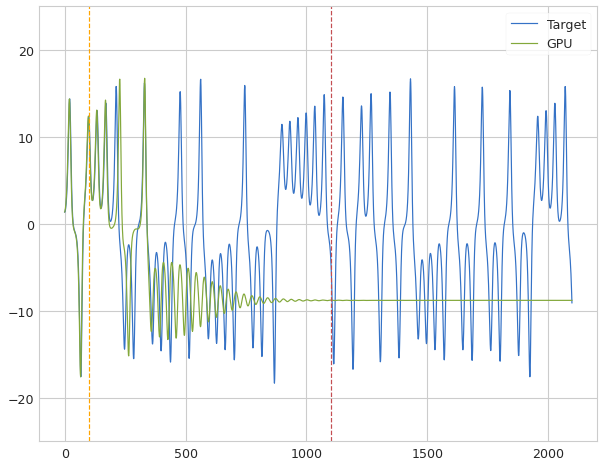

 Iter=27 a=0.587 sr=1.225 amp=1.000  ri=0.036 rr=2.618 loss=1.010710 nrmse=0.262377 CD 0.748333
Iter: 27 #### Time 4.27  NRMSE 0.262 CD 0.748
Iter: 28 #### Time 4.17  NRMSE 0.334 CD 1.098
Iter: 29 #### Time 4.21  NRMSE 0.309 CD 1.024
Iter: 30 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 31 #### Time 4.08  NRMSE 0.673 CD 1.054
Iter: 32 #### Time 4.08  NRMSE 1.383 CD 1.018
Iter: 33 #### Time 4.08  NRMSE 16.384 CD 1.137
Iter: 34 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 35 #### Time 4.18  NRMSE 0.749 CD 0.986
Iter: 36 #### Time 4.26  NRMSE 0.662 CD 1.080
Iter: 37 #### Time 4.14  NRMSE 1.035 CD 1.002
Iter: 38 #### Time 4.13  NRMSE 0.336 CD 1.066
Iter: 39 #### Time 4.11  NRMSE 1.068 CD 0.885
Iter: 40 #### Time 4.20  NRMSE 1000.000 CD nan
Iter: 41 #### Time 4.26  NRMSE 1000.000 CD nan
Iter: 42 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 43 #### Time 4.10  NRMSE 0.316 CD 1.062
Iter: 44 #### Time 4.04  NRMSE 0.386 CD 1.036
Iter: 45 #### Time 4.09  NRMSE 0.294 CD 1.020
Iter: 46 #### Time 4.20 

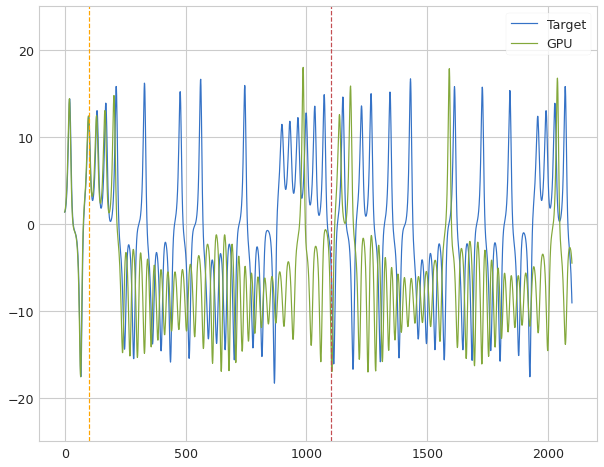

 Iter=106 a=0.500 sr=1.200 amp=1.000  ri=0.100 rr=2.000 loss=0.978454 nrmse=0.261031 CD 0.717423
Iter: 106 #### Time 4.29  NRMSE 0.261 CD 0.717
Iter: 107 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 108 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 109 #### Time 4.16  NRMSE 0.359 CD 0.778
Iter: 110 #### Time 4.19  NRMSE 0.310 CD 1.064
Iter: 111 #### Time 4.00  NRMSE 0.326 CD 1.074
Iter: 112 #### Time 4.23  NRMSE 0.296 CD 1.094
Iter: 113 #### Time 4.05  NRMSE 0.332 CD 1.166
Iter: 114 #### Time 4.29  NRMSE 0.285 CD 0.926
Iter: 115 #### Time 4.15  NRMSE 0.688 CD 1.096
Iter: 116 #### Time 4.20  NRMSE 0.301 CD 0.813
Iter: 117 #### Time 4.06  NRMSE 0.376 CD 0.895
Iter: 118 #### Time 4.24  NRMSE 0.349 CD 1.133
Iter: 119 #### Time 4.04  NRMSE 0.304 CD 1.060
Iter: 120 #### Time 4.08  NRMSE 0.310 CD 1.062
Iter: 121 #### Time 4.13  NRMSE 0.299 CD 1.043
Iter: 122 #### Time 4.17  NRMSE 0.512 CD 0.983
Iter: 123 #### Time 4.09  NRMSE 0.326 CD 1.062
Iter: 124 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 1

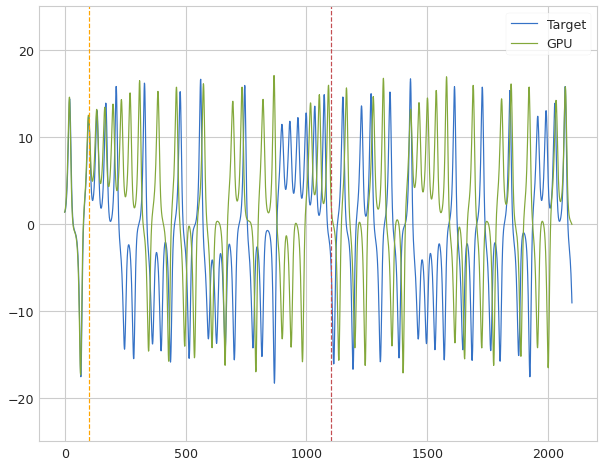

 Iter=4 a=0.707 sr=1.331 amp=1.000  ri=0.061 rr=2.039 loss=1.263830 nrmse=0.292438 CD 0.971392
Iter: 4 #### Time 4.25  NRMSE 0.292 CD 0.971
Dist 0.868104


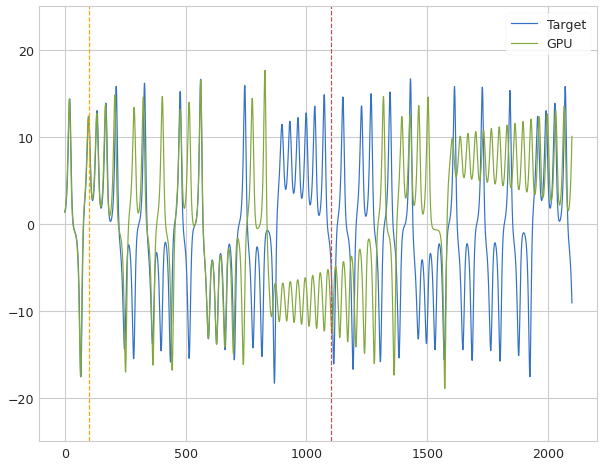

 Iter=5 a=0.560 sr=1.227 amp=1.000  ri=0.065 rr=2.763 loss=1.145168 nrmse=0.277064 CD 0.868104
Iter: 5 #### Time 4.22  NRMSE 0.277 CD 0.868
Iter: 6 #### Time 4.16  NRMSE 1.910 CD 1.011
Iter: 7 #### Time 4.12  NRMSE 0.323 CD 1.049
Dist 0.839321


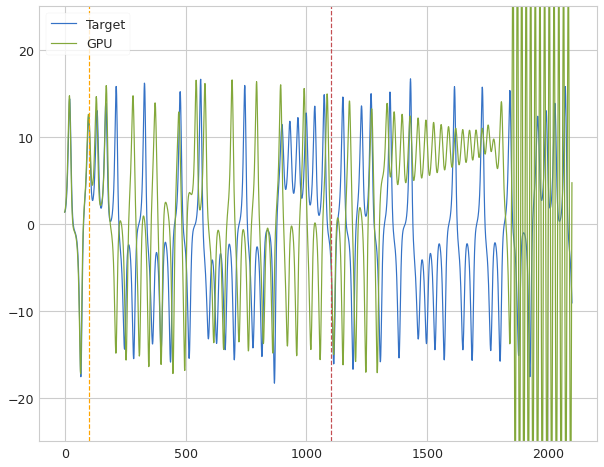

 Iter=8 a=0.701 sr=1.394 amp=1.000  ri=0.066 rr=2.311 loss=1.114253 nrmse=0.274932 CD 0.839321
Iter: 8 #### Time 4.47  NRMSE 0.275 CD 0.839
Iter: 9 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 10 #### Time 4.22  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.05  NRMSE 0.360 CD 1.095
Dist 0.778797


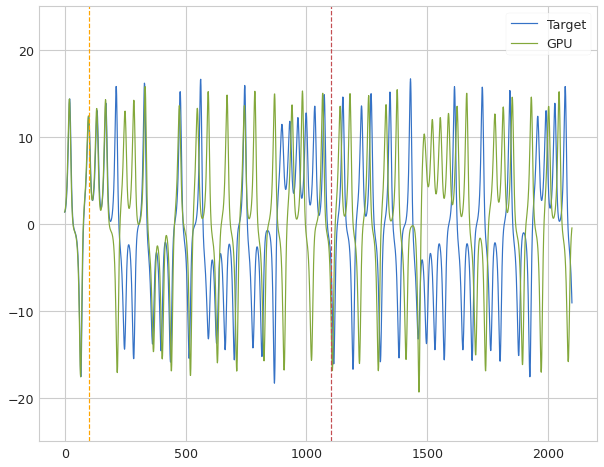

 Iter=12 a=0.701 sr=1.394 amp=1.000  ri=0.045 rr=2.569 loss=1.034914 nrmse=0.256117 CD 0.778797
Iter: 12 #### Time 4.28  NRMSE 0.256 CD 0.779
Iter: 13 #### Time 4.07  NRMSE 0.691 CD 0.876
Iter: 14 #### Time 4.08  NRMSE 1.135 CD 1.090
Iter: 15 #### Time 4.31  NRMSE 4.520 CD 0.858
Iter: 16 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 17 #### Time 4.42  NRMSE 0.324 CD 1.064
Iter: 18 #### Time 4.27  NRMSE 1.027 CD 0.971
Iter: 19 #### Time 4.74  NRMSE 8.792 CD 1.133
Dist 0.727917


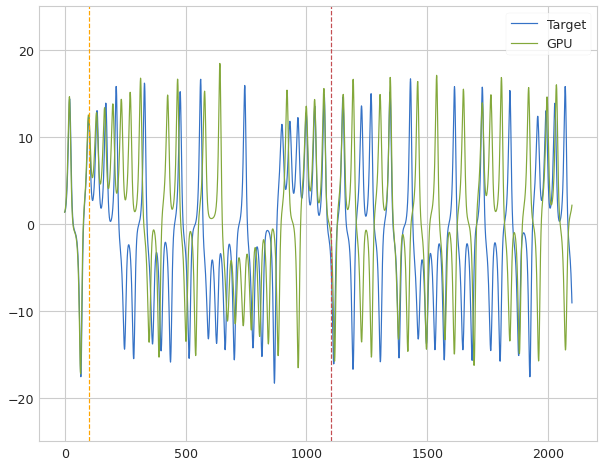

 Iter=20 a=0.580 sr=1.321 amp=1.000  ri=0.077 rr=2.158 loss=0.979226 nrmse=0.251309 CD 0.727917
Iter: 20 #### Time 4.30  NRMSE 0.251 CD 0.728
Iter: 21 #### Time 4.12  NRMSE 0.333 CD 1.015
Iter: 22 #### Time 4.20  NRMSE 4.257 CD 1.003
Iter: 23 #### Time 4.15  NRMSE 0.345 CD 1.050
Iter: 24 #### Time 4.17  NRMSE 0.345 CD 1.075
Iter: 25 #### Time 4.19  NRMSE 0.424 CD 1.071
Iter: 26 #### Time 4.25  NRMSE 1000.000 CD nan
Iter: 27 #### Time 4.17  NRMSE 0.323 CD 1.061
Iter: 28 #### Time 4.36  NRMSE 1000.000 CD nan
Iter: 29 #### Time 4.28  NRMSE 0.847 CD 0.884
Iter: 30 #### Time 4.18  NRMSE 0.276 CD 0.986
Iter: 31 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 32 #### Time 4.05  NRMSE 0.295 CD 0.763
Iter: 33 #### Time 4.12  NRMSE 0.307 CD 1.066
Iter: 34 #### Time 4.17  NRMSE 0.303 CD 1.015
Iter: 35 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 36 #### Time 4.42  NRMSE 1.936 CD 0.994
Iter: 37 #### Time 4.07  NRMSE 0.378 CD 0.905
Iter: 38 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 39 #### Time 4.10  

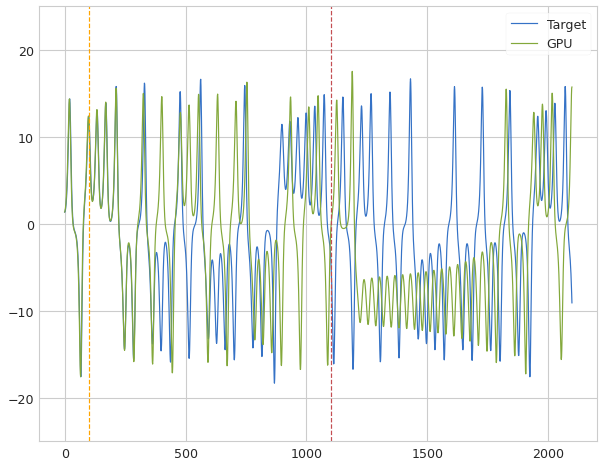

 Iter=59 a=0.590 sr=1.258 amp=1.000  ri=0.052 rr=2.488 loss=0.834378 nrmse=0.228519 CD 0.605859
Iter: 59 #### Time 4.26  NRMSE 0.229 CD 0.606
Iter: 60 #### Time 4.16  NRMSE 0.320 CD 1.062
Iter: 61 #### Time 4.04  NRMSE 0.234 CD 0.873
Iter: 62 #### Time 4.09  NRMSE 0.739 CD 1.090
Iter: 63 #### Time 4.05  NRMSE 0.274 CD 0.977
Iter: 64 #### Time 4.16  NRMSE 0.311 CD 0.878
Iter: 65 #### Time 4.10  NRMSE 0.295 CD 0.951
Iter: 66 #### Time 4.07  NRMSE 0.274 CD 0.859
Iter: 67 #### Time 4.28  NRMSE 0.380 CD 0.930
Iter: 68 #### Time 4.07  NRMSE 0.251 CD 0.782
Iter: 69 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 70 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 71 #### Time 4.05  NRMSE 0.270 CD 0.809
Iter: 72 #### Time 4.44  NRMSE 0.324 CD 0.993
Iter: 73 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 74 #### Time 4.07  NRMSE 0.324 CD 1.016
Iter: 75 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 76 #### Time 4.02  NRMSE 0.651 CD 0.983
Iter: 77 #### Time 4.15  NRMSE 0.265 CD 0.818
Iter: 78 #### Time 4.10  N

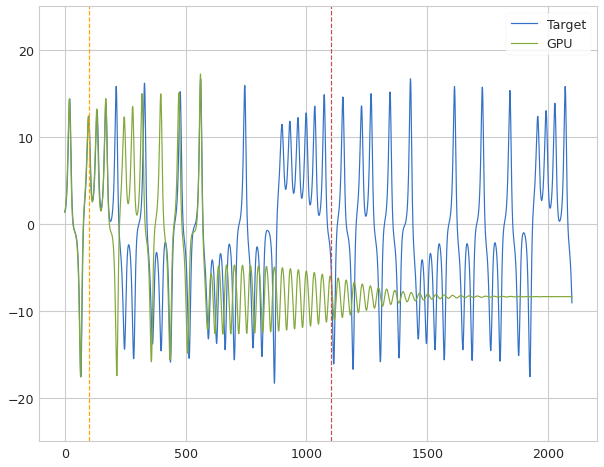

 Iter=1 a=0.542 sr=1.245 amp=1.000  ri=0.090 rr=2.826 loss=1.104500 nrmse=0.273504 CD 0.830996
Iter: 1 #### Time 4.87  NRMSE 0.274 CD 0.831
Iter: 2 #### Time 4.52  NRMSE 0.397 CD 0.954
Iter: 3 #### Time 4.09  NRMSE 0.308 CD 1.024
Iter: 4 #### Time 4.11  NRMSE 0.608 CD 0.995
Iter: 5 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.12  NRMSE 1.001 CD 0.990
Iter: 7 #### Time 4.14  NRMSE 1.440 CD 1.001
Iter: 8 #### Time 4.12  NRMSE 2.557 CD 0.995
Iter: 9 #### Time 4.05  NRMSE 1.053 CD 0.979
Iter: 10 #### Time 4.12  NRMSE 0.297 CD 0.954
Iter: 11 #### Time 4.11  NRMSE 0.536 CD 0.919
Iter: 12 #### Time 4.05  NRMSE 0.324 CD 1.067
Iter: 13 #### Time 4.17  NRMSE 0.395 CD 0.946
Iter: 14 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.07  NRMSE 0.504 CD 1.072
Iter: 16 #### Time 4.05  NRMSE 0.530 CD 1.000
Iter: 17 #### Time 4.07  NRMSE 0.272 CD 0.864
Iter: 18 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.06  NRMSE 1.866

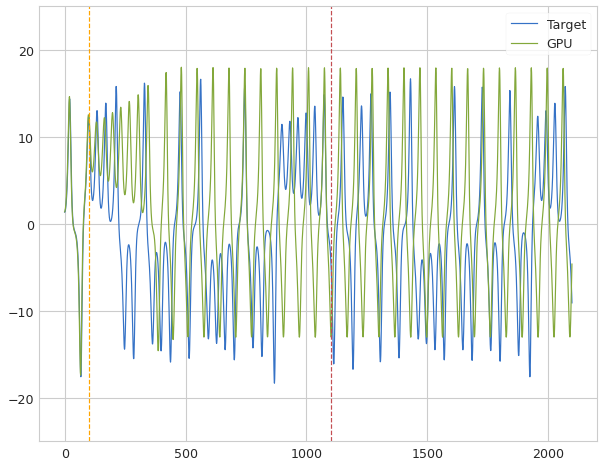

 Iter=29 a=0.779 sr=1.356 amp=1.000  ri=0.046 rr=2.646 loss=1.099017 nrmse=0.276996 CD 0.822021
Iter: 29 #### Time 4.26  NRMSE 0.277 CD 0.822
Iter: 30 #### Time 4.72  NRMSE 1.295 CD 0.994
Iter: 31 #### Time 4.07  NRMSE 0.320 CD 1.063
Iter: 32 #### Time 4.18  NRMSE 1.724 CD 0.951
Iter: 33 #### Time 4.25  NRMSE 1000.000 CD nan
Iter: 34 #### Time 4.37  NRMSE 1.241 CD 1.007
Iter: 35 #### Time 4.95  NRMSE 0.770 CD 1.011
Dist 0.690865


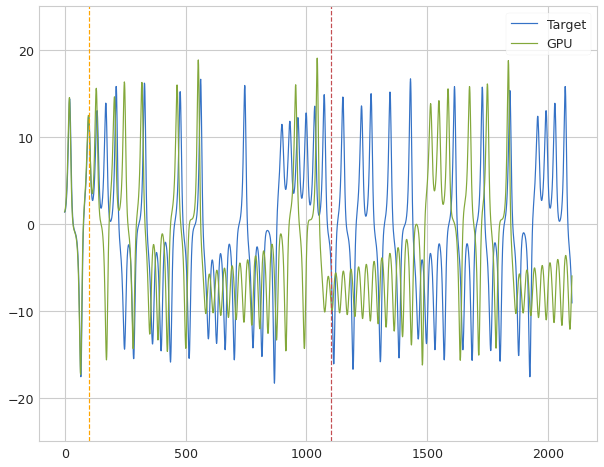

 Iter=36 a=0.621 sr=1.200 amp=1.000  ri=0.026 rr=2.276 loss=0.934043 nrmse=0.243177 CD 0.690865
Iter: 36 #### Time 4.94  NRMSE 0.243 CD 0.691
Iter: 37 #### Time 4.26  NRMSE 1000.000 CD nan
Iter: 38 #### Time 4.49  NRMSE 1000.000 CD nan
Iter: 39 #### Time 4.30  NRMSE 0.280 CD 0.817
Iter: 40 #### Time 4.21  NRMSE 3.312 CD 0.923
Iter: 41 #### Time 4.62  NRMSE 0.406 CD 0.870
Iter: 42 #### Time 4.21  NRMSE 0.611 CD 1.007
Iter: 43 #### Time 4.24  NRMSE 3.694 CD 1.116
Iter: 44 #### Time 4.67  NRMSE 1000.000 CD nan
Iter: 45 #### Time 4.54  NRMSE 1000.000 CD nan
Iter: 46 #### Time 4.13  NRMSE 15309914.209 CD 0.783
Iter: 47 #### Time 4.10  NRMSE 2.666 CD 1.004
Iter: 48 #### Time 4.34  NRMSE 1000.000 CD nan
Iter: 49 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 50 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 51 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 52 #### Time 4.07  NRMSE 0.352 CD 0.944
Iter: 53 #### Time 4.15  NRMSE 0.375 CD 1.050
Iter: 54 #### Time 4.04  NRMSE 0.716 CD 1.110
Iter: 55 #### T

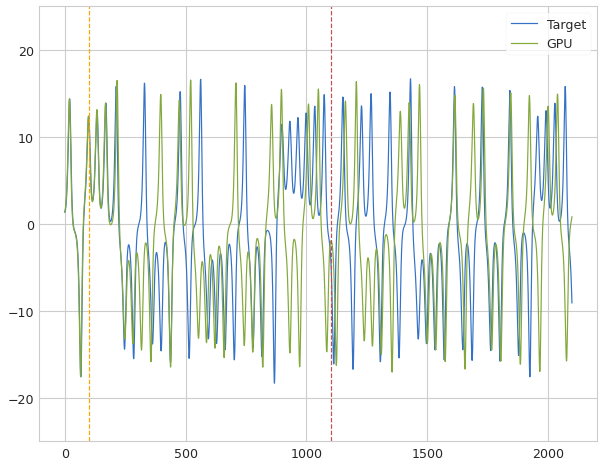

 Iter=0 a=0.556 sr=1.305 amp=1.000  ri=0.076 rr=2.310 loss=0.979934 nrmse=0.251926 CD 0.728007
Iter: 0 #### Time 4.31  NRMSE 0.252 CD 0.728
Iter: 1 #### Time 4.51  NRMSE 1.463 CD 0.981
Iter: 2 #### Time 4.31  NRMSE 1.323 CD 0.991
Iter: 3 #### Time 4.21  NRMSE 1000.000 CD nan
Iter: 4 #### Time 4.19  NRMSE 0.270 CD 0.866
Iter: 5 #### Time 4.22  NRMSE 0.965 CD 1.002
Iter: 6 #### Time 4.18  NRMSE 0.259 CD 0.755
Iter: 7 #### Time 4.20  NRMSE 0.340 CD 0.735
Iter: 8 #### Time 4.12  NRMSE 1.702 CD 0.997
Iter: 9 #### Time 4.13  NRMSE 0.270 CD 0.842
Iter: 10 #### Time 4.19  NRMSE 0.296 CD 1.026
Iter: 11 #### Time 4.11  NRMSE 0.375 CD 1.054
Iter: 12 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.26  NRMSE 1.535 CD 1.002
Iter: 14 #### Time 4.17  NRMSE 0.370 CD 0.976
Iter: 15 #### Time 4.11  NRMSE 0.299 CD 0.944
Iter: 16 #### Time 4.07  NRMSE 2.667 CD 1.004
Iter: 17 #### Time 4.13  NRMSE 3.483 CD 0.995
Iter: 18 #### Time 4.06  NRMSE 1.628 CD 0.976
Iter: 19 #### Time 4.10  NRMSE 0.284 CD

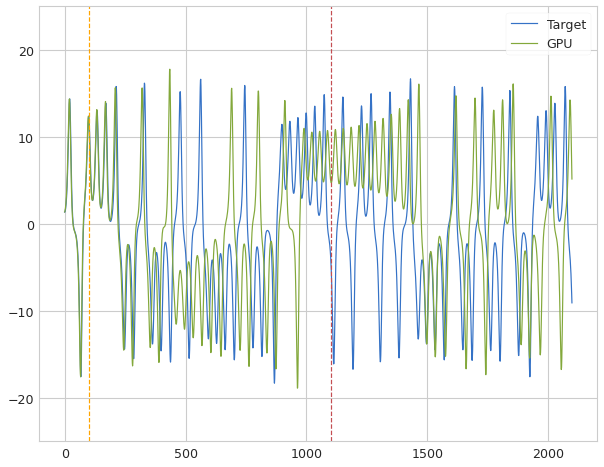

 Iter=67 a=0.846 sr=1.214 amp=1.000  ri=0.046 rr=2.489 loss=0.921936 nrmse=0.244475 CD 0.677461
Iter: 67 #### Time 4.34  NRMSE 0.244 CD 0.677
Iter: 68 #### Time 4.08  NRMSE 0.291 CD 0.816
Iter: 69 #### Time 4.12  NRMSE 0.933 CD 0.989
Iter: 70 #### Time 4.12  NRMSE 2.022 CD 0.997
Iter: 71 #### Time 4.25  NRMSE 0.282 CD 0.912
Iter: 72 #### Time 4.20  NRMSE 1196578058.972 CD 0.977
Iter: 73 #### Time 4.31  NRMSE 0.289 CD 0.900
Iter: 74 #### Time 4.27  NRMSE 0.926 CD 1.108
Iter: 75 #### Time 4.18  NRMSE 0.325 CD 1.063
Iter: 76 #### Time 4.29  NRMSE 10.416 CD 1.000
Iter: 77 #### Time 4.08  NRMSE 0.318 CD 1.059
Iter: 78 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 79 #### Time 4.11  NRMSE 0.320 CD 1.064
Iter: 80 #### Time 4.33  NRMSE 1.669 CD 1.001
Iter: 81 #### Time 4.12  NRMSE 0.720 CD 1.003
Iter: 82 #### Time 4.28  NRMSE 1000.000 CD nan
Iter: 83 #### Time 4.19  NRMSE 1000.000 CD nan
Iter: 84 #### Time 4.12  NRMSE 0.324 CD 1.067
Iter: 85 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 86 #### Ti

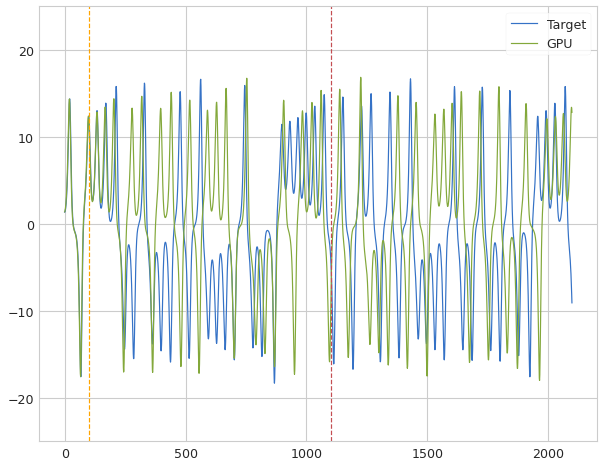

 Iter=11 a=0.761 sr=1.333 amp=1.000  ri=0.087 rr=2.811 loss=1.182496 nrmse=0.278040 CD 0.904456
Iter: 11 #### Time 4.17  NRMSE 0.278 CD 0.904
Iter: 12 #### Time 4.23  NRMSE 0.329 CD 1.058
Iter: 13 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 14 #### Time 4.09  NRMSE 0.313 CD 1.117
Iter: 15 #### Time 4.37  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.34  NRMSE 0.571 CD 1.021
Iter: 17 #### Time 4.10  NRMSE 0.864 CD 0.975
Iter: 18 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.17  NRMSE 0.351 CD 1.059
Iter: 21 #### Time 4.08  NRMSE 0.921 CD 1.105
Iter: 22 #### Time 4.07  NRMSE 0.304 CD 1.076
Dist 0.638726


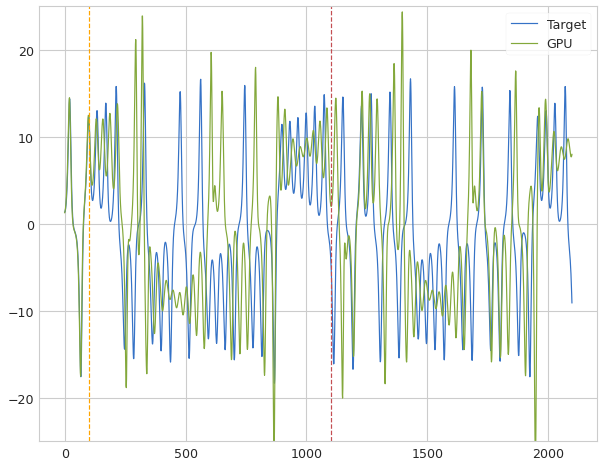

 Iter=23 a=0.640 sr=1.355 amp=1.000  ri=0.090 rr=2.786 loss=0.891035 nrmse=0.252309 CD 0.638726
Iter: 23 #### Time 4.30  NRMSE 0.252 CD 0.639
Iter: 24 #### Time 4.15  NRMSE 9.854 CD 1.143
Iter: 25 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.16  NRMSE 0.497 CD 0.918
Iter: 27 #### Time 4.12  NRMSE 0.290 CD 0.916
Iter: 28 #### Time 4.09  NRMSE 0.314 CD 1.097
Iter: 29 #### Time 4.11  NRMSE 10.020 CD 1.157
Iter: 30 #### Time 4.08  NRMSE 0.315 CD 1.070
Iter: 31 #### Time 4.14  NRMSE 1.149 CD 0.984
Iter: 32 #### Time 4.13  NRMSE 1.227 CD 0.999
Iter: 33 #### Time 4.20  NRMSE 1000.000 CD nan
Iter: 34 #### Time 4.11  NRMSE 1.822 CD 0.994
Iter: 35 #### Time 4.07  NRMSE 0.378 CD 1.132
Iter: 36 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 37 #### Time 4.08  NRMSE 0.315 CD 1.064
Iter: 38 #### Time 4.05  NRMSE 0.348 CD 1.059
Iter: 39 #### Time 4.28  NRMSE 1000.000 CD nan
Iter: 40 #### Time 4.06  NRMSE 2.074 CD 0.994
Iter: 41 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 42 #### Time 4.18 

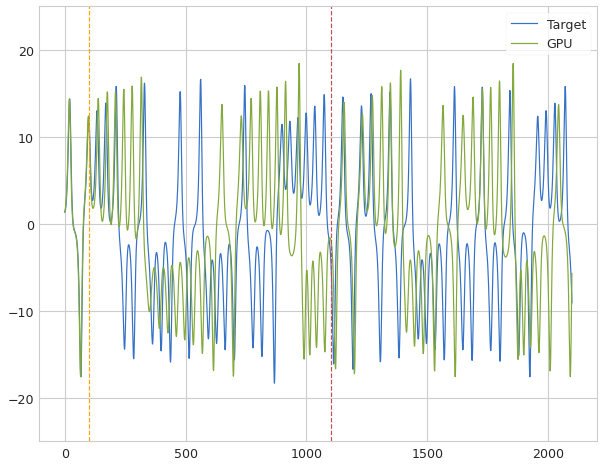

 Iter=5 a=0.639 sr=1.312 amp=1.000  ri=0.052 rr=2.346 loss=1.252735 nrmse=0.291018 CD 0.961717
Iter: 5 #### Time 4.37  NRMSE 0.291 CD 0.962
Iter: 6 #### Time 4.05  NRMSE 0.294 CD 1.024
Iter: 7 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.03  NRMSE 0.825 CD 0.922
Iter: 9 #### Time 4.05  NRMSE 0.899 CD 0.941
Iter: 10 #### Time 4.04  NRMSE 0.805 CD 0.967
Iter: 11 #### Time 4.03  NRMSE 0.507 CD 1.031
Iter: 12 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.09  NRMSE 0.453 CD 0.993
Iter: 14 #### Time 4.49  NRMSE 5.690 CD 1.002
Iter: 15 #### Time 4.06  NRMSE 0.760 CD 0.890
Iter: 16 #### Time 4.08  NRMSE 0.350 CD 1.048
Iter: 17 #### Time 4.13  NRMSE 1000.000 CD nan
Dist 0.613950


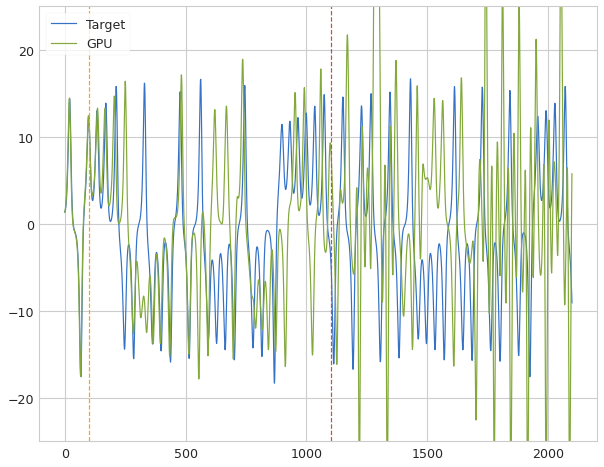

 Iter=18 a=0.799 sr=1.375 amp=1.000  ri=0.093 rr=2.555 loss=0.848645 nrmse=0.234695 CD 0.613950
Iter: 18 #### Time 4.25  NRMSE 0.235 CD 0.614
Iter: 19 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.05  NRMSE 0.311 CD 1.065
Iter: 21 #### Time 4.20  NRMSE 1.556 CD 1.133
Iter: 22 #### Time 4.34  NRMSE 2.731 CD 1.080
Iter: 23 #### Time 4.07  NRMSE 0.316 CD 1.063
Iter: 24 #### Time 4.06  NRMSE 0.281 CD 0.870
Iter: 25 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.09  NRMSE 0.322 CD 0.918
Iter: 27 #### Time 4.06  NRMSE 5.018 CD 0.999
Iter: 28 #### Time 4.28  NRMSE 3.291 CD 1.044
Iter: 29 #### Time 4.28  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 31 #### Time 4.12  NRMSE 0.954 CD 1.003
Iter: 32 #### Time 4.11  NRMSE 0.510 CD 1.007
Iter: 33 #### Time 4.11  NRMSE 0.280 CD 0.894
Iter: 34 #### Time 4.30  NRMSE 1000.000 CD nan
Iter: 35 #### Time 4.06  NRMSE 0.429 CD 1.023
Iter: 36 #### Time 4.13  NRMSE 16.096 CD 1.163
Iter: 37 #### Time 4.14 

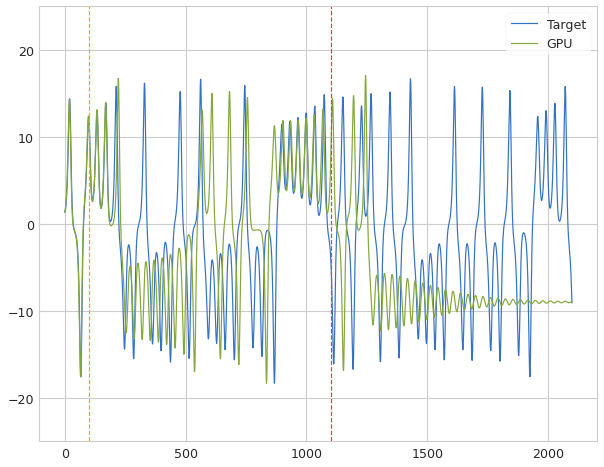

 Iter=146 a=0.570 sr=1.400 amp=1.000  ri=0.079 rr=2.940 loss=0.795844 nrmse=0.221597 CD 0.574248
Iter: 146 #### Time 4.35  NRMSE 0.222 CD 0.574
Iter: 147 #### Time 4.24  NRMSE 0.950 CD 0.872
Iter: 148 #### Time 4.10  NRMSE 0.311 CD 1.050
Iter: 149 #### Time 4.09  NRMSE 0.408 CD 1.070
End Run 4 Time 768.728

Best result = 0.7958441525464758
a = 0.5696328196022642
sr = 1.4
amp = 0.07924210098489441
ri = 2.939931727436919
********** Size 50 -- Run 4 ***********
Iter: 0 #### Time 4.16  NRMSE 0.320 CD 1.064
Iter: 1 #### Time 4.12  NRMSE 0.630 CD 0.981
Iter: 2 #### Time 4.24  NRMSE 7.739 CD 0.999
Dist 1.003299


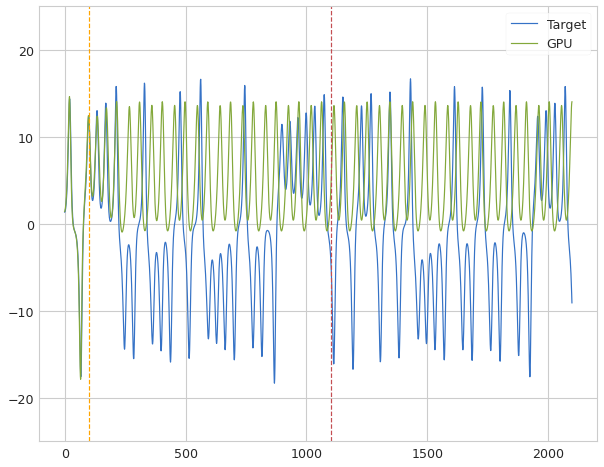

 Iter=3 a=0.540 sr=1.268 amp=1.000  ri=0.047 rr=2.527 loss=1.286322 nrmse=0.283023 CD 1.003299
Iter: 3 #### Time 4.18  NRMSE 0.283 CD 1.003
Iter: 4 #### Time 4.21  NRMSE 1000.000 CD nan
Dist 0.886330


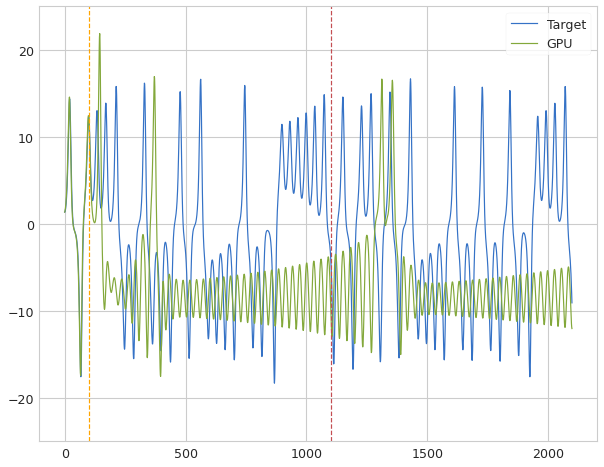

 Iter=5 a=0.560 sr=1.227 amp=1.000  ri=0.065 rr=2.763 loss=1.175819 nrmse=0.289489 CD 0.886330
Iter: 5 #### Time 4.28  NRMSE 0.289 CD 0.886
Iter: 6 #### Time 4.10  NRMSE 0.313 CD 1.055
Iter: 7 #### Time 4.07  NRMSE 0.320 CD 1.061
Iter: 8 #### Time 4.10  NRMSE 2.054 CD 1.002
Iter: 9 #### Time 4.11  NRMSE 0.289 CD 0.957
Iter: 10 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.03  NRMSE 0.332 CD 0.835
Iter: 12 #### Time 4.17  NRMSE 5.187 CD 1.081
Iter: 13 #### Time 4.13  NRMSE 0.285 CD 1.028
Iter: 14 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.19  NRMSE 2.992 CD 0.928
Iter: 16 #### Time 4.12  NRMSE 0.334 CD 1.076
Iter: 17 #### Time 4.31  NRMSE 0.321 CD 1.052
Iter: 18 #### Time 4.06  NRMSE 2.862 CD 1.025
Iter: 19 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.26  NRMSE 0.325 CD 1.242
Iter: 21 #### Time 4.14  NRMSE 0.381 CD 1.041
Iter: 22 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 23 #### Time 4.13  NRMSE 0.312 CD 0.886
Iter: 24 #### Time 4.15  NRMSE 1

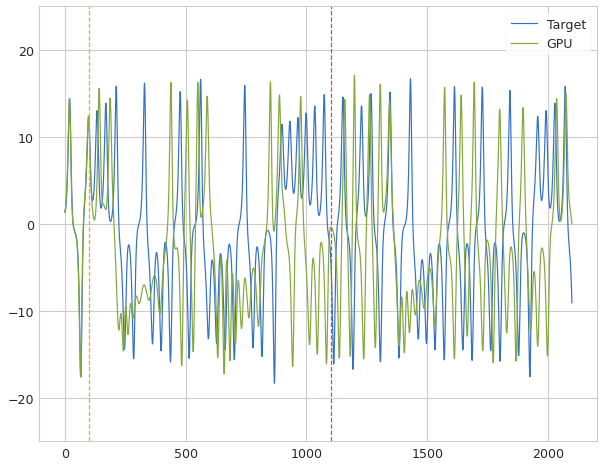

 Iter=38 a=0.534 sr=1.368 amp=1.000  ri=0.012 rr=2.543 loss=1.139875 nrmse=0.282019 CD 0.857856
Iter: 38 #### Time 4.20  NRMSE 0.282 CD 0.858
Iter: 39 #### Time 4.05  NRMSE 0.808 CD 0.986
Iter: 40 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 41 #### Time 4.10  NRMSE 0.306 CD 1.055
Iter: 42 #### Time 4.05  NRMSE 0.320 CD 1.134
Iter: 43 #### Time 4.11  NRMSE 0.311 CD 1.050
Iter: 44 #### Time 4.18  NRMSE 0.313 CD 1.057
Iter: 45 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 46 #### Time 4.09  NRMSE 0.387 CD 1.093
Iter: 47 #### Time 4.06  NRMSE 0.313 CD 1.061
Iter: 48 #### Time 4.06  NRMSE 1.411 CD 0.957
Iter: 49 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 50 #### Time 4.05  NRMSE 0.328 CD 0.992
Iter: 51 #### Time 4.06  NRMSE 0.305 CD 1.074
Iter: 52 #### Time 4.21  NRMSE 0.335 CD 1.106
Iter: 53 #### Time 4.30  NRMSE 2.291 CD 1.135
Iter: 54 #### Time 4.06  NRMSE 1.443 CD 1.096
Iter: 55 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 56 #### Time 4.16  NRMSE 1.405 CD 1.095
Iter: 57 #### Time 4.16  N

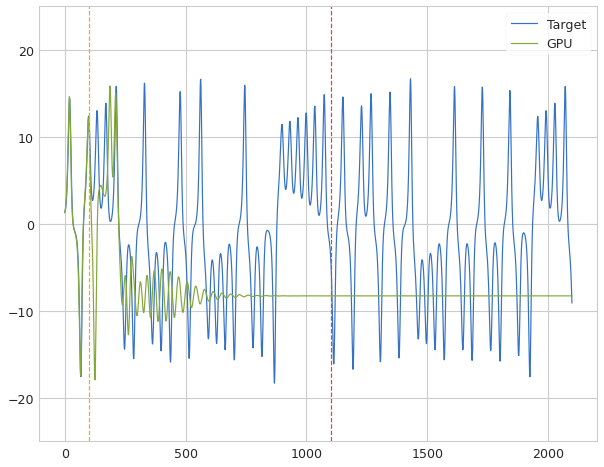

 Iter=59 a=0.590 sr=1.258 amp=1.000  ri=0.052 rr=2.488 loss=1.092293 nrmse=0.273072 CD 0.819221
Iter: 59 #### Time 4.81  NRMSE 0.273 CD 0.819
Iter: 60 #### Time 4.44  NRMSE 1000.000 CD nan
Iter: 61 #### Time 4.35  NRMSE 0.278 CD 1.164
Iter: 62 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 63 #### Time 4.27  NRMSE 0.298 CD 0.948
Iter: 64 #### Time 4.37  NRMSE 1000.000 CD nan
Iter: 65 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 66 #### Time 4.06  NRMSE 1.748 CD 1.058
Iter: 67 #### Time 4.09  NRMSE 0.420 CD 0.965
Iter: 68 #### Time 4.07  NRMSE 0.236 CD 0.907
Iter: 69 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 70 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 71 #### Time 4.11  NRMSE 1.390 CD 0.914
Iter: 72 #### Time 4.14  NRMSE 0.327 CD 1.064
Iter: 73 #### Time 4.00  NRMSE 1.219 CD 1.005
Iter: 74 #### Time 4.05  NRMSE 3.555 CD 1.138
Iter: 75 #### Time 4.07  NRMSE 2.432 CD 0.998
Iter: 76 #### Time 4.03  NRMSE 1.195 CD 0.914
Dist 0.857625


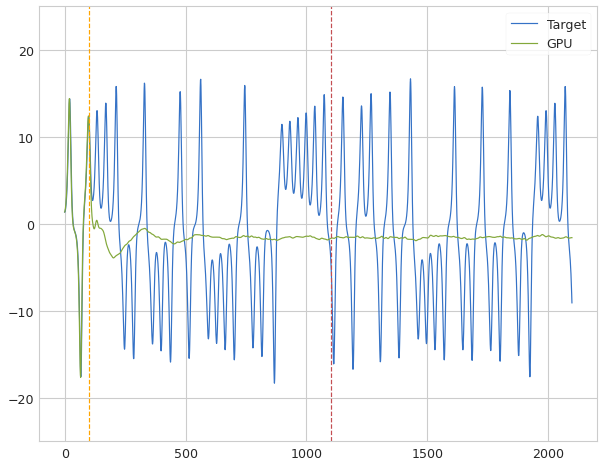

 Iter=77 a=0.688 sr=1.226 amp=1.000  ri=0.002 rr=2.740 loss=1.064597 nrmse=0.206972 CD 0.857625
Iter: 77 #### Time 4.16  NRMSE 0.207 CD 0.858
Iter: 78 #### Time 4.07  NRMSE 2.263 CD 1.082
Iter: 79 #### Time 4.16  NRMSE 0.303 CD 1.018
Iter: 80 #### Time 4.08  NRMSE 0.329 CD 1.180
Iter: 81 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 82 #### Time 4.11  NRMSE 0.267 CD 0.840
Iter: 83 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 84 #### Time 4.09  NRMSE 0.451 CD 0.910
Iter: 85 #### Time 4.14  NRMSE 0.295 CD 1.006
Iter: 86 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 87 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 88 #### Time 4.07  NRMSE 1.228 CD 0.992
Iter: 89 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 90 #### Time 4.26  NRMSE 0.241 CD 0.980
Iter: 91 #### Time 4.17  NRMSE 0.311 CD 1.060
Iter: 92 #### Time 4.03  NRMSE 0.385 CD 0.910
Iter: 93 #### Time 4.08  NRMSE 0.397 CD 1.062
Iter: 94 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 95 #### Time 4.24  NRMSE 1.206 CD 0.943
Iter: 96 #### Time 4.02 

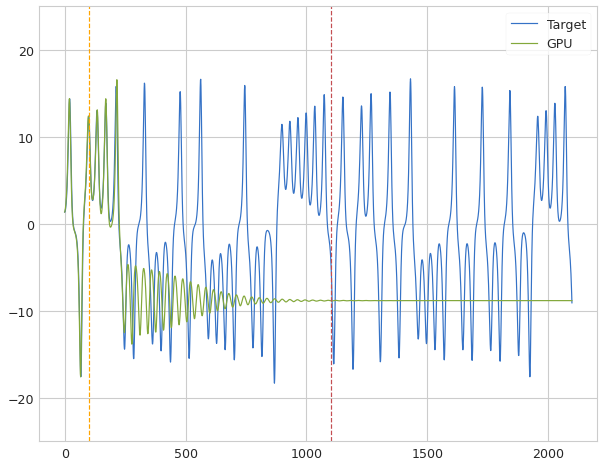

 Iter=118 a=0.569 sr=1.269 amp=1.000  ri=0.066 rr=2.852 loss=0.996990 nrmse=0.264120 CD 0.732870
Iter: 118 #### Time 4.16  NRMSE 0.264 CD 0.733
Iter: 119 #### Time 4.07  NRMSE 0.490 CD 0.921
Iter: 120 #### Time 4.16  NRMSE 0.293 CD 1.005
Iter: 121 #### Time 4.07  NRMSE 0.980 CD 1.146
Iter: 122 #### Time 4.11  NRMSE 0.950 CD 1.007
Iter: 123 #### Time 4.22  NRMSE 0.599 CD 0.949
Iter: 124 #### Time 4.39  NRMSE 0.300 CD 0.951
Iter: 125 #### Time 4.08  NRMSE 0.308 CD 1.059
Iter: 126 #### Time 4.07  NRMSE 0.321 CD 1.039
Iter: 127 #### Time 4.29  NRMSE 0.277 CD 0.756
Iter: 128 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 129 #### Time 4.16  NRMSE 0.285 CD 0.948
Iter: 130 #### Time 4.11  NRMSE 0.349 CD 1.065
Iter: 131 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 132 #### Time 4.35  NRMSE 0.266 CD 0.819
Iter: 133 #### Time 4.29  NRMSE 0.300 CD 0.786
Iter: 134 #### Time 4.12  NRMSE 0.290 CD 0.947
Iter: 135 #### Time 4.06  NRMSE 3.720 CD 1.139
Iter: 136 #### Time 4.07  NRMSE 0.374 CD 1.176
Iter: 13

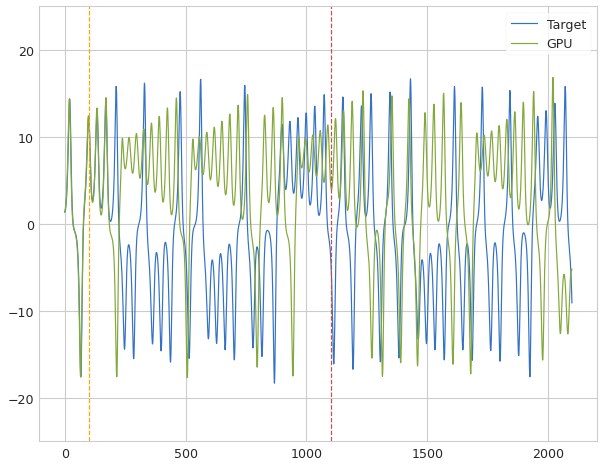

 Iter=4 a=0.888 sr=1.398 amp=1.000  ri=0.078 rr=2.025 loss=1.343458 nrmse=0.299109 CD 1.044349
Iter: 4 #### Time 5.05  NRMSE 0.299 CD 1.044
Iter: 5 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.05  NRMSE 0.337 CD 1.068
Iter: 7 #### Time 4.05  NRMSE 1.748 CD 0.999
Iter: 8 #### Time 4.00  NRMSE 1.471 CD 0.990
Iter: 9 #### Time 4.15  NRMSE 1.793 CD 0.997
Iter: 10 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.27  NRMSE 0.325 CD 1.051
Iter: 12 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.12  NRMSE 0.338 CD 1.116
Iter: 14 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.08  NRMSE 0.296 CD 1.049
Dist 0.731442


New N best!!!!!!!!!!!!


[40, 0, 0, 16]


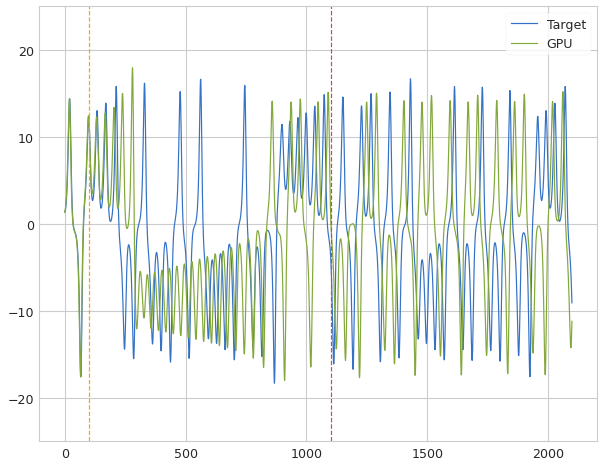

 Iter=16 a=0.563 sr=1.211 amp=1.000  ri=0.065 rr=2.040 loss=0.989960 nrmse=0.258518 CD 0.731442
Iter: 16 #### Time 5.08  NRMSE 0.259 CD 0.731
Iter: 17 #### Time 4.08  NRMSE 2.667 CD 0.993
Iter: 18 #### Time 4.09  NRMSE 0.282 CD 0.797
Iter: 19 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.07  NRMSE 0.282 CD 0.876
Iter: 21 #### Time 4.07  NRMSE 1.459 CD 1.003
Iter: 22 #### Time 4.14  NRMSE 0.341 CD 0.809
Iter: 23 #### Time 4.23  NRMSE 0.279 CD 1.028
Iter: 24 #### Time 4.04  NRMSE 0.548 CD 1.037
Iter: 25 #### Time 4.02  NRMSE 0.298 CD 1.051
Iter: 26 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 27 #### Time 4.06  NRMSE 0.313 CD 1.065
Iter: 28 #### Time 4.11  NRMSE 1.344 CD 0.834
Iter: 29 #### Time 4.10  NRMSE 0.338 CD 0.943
Iter: 30 #### Time 4.08  NRMSE 1.043 CD 1.017
Iter: 31 #### Time 4.14  NRMSE 0.287 CD 0.922
Iter: 32 #### Time 4.17  NRMSE 0.314 CD 1.047
Iter: 33 #### Time 4.00  NRMSE 1000.000 CD nan
Iter: 34 #### Time 4.07  NRMSE 0.319 CD 1.066
Iter: 35 #### Time 4.04  NR

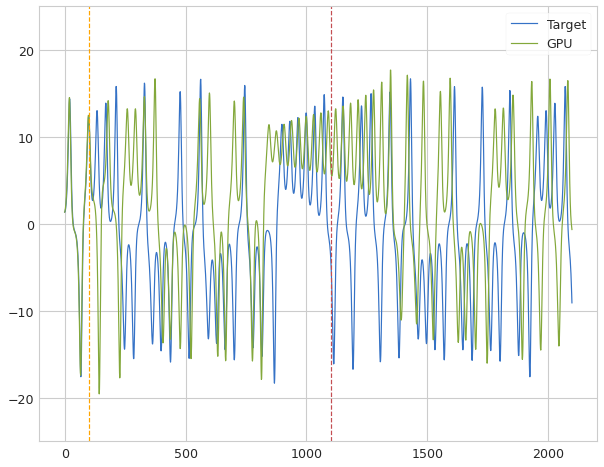

 Iter=86 a=0.612 sr=1.283 amp=1.000  ri=0.064 rr=2.152 loss=0.947267 nrmse=0.252679 CD 0.694588
Iter: 86 #### Time 5.12  NRMSE 0.253 CD 0.695
Iter: 87 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 88 #### Time 4.19  NRMSE 1000.000 CD nan
Iter: 89 #### Time 4.22  NRMSE 0.317 CD 0.957
Iter: 90 #### Time 4.15  NRMSE 0.307 CD 0.965
Iter: 91 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 92 #### Time 4.40  NRMSE 0.344 CD 1.060
Iter: 93 #### Time 4.04  NRMSE 0.294 CD 1.007
Iter: 94 #### Time 4.30  NRMSE 0.926 CD 1.058
Iter: 95 #### Time 4.16  NRMSE 1.682 CD 1.002
Iter: 96 #### Time 4.29  NRMSE 1000.000 CD nan
Iter: 97 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 98 #### Time 4.21  NRMSE 0.312 CD 1.059
Iter: 99 #### Time 4.19  NRMSE 1000.000 CD nan
Iter: 100 #### Time 4.09  NRMSE 0.293 CD 0.783
Iter: 101 #### Time 4.12  NRMSE 0.320 CD 1.055
Iter: 102 #### Time 4.48  NRMSE 0.692 CD 0.977
Iter: 103 #### Time 4.13  NRMSE 0.289 CD 0.915
Iter: 104 #### Time 4.99  NRMSE 1000.000 CD nan
Iter: 105 #### Tim

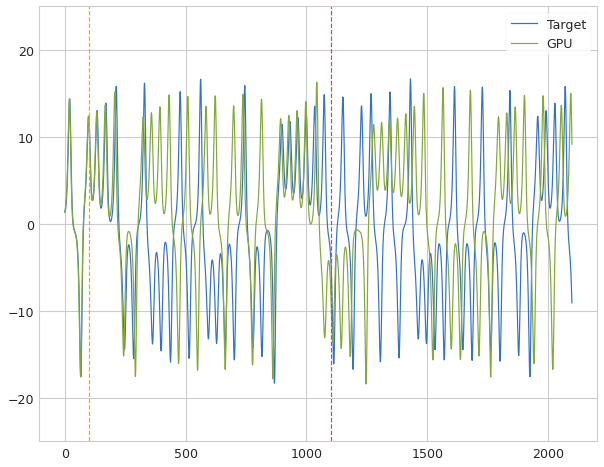

 Iter=2 a=0.552 sr=1.261 amp=1.000  ri=0.058 rr=2.578 loss=1.105953 nrmse=0.266488 CD 0.839465
Iter: 2 #### Time 4.26  NRMSE 0.266 CD 0.839
Iter: 3 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 4 #### Time 4.07  NRMSE 0.323 CD 1.089
Iter: 5 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.07  NRMSE 0.297 CD 0.982
Iter: 7 #### Time 4.03  NRMSE 1.055 CD 1.002
Iter: 8 #### Time 4.00  NRMSE 1000.000 CD nan
Iter: 9 #### Time 4.10  NRMSE 0.311 CD 1.098
Iter: 10 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.15  NRMSE 1.036 CD 0.994
Iter: 12 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.14  NRMSE 0.410 CD 1.030
Iter: 14 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.08  NRMSE 0.274 CD 0.869
Iter: 17 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.08  NRM

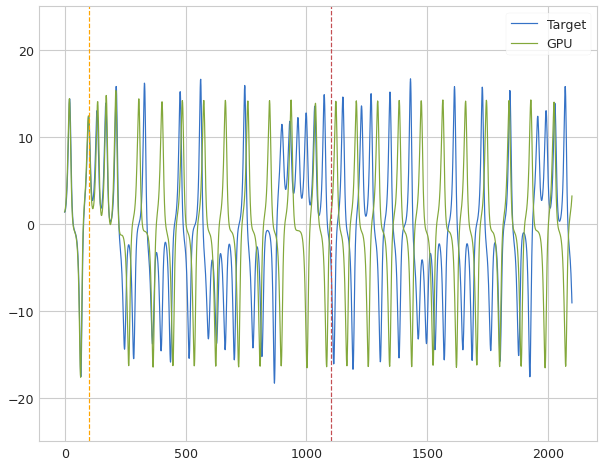

 Iter=39 a=0.504 sr=1.319 amp=1.000  ri=0.007 rr=2.223 loss=1.024800 nrmse=0.249597 CD 0.775203
Iter: 39 #### Time 4.33  NRMSE 0.250 CD 0.775
Iter: 40 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 41 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 42 #### Time 4.29  NRMSE 0.306 CD 1.029
Iter: 43 #### Time 4.07  NRMSE 0.302 CD 0.970
Iter: 44 #### Time 4.10  NRMSE 0.341 CD 1.069
Iter: 45 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 46 #### Time 4.04  NRMSE 0.300 CD 1.061
Iter: 47 #### Time 4.29  NRMSE 1000.000 CD nan
Iter: 48 #### Time 4.03  NRMSE 0.828 CD 0.955
Iter: 49 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 50 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 51 #### Time 4.09  NRMSE 0.266 CD 0.816
Iter: 52 #### Time 4.07  NRMSE 0.276 CD 0.900
Iter: 53 #### Time 4.08  NRMSE 0.280 CD 0.810
Iter: 54 #### Time 4.06  NRMSE 0.316 CD 0.914
Iter: 55 #### Time 4.09  NRMSE 0.328 CD 1.082
Iter: 56 #### Time 4.10  NRMSE 0.716 CD 0.969
Iter: 57 #### Time 4.14  NRMSE 0.301 CD 1.054
Iter: 58 #### Time 4.08 

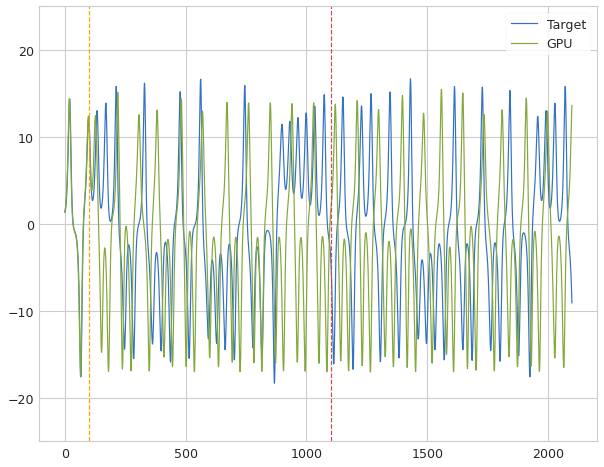

 Iter=77 a=0.856 sr=1.387 amp=1.000  ri=0.071 rr=2.701 loss=1.002653 nrmse=0.264654 CD 0.737999
Iter: 77 #### Time 4.19  NRMSE 0.265 CD 0.738
Iter: 78 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 79 #### Time 4.10  NRMSE 0.333 CD 1.050
Iter: 80 #### Time 4.25  NRMSE 2.213 CD 0.999
Iter: 81 #### Time 4.12  NRMSE 2.281 CD 0.988
Iter: 82 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 83 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 84 #### Time 4.07  NRMSE 0.310 CD 1.041
Dist 0.682748


New N best!!!!!!!!!!!!


[40, 0, 1, 85]


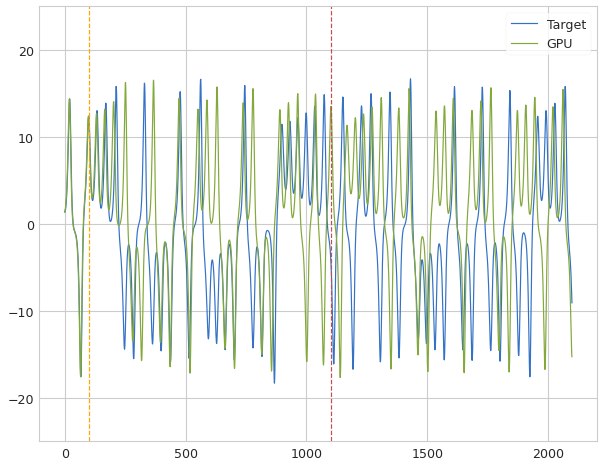

 Iter=85 a=0.554 sr=1.269 amp=1.000  ri=0.037 rr=2.311 loss=0.925092 nrmse=0.242345 CD 0.682748
Iter: 85 #### Time 5.12  NRMSE 0.242 CD 0.683
Iter: 86 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 87 #### Time 4.24  NRMSE 3.040 CD 1.141
Iter: 88 #### Time 4.37  NRMSE 0.334 CD 1.065
Iter: 89 #### Time 4.14  NRMSE 0.281 CD 0.913
Iter: 90 #### Time 4.39  NRMSE 2.781 CD 1.001
Iter: 91 #### Time 4.29  NRMSE 1.227 CD 0.976
Iter: 92 #### Time 4.18  NRMSE 1.317 CD 1.148
Iter: 93 #### Time 4.15  NRMSE 0.338 CD 1.042
Iter: 94 #### Time 4.02  NRMSE 0.421 CD 0.986
Iter: 95 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 96 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 97 #### Time 4.08  NRMSE 0.451 CD 1.102
Iter: 98 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 99 #### Time 4.47  NRMSE 1000.000 CD nan
Iter: 100 #### Time 4.09  NRMSE 0.330 CD 1.107
Iter: 101 #### Time 4.39  NRMSE 0.377 CD 0.937
Iter: 102 #### Time 4.26  NRMSE 0.717 CD 0.984
Iter: 103 #### Time 4.15  NRMSE 2.099 CD 1.005
Iter: 104 #### Time 4

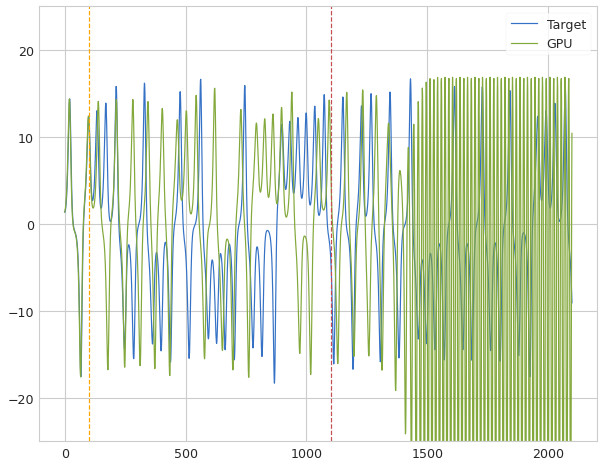

 Iter=3 a=0.586 sr=1.271 amp=1.000  ri=0.050 rr=2.913 loss=1.190671 nrmse=0.282249 CD 0.908422
Iter: 3 #### Time 4.29  NRMSE 0.282 CD 0.908
Iter: 4 #### Time 4.62  NRMSE 1000.000 CD nan
Iter: 5 #### Time 4.16  NRMSE 11.190 CD 1.133
Iter: 6 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 7 #### Time 4.56  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.43  NRMSE 1000.000 CD nan
Iter: 9 #### Time 4.21  NRMSE 0.315 CD 1.054
Iter: 10 #### Time 4.20  NRMSE 0.331 CD 1.064
Iter: 11 #### Time 4.06  NRMSE 0.400 CD 1.152
Iter: 12 #### Time 4.13  NRMSE 0.995 CD 0.990
Iter: 13 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 14 #### Time 4.14  NRMSE 0.304 CD 1.051
Iter: 15 #### Time 4.02  NRMSE 0.638 CD 1.058
Iter: 16 #### Time 4.15  NRMSE 0.346 CD 1.067
Iter: 17 #### Time 4.10  NRMSE 0.278 CD 1.035
Iter: 18 #### Time 4.18  NRMSE 3.048 CD 0.896
Iter: 19 #### Time 4.05  NRMSE 0.288 CD 0.948
Iter: 20 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.27  NRMSE

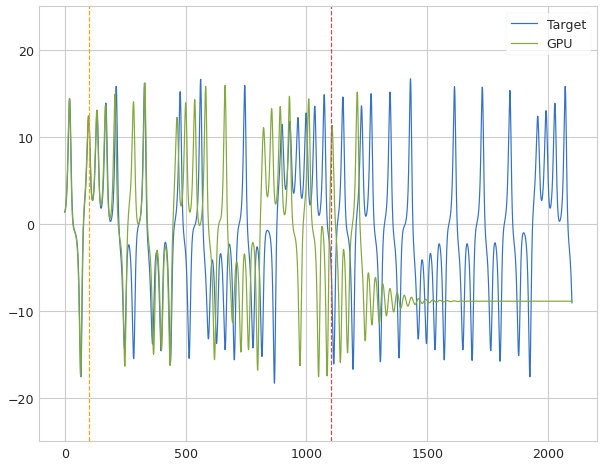

 Iter=23 a=0.640 sr=1.355 amp=1.000  ri=0.090 rr=2.786 loss=0.986370 nrmse=0.252702 CD 0.733667
Iter: 23 #### Time 4.20  NRMSE 0.253 CD 0.734
Iter: 24 #### Time 4.08  NRMSE 0.421 CD 0.991
Iter: 25 #### Time 4.11  NRMSE 0.310 CD 1.023
Iter: 26 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 27 #### Time 4.15  NRMSE 0.625 CD 0.969
Iter: 28 #### Time 4.15  NRMSE 1.170 CD 0.966
Iter: 29 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.14  NRMSE 0.305 CD 1.035
Iter: 31 #### Time 4.20  NRMSE 0.336 CD 1.072
Iter: 32 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 33 #### Time 4.13  NRMSE 0.325 CD 1.153
Iter: 34 #### Time 4.09  NRMSE 2.483 CD 0.877
Iter: 35 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 36 #### Time 4.11  NRMSE 0.326 CD 1.068
Iter: 37 #### Time 4.20  NRMSE 0.277 CD 0.886
Iter: 38 #### Time 4.14  NRMSE 0.781 CD 1.006
Iter: 39 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 40 #### Time 4.19  NRMSE 0.707 CD 1.087
Iter: 41 #### Time 4.24  NRMSE 0.315 CD 1.070
Iter: 42 #### Time 4.12  

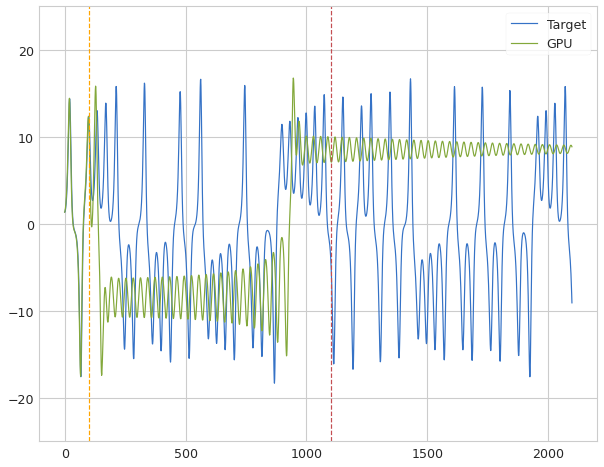

 Iter=133 a=0.867 sr=1.242 amp=1.000  ri=0.078 rr=3.000 loss=0.864601 nrmse=0.243839 CD 0.620762
Iter: 133 #### Time 5.28  NRMSE 0.244 CD 0.621
Iter: 134 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 135 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 136 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 137 #### Time 4.50  NRMSE 0.626 CD 1.014
Iter: 138 #### Time 4.22  NRMSE 0.534 CD 0.980
Dist 0.557114


New N best!!!!!!!!!!!!


[40, 0, 2, 139]


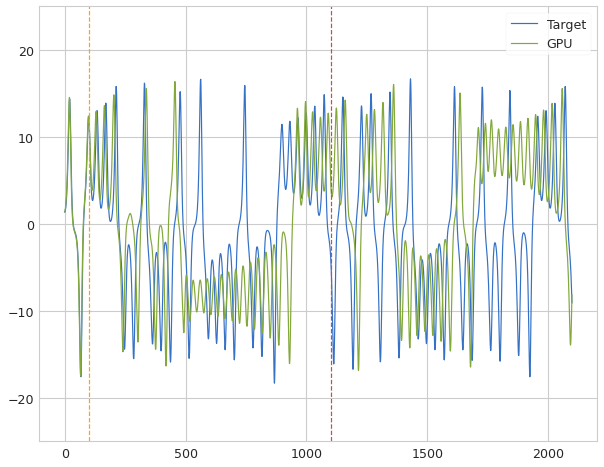

 Iter=139 a=0.591 sr=1.400 amp=1.000  ri=0.091 rr=3.000 loss=0.778086 nrmse=0.220972 CD 0.557114
Iter: 139 #### Time 5.37  NRMSE 0.221 CD 0.557
Iter: 140 #### Time 4.11  NRMSE 0.447 CD 0.980
Iter: 141 #### Time 4.31  NRMSE 0.785 CD 1.020
Iter: 142 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 143 #### Time 4.31  NRMSE 0.819 CD 0.996
Iter: 144 #### Time 4.07  NRMSE 0.350 CD 1.077
Iter: 145 #### Time 4.26  NRMSE 1.005 CD 1.049
Iter: 146 #### Time 4.11  NRMSE 0.310 CD 1.057
Iter: 147 #### Time 4.11  NRMSE 0.283 CD 0.856
Iter: 148 #### Time 4.29  NRMSE 1.524 CD 0.972
Iter: 149 #### Time 4.09  NRMSE 2.593 CD 1.076
End Run 0 Time 781.557

Best result = 0.7780860066309961
a = 0.590871658621732
sr = 1.4
amp = 0.09142134388152642
ri = 3.0
********** Size 40 -- Run 3 ***********
Iter: 0 #### Time 4.19  NRMSE 392.658 CD 0.850
Dist 0.977284


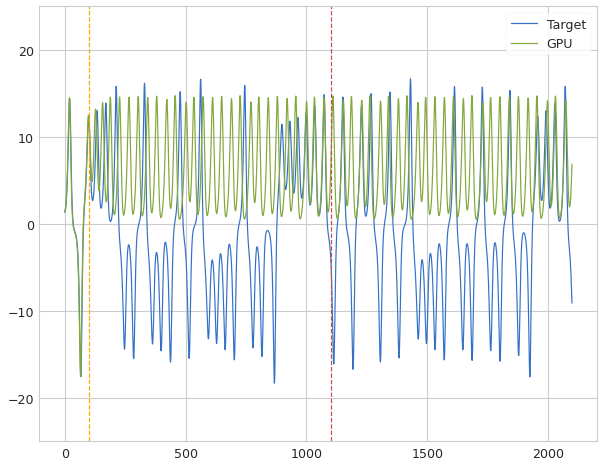

 Iter=1 a=0.704 sr=1.357 amp=1.000  ri=0.048 rr=2.619 loss=1.268692 nrmse=0.291407 CD 0.977284
Iter: 1 #### Time 4.32  NRMSE 0.291 CD 0.977
Iter: 2 #### Time 4.23  NRMSE 0.299 CD 1.091
Iter: 3 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 4 #### Time 4.15  NRMSE 0.328 CD 1.069
Iter: 5 #### Time 4.46  NRMSE 0.315 CD 1.059
Dist 0.711906


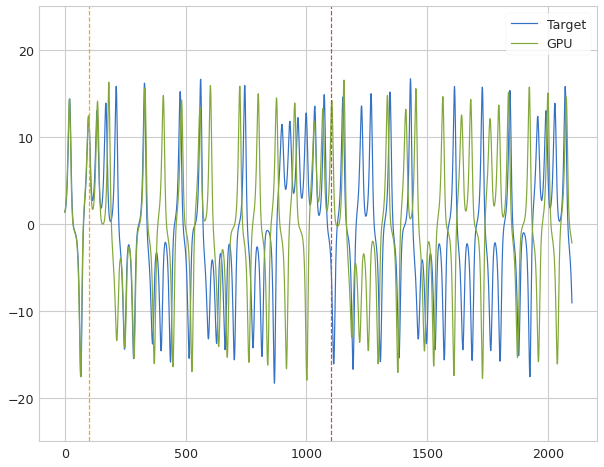

 Iter=6 a=0.638 sr=1.389 amp=1.000  ri=0.092 rr=2.953 loss=0.958391 nrmse=0.246484 CD 0.711906
Iter: 6 #### Time 4.95  NRMSE 0.246 CD 0.712
Iter: 7 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.19  NRMSE 0.417 CD 0.989
Iter: 9 #### Time 4.08  NRMSE 0.592 CD 1.113
Iter: 10 #### Time 4.12  NRMSE 1.638 CD 0.993
Iter: 11 #### Time 4.45  NRMSE 0.281 CD 0.915
Iter: 12 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.07  NRMSE 0.324 CD 0.881
Iter: 14 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.05  NRMSE 0.297 CD 1.051
Iter: 16 #### Time 4.10  NRMSE 0.329 CD 1.071
Iter: 17 #### Time 4.07  NRMSE 0.513 CD 1.386
Iter: 18 #### Time 4.05  NRMSE 0.304 CD 1.007
Iter: 19 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.12  NRMSE 0.301 CD 1.068
Iter: 21 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.37  NRMSE 0.346 CD 1.077
Iter: 23 #### Time 4.14  NRMSE 0.321 CD 1.168
Iter: 24 #### Time 4.13  NRMSE 0.354 CD 1.001
Iter: 25 #### Time 4.38  NRMSE

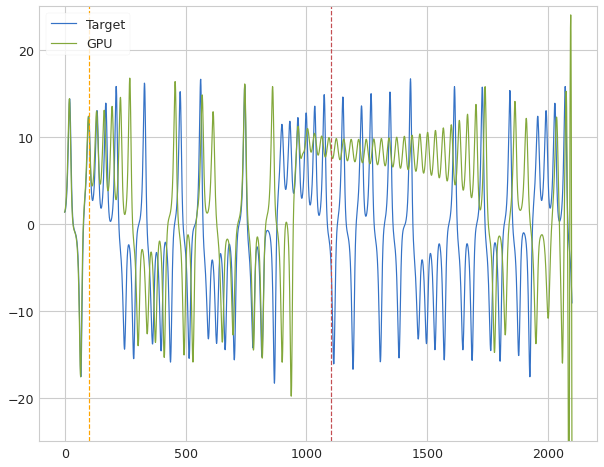

 Iter=111 a=0.706 sr=1.220 amp=1.000  ri=0.061 rr=2.566 loss=0.919418 nrmse=0.244128 CD 0.675290
Iter: 111 #### Time 4.62  NRMSE 0.244 CD 0.675
Iter: 112 #### Time 4.13  NRMSE 1.139 CD 1.006
Iter: 113 #### Time 4.35  NRMSE 1000.000 CD nan
Iter: 114 #### Time 4.29  NRMSE 4.256 CD 0.836
Iter: 115 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 116 #### Time 4.08  NRMSE 0.325 CD 1.014
Iter: 117 #### Time 4.07  NRMSE 0.630 CD 0.981
Iter: 118 #### Time 4.13  NRMSE 0.741 CD 1.006
Iter: 119 #### Time 4.07  NRMSE 0.286 CD 0.872
Iter: 120 #### Time 4.04  NRMSE 2.528 CD 1.001
Iter: 121 #### Time 4.06  NRMSE 0.346 CD 1.088
Iter: 122 #### Time 4.03  NRMSE 0.567 CD 0.997
Iter: 123 #### Time 4.16  NRMSE 0.307 CD 0.888
Iter: 124 #### Time 4.33  NRMSE 3.565 CD 0.903
Iter: 125 #### Time 4.21  NRMSE 0.284 CD 0.946
Iter: 126 #### Time 4.04  NRMSE 0.333 CD 1.063
Iter: 127 #### Time 4.08  NRMSE 1.736 CD 1.013
Iter: 128 #### Time 4.08  NRMSE 1.719 CD 1.101
Iter: 129 #### Time 4.30  NRMSE 0.412 CD 1.045
Iter: 13

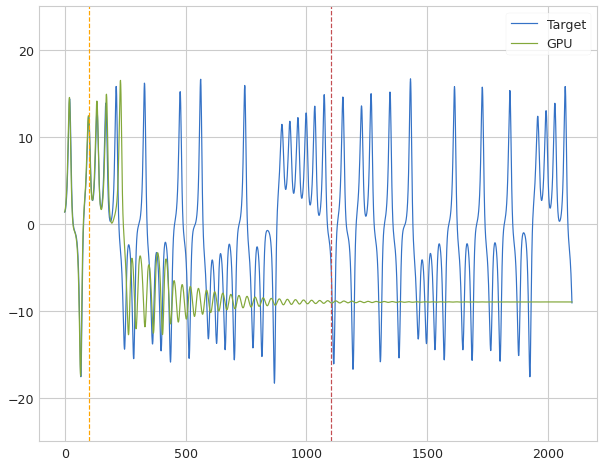

 Iter=7 a=0.528 sr=1.268 amp=1.000  ri=0.092 rr=2.247 loss=1.073745 nrmse=0.274744 CD 0.799000
Iter: 7 #### Time 4.21  NRMSE 0.275 CD 0.799
Iter: 8 #### Time 4.14  NRMSE 0.561 CD 0.941
Iter: 9 #### Time 4.13  NRMSE 1.226 CD 1.014
Iter: 10 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.05  NRMSE 0.322 CD 1.067
Iter: 12 #### Time 4.15  NRMSE 1000.000 CD nan
Dist 0.727653


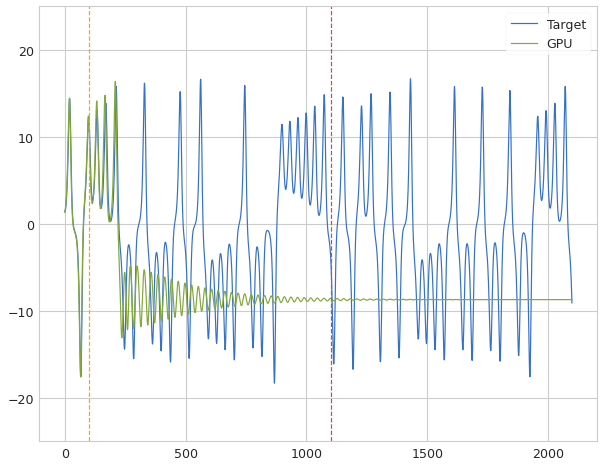

 Iter=13 a=0.635 sr=1.211 amp=1.000  ri=0.047 rr=2.236 loss=0.990125 nrmse=0.262471 CD 0.727653
Iter: 13 #### Time 4.19  NRMSE 0.262 CD 0.728
Iter: 14 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.04  NRMSE 1.069 CD 1.049
Iter: 16 #### Time 4.15  NRMSE 0.329 CD 1.075
Iter: 17 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.12  NRMSE 1.048 CD 0.996
Iter: 21 #### Time 4.12  NRMSE 0.265 CD 0.812
Iter: 22 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 23 #### Time 4.14  NRMSE 0.333 CD 0.959
Iter: 24 #### Time 4.06  NRMSE 1.124 CD 0.982
Iter: 25 #### Time 4.05  NRMSE 0.322 CD 1.031
Iter: 26 #### Time 4.10  NRMSE 0.337 CD 1.087
Iter: 27 #### Time 4.04  NRMSE 0.304 CD 0.862
Iter: 28 #### Time 4.12  NRMSE 0.278 CD 0.880
Iter: 29 #### Time 4.05  NRMSE 0.285 CD 0.948
Iter: 30 #### Time 4.07  NRMSE 0.324 CD 1.062
Iter: 31 #### Time 4.12  NRMSE 2.404 CD 1.013
Iter: 32 #### Time 4.17  

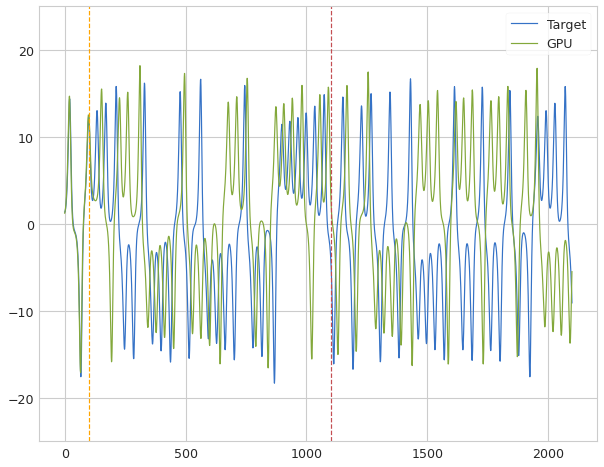

 Iter=1 a=0.542 sr=1.245 amp=1.000  ri=0.090 rr=2.826 loss=1.131731 nrmse=0.273412 CD 0.858319
Iter: 1 #### Time 4.26  NRMSE 0.273 CD 0.858
Iter: 2 #### Time 4.04  NRMSE 0.276 CD 0.869
Iter: 3 #### Time 4.09  NRMSE 0.326 CD 1.064
Iter: 4 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 5 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.07  NRMSE 0.407 CD 1.010
Iter: 7 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.06  NRMSE 3.675 CD 1.001
Iter: 9 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 10 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.05  NRMSE 0.387 CD 1.120
Iter: 12 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.09  NRMSE 0.648 CD 0.918
Iter: 14 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.04  NRMSE 0.308 CD 1.040
Iter: 16 #### Time 4.19  NRMSE 0.285 CD 0.870
Iter: 17 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.10  NRMSE

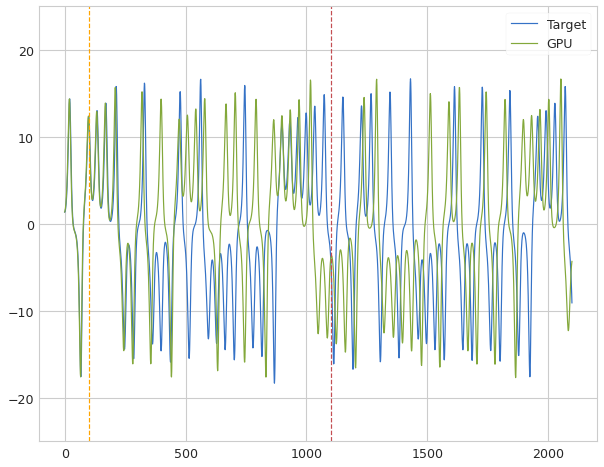

 Iter=21 a=0.664 sr=1.385 amp=1.000  ri=0.074 rr=2.319 loss=1.069696 nrmse=0.261696 CD 0.808000
Iter: 21 #### Time 4.21  NRMSE 0.262 CD 0.808
Iter: 22 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 23 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 24 #### Time 4.04  NRMSE 0.320 CD 1.065
Iter: 25 #### Time 4.13  NRMSE 0.320 CD 1.065
Iter: 26 #### Time 4.07  NRMSE 2.215 CD 0.988
Iter: 27 #### Time 4.06  NRMSE 1.598 CD 1.104
Iter: 28 #### Time 4.02  NRMSE 0.304 CD 1.059
Iter: 29 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.07  NRMSE 0.778 CD 1.028
Iter: 31 #### Time 4.20  NRMSE 1000.000 CD nan
Iter: 32 #### Time 4.05  NRMSE 1.044 CD 1.017
Iter: 33 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 34 #### Time 3.99  NRMSE 0.338 CD 0.905
Iter: 35 #### Time 4.06  NRMSE 2.462 CD 1.117
Iter: 36 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 37 #### Time 4.09  NRMSE 0.333 CD 1.057
Dist 0.742427


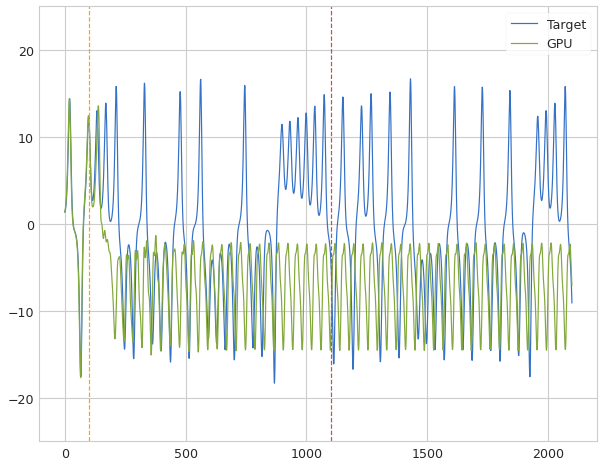

 Iter=38 a=0.528 sr=1.345 amp=1.000  ri=0.004 rr=2.407 loss=0.998884 nrmse=0.256457 CD 0.742427
Iter: 38 #### Time 4.15  NRMSE 0.256 CD 0.742
Iter: 39 #### Time 4.07  NRMSE 13.723 CD 1.089
Iter: 40 #### Time 4.06  NRMSE 1.794 CD 1.132
Iter: 41 #### Time 4.35  NRMSE 0.318 CD 1.057
Iter: 42 #### Time 4.11  NRMSE 0.277 CD 0.830
Iter: 43 #### Time 4.26  NRMSE 1000.000 CD nan
Iter: 44 #### Time 4.10  NRMSE 0.847 CD 1.020
Iter: 45 #### Time 4.11  NRMSE 0.300 CD 0.960
Iter: 46 #### Time 4.06  NRMSE 0.347 CD 0.952
Iter: 47 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 48 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 49 #### Time 4.06  NRMSE 0.321 CD 1.066
Iter: 50 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 51 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 52 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 53 #### Time 4.34  NRMSE 1000.000 CD nan
Iter: 54 #### Time 4.24  NRMSE 2.269 CD 1.003
Iter: 55 #### Time 4.13  NRMSE 0.331 CD 1.138
Iter: 56 #### Time 4.11  NRMSE 0.380 CD 1.018
Iter: 57 #### Time 4.0

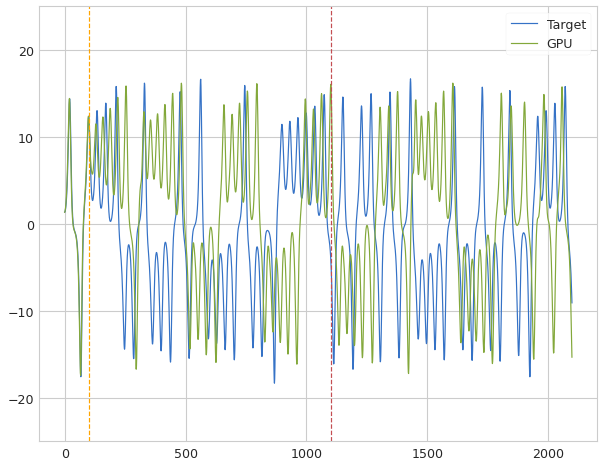

 Iter=9 a=0.618 sr=1.221 amp=1.000  ri=0.093 rr=2.833 loss=1.178853 nrmse=0.285493 CD 0.893361
Iter: 9 #### Time 4.25  NRMSE 0.285 CD 0.893
Iter: 10 #### Time 4.17  NRMSE 0.323 CD 1.062
Iter: 11 #### Time 4.15  NRMSE 0.572 CD 0.898
Iter: 12 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.00  NRMSE 1000.000 CD nan
Iter: 14 #### Time 4.06  NRMSE 0.342 CD 1.087
Iter: 15 #### Time 4.02  NRMSE 0.300 CD 1.031
Iter: 16 #### Time 4.08  NRMSE 0.404 CD 1.093
Dist 0.667713


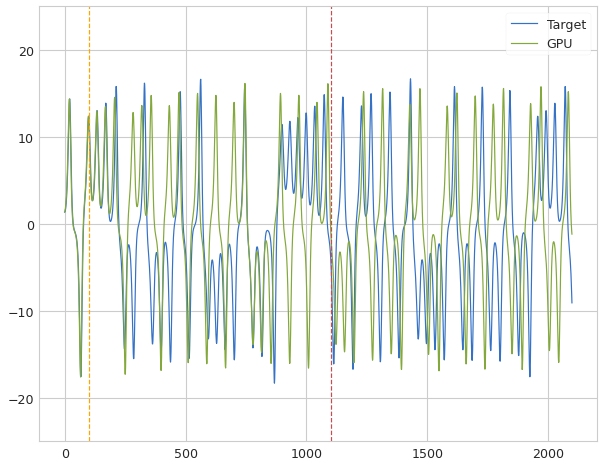

 Iter=17 a=0.702 sr=1.330 amp=1.000  ri=0.042 rr=2.172 loss=0.906814 nrmse=0.239100 CD 0.667713
Iter: 17 #### Time 4.21  NRMSE 0.239 CD 0.668
Iter: 18 #### Time 4.08  NRMSE 0.333 CD 0.891
Iter: 19 #### Time 4.16  NRMSE 0.269 CD 0.745
Iter: 20 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.05  NRMSE 0.857 CD 1.006
Iter: 23 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 24 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 25 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 27 #### Time 4.01  NRMSE 0.318 CD 1.061
Iter: 28 #### Time 4.05  NRMSE 6.104 CD 1.108
Iter: 29 #### Time 4.06  NRMSE 0.317 CD 0.958
Iter: 30 #### Time 4.08  NRMSE 1.399 CD 0.972
Iter: 31 #### Time 4.09  NRMSE 0.336 CD 1.063
Iter: 32 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 33 #### Time 4.06  NRMSE 0.327 CD 1.063
Iter: 34 #### Time 4.14  NRMSE 0.325 CD 0.892
Iter: 35 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 36 #### Time 4.0

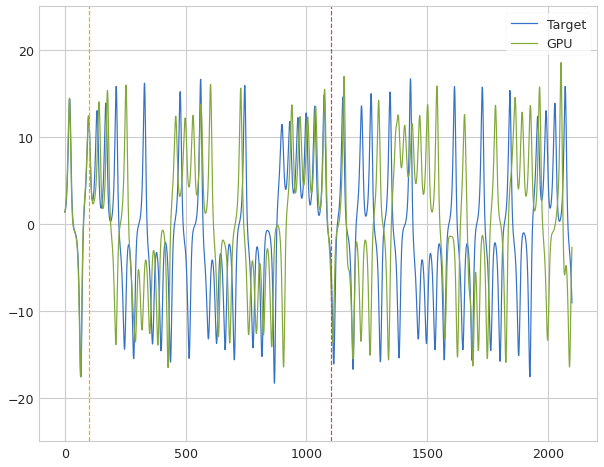

 Iter=100 a=0.500 sr=1.200 amp=1.000  ri=0.100 rr=2.000 loss=0.903941 nrmse=0.239765 CD 0.664176
Iter: 100 #### Time 4.20  NRMSE 0.240 CD 0.664
Iter: 101 #### Time 4.19  NRMSE 1000.000 CD nan
Iter: 102 #### Time 4.28  NRMSE 1000.000 CD nan
Iter: 103 #### Time 4.11  NRMSE 0.302 CD 0.969
Iter: 104 #### Time 4.23  NRMSE 3.647 CD 0.988
Iter: 105 #### Time 4.15  NRMSE 0.309 CD 1.038
Iter: 106 #### Time 4.18  NRMSE 0.889 CD 0.981
Iter: 107 #### Time 4.17  NRMSE 0.386 CD 1.064
Iter: 108 #### Time 4.36  NRMSE 0.274 CD 0.753
Iter: 109 #### Time 4.11  NRMSE 0.582 CD 1.138
Iter: 110 #### Time 4.57  NRMSE 1.883 CD 1.002
Iter: 111 #### Time 4.26  NRMSE 1000.000 CD nan
Iter: 112 #### Time 4.19  NRMSE 1.213 CD 1.004
Iter: 113 #### Time 4.25  NRMSE 1.468 CD 0.979
Iter: 114 #### Time 4.24  NRMSE 0.579 CD 1.034
Iter: 115 #### Time 4.11  NRMSE 0.483 CD 1.012
Iter: 116 #### Time 4.20  NRMSE 1.232 CD 0.970
Iter: 117 #### Time 4.17  NRMSE 0.556 CD 0.835
Iter: 118 #### Time 4.32  NRMSE 1000.000 CD nan
Iter: 

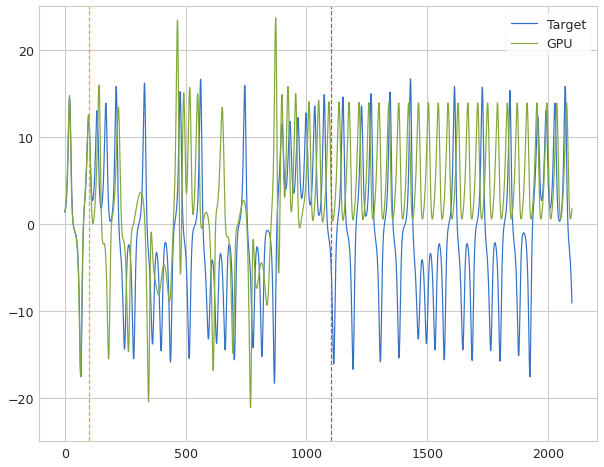

 Iter=3 a=0.586 sr=1.271 amp=1.000  ri=0.050 rr=2.913 loss=0.970896 nrmse=0.250309 CD 0.720587
Iter: 3 #### Time 4.18  NRMSE 0.250 CD 0.721
Iter: 4 #### Time 4.05  NRMSE 2.267 CD 1.003
Iter: 5 #### Time 4.35  NRMSE 1.137 CD 1.000
Iter: 6 #### Time 4.11  NRMSE 4.855 CD 1.105
Iter: 7 #### Time 4.33  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.11  NRMSE 2.039 CD 0.993
Iter: 9 #### Time 4.07  NRMSE 0.267 CD 1.094
Iter: 10 #### Time 4.19  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.03  NRMSE 0.653 CD 1.003
Iter: 12 #### Time 5.05  NRMSE 3.997 CD 1.094
Iter: 13 #### Time 4.08  NRMSE 1.548 CD 1.119
Iter: 14 #### Time 4.14  NRMSE 0.996 CD 0.994
Iter: 15 #### Time 4.12  NRMSE 1.901 CD 0.982
Iter: 16 #### Time 4.14  NRMSE 0.423 CD 1.084
Iter: 17 #### Time 4.10  NRMSE 0.892 CD 0.989
Iter: 18 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.08  NRMSE 0.310 CD 1.059
Iter: 20 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.20  NRMSE 0.

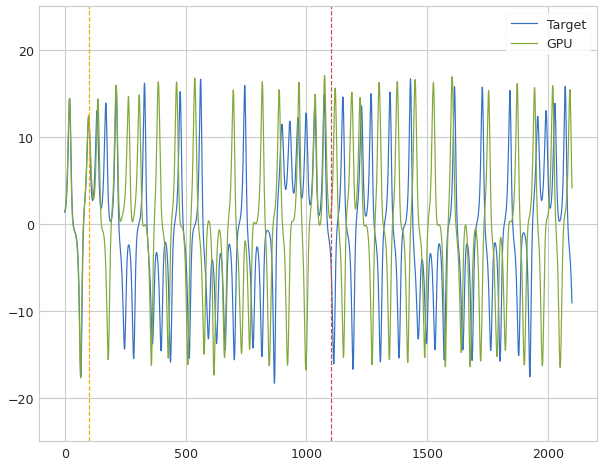

 Iter=6 a=0.638 sr=1.389 amp=1.000  ri=0.092 rr=2.953 loss=1.105569 nrmse=0.272675 CD 0.832894
Iter: 6 #### Time 4.18  NRMSE 0.273 CD 0.833
Iter: 7 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.08  NRMSE 0.299 CD 1.041
Iter: 9 #### Time 4.09  NRMSE 0.454 CD 0.846
Iter: 10 #### Time 4.14  NRMSE 0.947 CD 0.993
Iter: 11 #### Time 4.18  NRMSE 0.381 CD 0.831
Iter: 12 #### Time 4.11  NRMSE 2.697 CD 0.984
Iter: 13 #### Time 4.12  NRMSE 2.828 CD 1.079
Iter: 14 #### Time 4.17  NRMSE 1.146 CD 0.961
Dist 0.804790


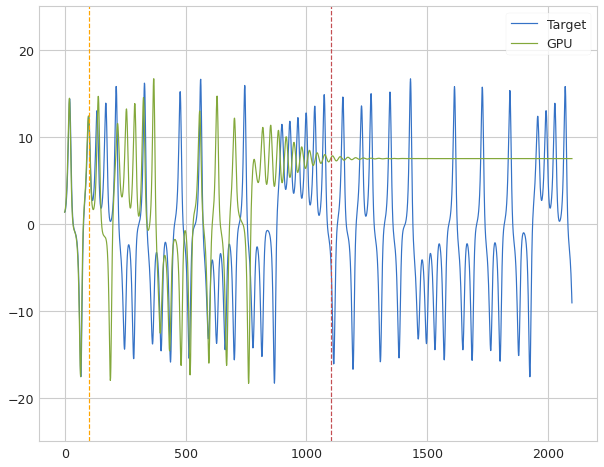

 Iter=15 a=0.673 sr=1.293 amp=1.000  ri=0.071 rr=2.038 loss=1.064978 nrmse=0.260188 CD 0.804790
Iter: 15 #### Time 4.33  NRMSE 0.260 CD 0.805
Iter: 16 #### Time 4.28  NRMSE 0.405 CD 1.035
Iter: 17 #### Time 4.28  NRMSE 0.370 CD 1.004
Iter: 18 #### Time 4.14  NRMSE 1.297 CD 0.996
Iter: 19 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.17  NRMSE 0.276 CD 0.864
Iter: 21 #### Time 4.29  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.09  NRMSE 0.318 CD 1.159
Iter: 23 #### Time 4.22  NRMSE 0.286 CD 0.956
Iter: 24 #### Time 4.37  NRMSE 0.323 CD 0.901
Iter: 25 #### Time 4.32  NRMSE 0.294 CD 0.908
Iter: 26 #### Time 4.07  NRMSE 11.200 CD 0.989
Iter: 27 #### Time 4.20  NRMSE 1000.000 CD nan
Iter: 28 #### Time 4.12  NRMSE 0.315 CD 1.070
Iter: 29 #### Time 4.08  NRMSE 1.247 CD 1.010
Iter: 30 #### Time 4.32  NRMSE 2.642 CD 1.007
Iter: 31 #### Time 4.20  NRMSE 0.300 CD 0.999
Iter: 32 #### Time 4.19  NRMSE 1.014 CD 1.021
Iter: 33 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 34 #### Time 4.10  

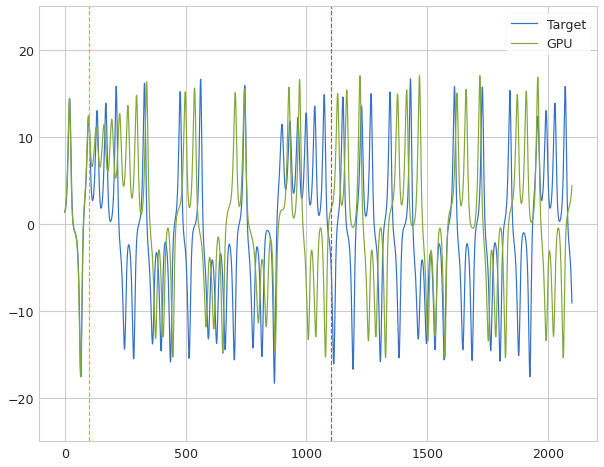

 Iter=46 a=0.880 sr=1.391 amp=1.000  ri=0.007 rr=2.297 loss=0.988601 nrmse=0.250431 CD 0.738170
Iter: 46 #### Time 4.26  NRMSE 0.250 CD 0.738
Iter: 47 #### Time 4.09  NRMSE 0.290 CD 1.067
Iter: 48 #### Time 4.03  NRMSE 0.292 CD 1.049
Iter: 49 #### Time 4.26  NRMSE 0.326 CD 1.065
Iter: 50 #### Time 4.19  NRMSE 0.323 CD 1.049
Iter: 51 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 52 #### Time 4.06  NRMSE 0.678 CD 0.968
Iter: 53 #### Time 4.09  NRMSE 0.328 CD 1.063
Iter: 54 #### Time 4.09  NRMSE 4.885 CD 0.993
Iter: 55 #### Time 4.13  NRMSE 2.549 CD 0.992
Iter: 56 #### Time 4.12  NRMSE 0.270 CD 0.849
Iter: 57 #### Time 4.26  NRMSE 1.750 CD 0.926
Iter: 58 #### Time 4.30  NRMSE 1000.000 CD nan
Iter: 59 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 60 #### Time 4.13  NRMSE 2.563 CD 1.002
Iter: 61 #### Time 4.25  NRMSE 5.498 CD 0.986
Iter: 62 #### Time 4.14  NRMSE 0.329 CD 0.996
Iter: 63 #### Time 4.14  NRMSE 2.079 CD 1.005
Iter: 64 #### Time 4.08  NRMSE 0.289 CD 0.948
Iter: 65 #### Time 4.12  NR

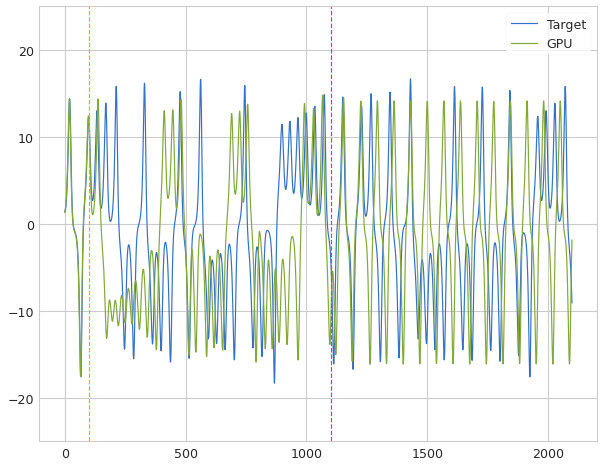

 Iter=1 a=0.683 sr=1.308 amp=1.000  ri=0.033 rr=2.750 loss=1.049203 nrmse=0.269750 CD 0.779454
Iter: 1 #### Time 4.24  NRMSE 0.270 CD 0.779
Iter: 2 #### Time 4.06  NRMSE 12.927 CD 1.159
Iter: 3 #### Time 4.14  NRMSE 0.300 CD 0.942
Iter: 4 #### Time 4.13  NRMSE 1.046 CD 0.989
Iter: 5 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.01  NRMSE 1.716 CD 0.983
Iter: 7 #### Time 4.03  NRMSE 0.307 CD 1.061
Iter: 8 #### Time 4.02  NRMSE 0.300 CD 1.045
Iter: 9 #### Time 4.02  NRMSE 0.407 CD 0.927
Iter: 10 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.04  NRMSE 0.297 CD 1.017
Iter: 12 #### Time 4.02  NRMSE 0.609 CD 1.046
Iter: 13 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 14 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.09  NRMSE 1.661 CD 1.088
Iter: 16 #### Time 4.10  NRMSE 0.292 CD 0.983
Iter: 17 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.06  NRMSE 0.268 CD 0.837
Iter: 19 #### Time 4.04  NRMSE 0.327 CD 1.081
Iter: 20 #### Time 4.06  NRMSE 1.9

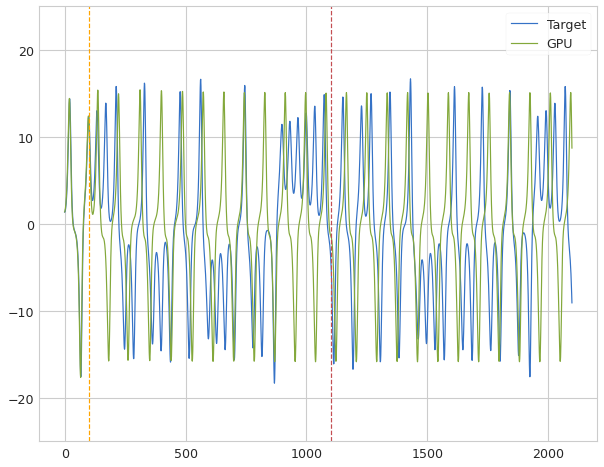

 Iter=39 a=0.601 sr=1.366 amp=1.000  ri=0.048 rr=2.260 loss=0.953601 nrmse=0.241515 CD 0.712086
Iter: 39 #### Time 4.20  NRMSE 0.242 CD 0.712
Iter: 40 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 41 #### Time 4.04  NRMSE 0.311 CD 1.020
Iter: 42 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 43 #### Time 4.10  NRMSE 0.328 CD 1.063
Iter: 44 #### Time 4.50  NRMSE 1000.000 CD nan
Iter: 45 #### Time 4.10  NRMSE 0.596 CD 0.914
Iter: 46 #### Time 4.06  NRMSE 0.288 CD 0.905
Iter: 47 #### Time 4.07  NRMSE 0.293 CD 0.934
Iter: 48 #### Time 4.04  NRMSE 0.551 CD 1.068
Iter: 49 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 50 #### Time 4.25  NRMSE 1000.000 CD nan
Iter: 51 #### Time 4.04  NRMSE 0.884 CD 1.029
Iter: 52 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 53 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 54 #### Time 4.09  NRMSE 2.191 CD 0.989
Iter: 55 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 56 #### Time 4.23  NRMSE 0.516 CD 0.973
Iter: 57 #### Time 4.21  NRMSE 0.306 CD 1.053
Iter: 58 #### Time 4.0

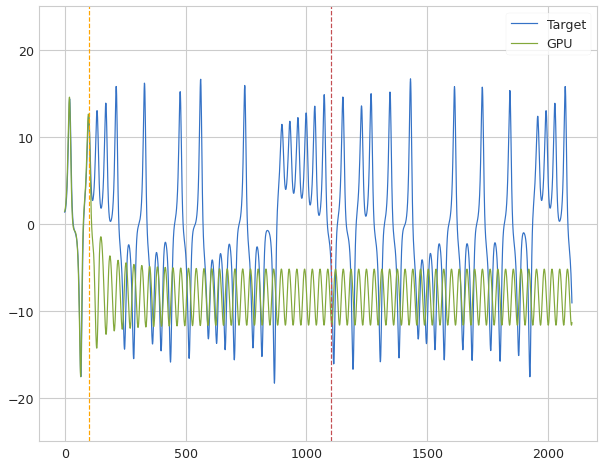

 Iter=2 a=0.537 sr=1.378 amp=1.000  ri=0.072 rr=2.518 loss=1.217991 nrmse=0.293610 CD 0.924381
Iter: 2 #### Time 4.21  NRMSE 0.294 CD 0.924
Iter: 3 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 4 #### Time 4.20  NRMSE 0.370 CD 0.928
Iter: 5 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 7 #### Time 4.04  NRMSE 2.068 CD 0.999
Iter: 8 #### Time 4.03  NRMSE 2.347 CD 0.903
Iter: 9 #### Time 4.04  NRMSE 0.306 CD 0.988
Iter: 10 #### Time 4.09  NRMSE 0.588 CD 1.111
Iter: 11 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 12 #### Time 4.13  NRMSE 0.294 CD 1.030
Iter: 13 #### Time 4.10  NRMSE 0.302 CD 0.941
Iter: 14 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.10  NRMSE 3.047 CD 1.109
Iter: 16 #### Time 4.07  NRMSE 0.365 CD 1.049
Iter: 17 #### Time 4.05  NRMSE 1.034 CD 1.025
Dist 0.932871


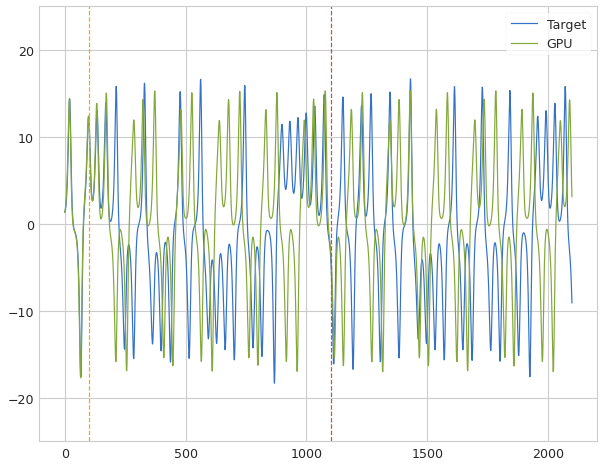

 Iter=18 a=0.610 sr=1.219 amp=1.000  ri=0.097 rr=2.090 loss=1.212703 nrmse=0.279832 CD 0.932871
Iter: 18 #### Time 4.20  NRMSE 0.280 CD 0.933
Iter: 19 #### Time 4.24  NRMSE 8.967 CD 0.966
Iter: 20 #### Time 4.11  NRMSE 0.289 CD 0.973
Iter: 21 #### Time 4.07  NRMSE 0.284 CD 0.935
Iter: 22 #### Time 4.08  NRMSE 6.119 CD 0.997
Iter: 23 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 24 #### Time 4.03  NRMSE 0.353 CD 1.058
Iter: 25 #### Time 4.04  NRMSE 0.866 CD 0.986
Iter: 26 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 27 #### Time 4.03  NRMSE 0.824 CD 0.985
Iter: 28 #### Time 4.05  NRMSE 0.525 CD 0.899
Dist 0.900563


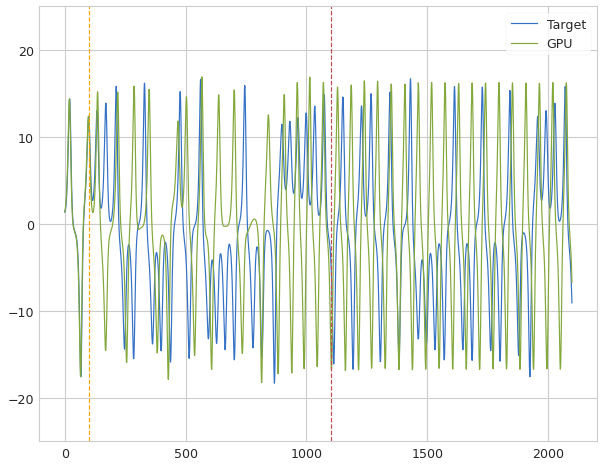

 Iter=29 a=0.779 sr=1.356 amp=1.000  ri=0.046 rr=2.646 loss=1.180239 nrmse=0.279676 CD 0.900563
Iter: 29 #### Time 4.19  NRMSE 0.280 CD 0.901
Iter: 30 #### Time 4.08  NRMSE 1.300 CD 0.988
Iter: 31 #### Time 4.06  NRMSE 0.315 CD 1.043
Iter: 32 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 33 #### Time 4.09  NRMSE 10.769 CD 0.860
Dist 0.815226


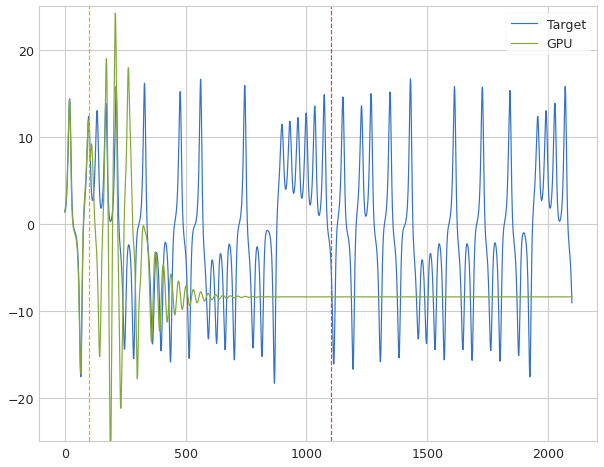

 Iter=34 a=0.665 sr=1.237 amp=1.000  ri=0.068 rr=2.491 loss=1.102256 nrmse=0.287030 CD 0.815226
Iter: 34 #### Time 4.22  NRMSE 0.287 CD 0.815
Iter: 35 #### Time 4.15  NRMSE 0.702 CD 0.977
Iter: 36 #### Time 4.09  NRMSE 0.961 CD 0.994
Iter: 37 #### Time 4.06  NRMSE 0.318 CD 1.061
Dist 0.822394


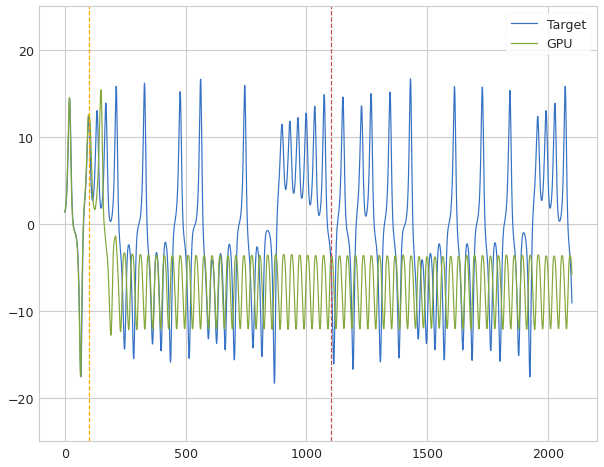

 Iter=38 a=0.528 sr=1.345 amp=1.000  ri=0.004 rr=2.407 loss=1.088264 nrmse=0.265870 CD 0.822394
Iter: 38 #### Time 4.28  NRMSE 0.266 CD 0.822
Iter: 39 #### Time 4.05  NRMSE 1.703 CD 1.065
Iter: 40 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 41 #### Time 4.06  NRMSE 0.349 CD 0.915
Iter: 42 #### Time 4.23  NRMSE 0.363 CD 1.114
Iter: 43 #### Time 4.09  NRMSE 0.267 CD 0.866
Iter: 44 #### Time 4.31  NRMSE 0.284 CD 0.935
Iter: 45 #### Time 4.11  NRMSE 0.321 CD 1.065
Iter: 46 #### Time 4.06  NRMSE 0.308 CD 0.927
Iter: 47 #### Time 4.09  NRMSE 0.326 CD 0.984
Iter: 48 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 49 #### Time 4.18  NRMSE 0.306 CD 1.059
Iter: 50 #### Time 4.07  NRMSE 0.333 CD 1.059
Iter: 51 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 52 #### Time 4.11  NRMSE 0.320 CD 1.207
Iter: 53 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 54 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 55 #### Time 4.08  NRMSE 0.299 CD 0.994
Iter: 56 #### Time 4.08  NRMSE 1.775 CD 0.946
Iter: 57 #### Time 4.09  

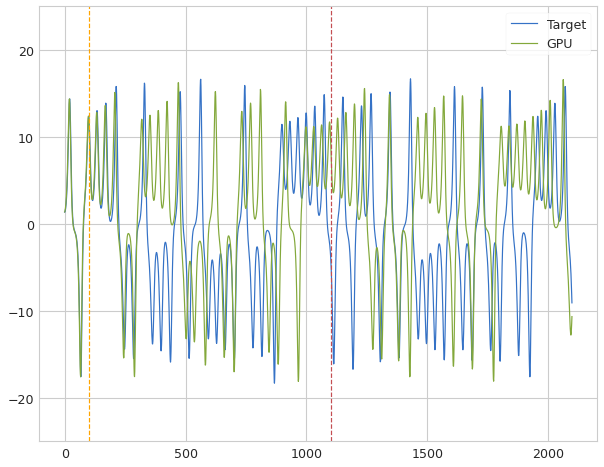

 Iter=68 a=0.627 sr=1.206 amp=1.000  ri=0.059 rr=2.976 loss=0.965906 nrmse=0.248335 CD 0.717571
Iter: 68 #### Time 4.26  NRMSE 0.248 CD 0.718
Iter: 69 #### Time 4.08  NRMSE 2.227 CD 0.999
Iter: 70 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 71 #### Time 4.20  NRMSE 0.322 CD 1.269
Iter: 72 #### Time 4.13  NRMSE 0.291 CD 1.000
Iter: 73 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 74 #### Time 4.12  NRMSE 0.277 CD 0.884
Iter: 75 #### Time 4.10  NRMSE 1.371 CD 1.100
Iter: 76 #### Time 4.21  NRMSE 1000.000 CD nan
Iter: 77 #### Time 4.31  NRMSE 1.225 CD 1.003
Iter: 78 #### Time 4.26  NRMSE 10.805 CD 1.109
Iter: 79 #### Time 4.19  NRMSE 1000.000 CD nan
Iter: 80 #### Time 4.05  NRMSE 0.317 CD 1.064
Iter: 81 #### Time 4.14  NRMSE 0.300 CD 1.054
Iter: 82 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 83 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 84 #### Time 4.07  NRMSE 2.497 CD 0.993
Iter: 85 #### Time 4.11  NRMSE 2.811 CD 1.031
Iter: 86 #### Time 4.12  NRMSE 0.283 CD 0.932
Iter: 87 #### Time 4.18

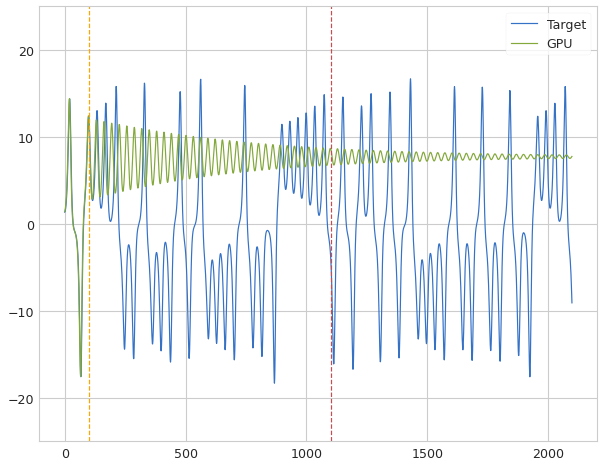

 Iter=17 a=0.702 sr=1.330 amp=1.000  ri=0.042 rr=2.172 loss=1.349090 nrmse=0.297575 CD 1.051515
Iter: 17 #### Time 4.25  NRMSE 0.298 CD 1.052
Iter: 18 #### Time 4.08  NRMSE 1.119 CD 1.075
Iter: 19 #### Time 3.98  NRMSE 0.331 CD 1.202
Iter: 20 #### Time 4.11  NRMSE 0.738 CD 0.972
Iter: 21 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.10  NRMSE 1.630 CD 1.012
Iter: 23 #### Time 4.07  NRMSE 1.969 CD 0.895
Iter: 24 #### Time 4.08  NRMSE 0.923 CD 1.000
Iter: 25 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.00  NRMSE 0.622 CD 1.140
Iter: 27 #### Time 4.08  NRMSE 1.534 CD 0.994
Iter: 28 #### Time 4.31  NRMSE 1000.000 CD nan
Iter: 29 #### Time 4.11  NRMSE 4.508 CD 1.099
Iter: 30 #### Time 4.06  NRMSE 0.323 CD 1.059
Iter: 31 #### Time 4.08  NRMSE 1000.000 CD nan
Dist 1.058701


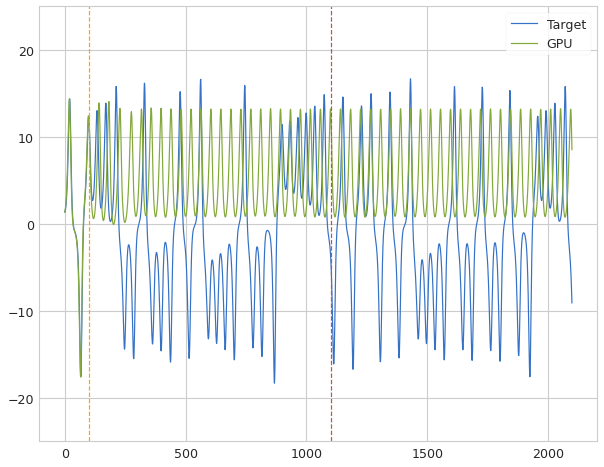

 Iter=32 a=0.676 sr=1.204 amp=1.000  ri=0.008 rr=2.236 loss=1.342542 nrmse=0.283840 CD 1.058701
Iter: 32 #### Time 4.24  NRMSE 0.284 CD 1.059
Iter: 33 #### Time 4.35  NRMSE 0.370 CD 0.953
Iter: 34 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 35 #### Time 4.22  NRMSE 1000.000 CD nan
Iter: 36 #### Time 4.05  NRMSE 0.308 CD 0.906
Iter: 37 #### Time 4.08  NRMSE 0.757 CD 1.116
Iter: 38 #### Time 4.07  NRMSE 1.065 CD 0.985
Dist 0.808552


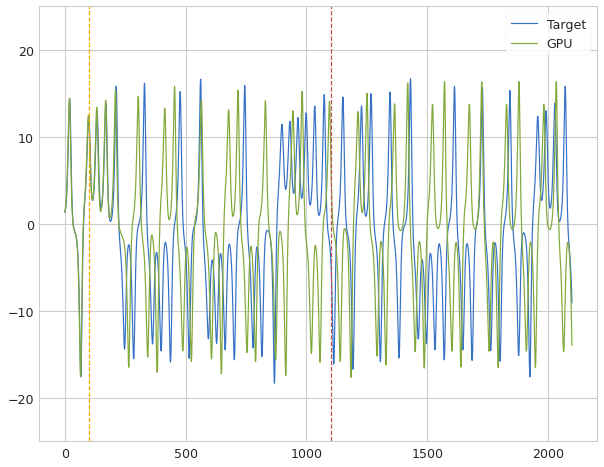

 Iter=39 a=0.504 sr=1.319 amp=1.000  ri=0.007 rr=2.223 loss=1.073232 nrmse=0.264679 CD 0.808552
Iter: 39 #### Time 4.23  NRMSE 0.265 CD 0.809
Iter: 40 #### Time 4.25  NRMSE 0.206 CD 0.880
Iter: 41 #### Time 4.19  NRMSE 2.531 CD 0.952
Iter: 42 #### Time 4.14  NRMSE 1.443 CD 0.993
Iter: 43 #### Time 4.15  NRMSE 0.651 CD 1.114
Iter: 44 #### Time 4.08  NRMSE 5.112 CD 1.001
Iter: 45 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 46 #### Time 4.34  NRMSE 0.334 CD 1.082
Iter: 47 #### Time 4.23  NRMSE 1.823 CD 0.985
Iter: 48 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 49 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 50 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 51 #### Time 4.15  NRMSE 0.504 CD 0.999
Iter: 52 #### Time 4.04  NRMSE 11.923 CD 1.107
Iter: 53 #### Time 4.13  NRMSE 1.098 CD 1.155
Iter: 54 #### Time 4.15  NRMSE 0.307 CD 0.931
Iter: 55 #### Time 4.16  NRMSE 0.302 CD 1.142
Iter: 56 #### Time 4.10  NRMSE 0.321 CD 1.080
Iter: 57 #### Time 4.05  NRMSE 0.968 CD 1.005
Iter: 58 #### Time 4.13  

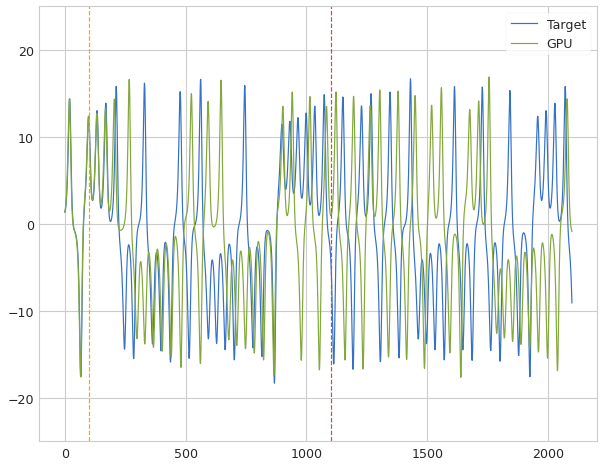

 Iter=117 a=0.784 sr=1.329 amp=1.000  ri=0.070 rr=2.865 loss=1.039989 nrmse=0.260648 CD 0.779341
Iter: 117 #### Time 4.45  NRMSE 0.261 CD 0.779
Iter: 118 #### Time 4.01  NRMSE 0.778 CD 0.978
Iter: 119 #### Time 4.05  NRMSE 0.278 CD 0.931
Iter: 120 #### Time 4.19  NRMSE 0.270 CD 0.822
Iter: 121 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 122 #### Time 4.17  NRMSE 0.321 CD 1.062
Iter: 123 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 124 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 125 #### Time 4.09  NRMSE 0.743 CD 1.013
Iter: 126 #### Time 4.17  NRMSE 0.324 CD 1.096
Iter: 127 #### Time 4.12  NRMSE 10.341 CD 0.919
Iter: 128 #### Time 4.08  NRMSE 0.893 CD 1.023
Iter: 129 #### Time 4.14  NRMSE 0.769 CD 1.031
Iter: 130 #### Time 4.20  NRMSE 0.982 CD 0.999
Iter: 131 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 132 #### Time 4.42  NRMSE 0.279 CD 0.857
Iter: 133 #### Time 4.15  NRMSE 0.303 CD 1.053
Dist 0.596239


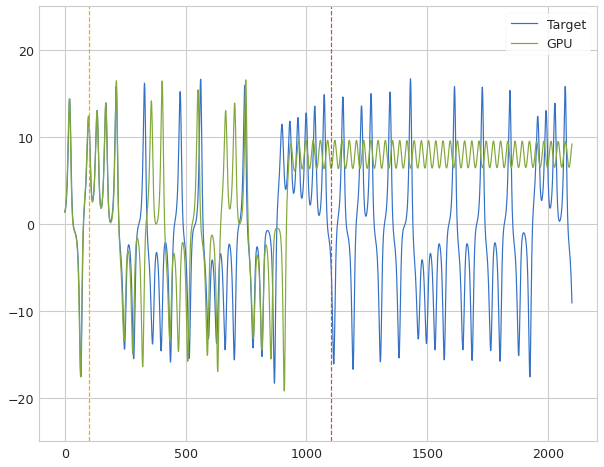

 Iter=134 a=0.737 sr=1.365 amp=1.000  ri=0.051 rr=2.553 loss=0.823680 nrmse=0.227441 CD 0.596239
Iter: 134 #### Time 4.24  NRMSE 0.227 CD 0.596
Iter: 135 #### Time 4.18  NRMSE 1.626 CD 0.924
Iter: 136 #### Time 4.13  NRMSE 1.506 CD 0.998
Iter: 137 #### Time 4.10  NRMSE 1.432 CD 1.001
Iter: 138 #### Time 4.06  NRMSE 0.304 CD 0.828
Iter: 139 #### Time 4.46  NRMSE 1000.000 CD nan
Iter: 140 #### Time 4.36  NRMSE 1.184 CD 0.948
Iter: 141 #### Time 4.48  NRMSE 1.959 CD 1.074
Iter: 142 #### Time 4.15  NRMSE 0.847 CD 1.052
Iter: 143 #### Time 4.06  NRMSE 0.833 CD 1.013
Iter: 144 #### Time 4.15  NRMSE 0.819 CD 1.051
Iter: 145 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 146 #### Time 4.12  NRMSE 0.338 CD 1.073
Iter: 147 #### Time 4.14  NRMSE 0.756 CD 0.952
Iter: 148 #### Time 4.10  NRMSE 0.284 CD 0.828
Iter: 149 #### Time 4.36  NRMSE 0.349 CD 1.071
End Run 2 Time 784.515

Best result = 0.8236796981225658
a = 0.7370665474948512
sr = 1.3648365736215502
amp = 0.050682224070728206
ri = 2.55296462740

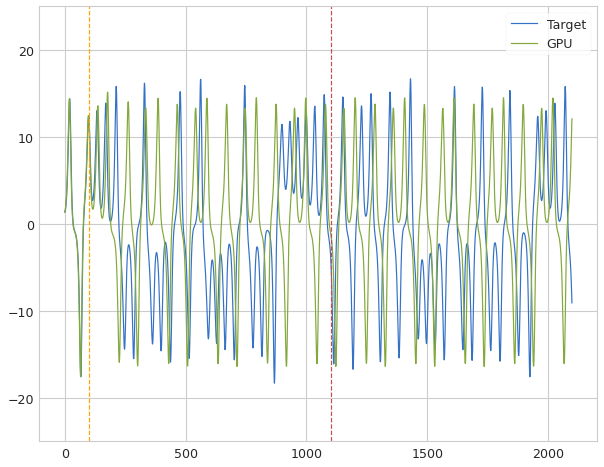

 Iter=3 a=0.586 sr=1.271 amp=1.000  ri=0.050 rr=2.913 loss=1.082205 nrmse=0.259738 CD 0.822467
Iter: 3 #### Time 4.18  NRMSE 0.260 CD 0.822
Iter: 4 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 5 #### Time 4.28  NRMSE 37.568 CD 1.001
Iter: 6 #### Time 4.03  NRMSE 4.500 CD 0.883
Iter: 7 #### Time 4.34  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.08  NRMSE 8.568 CD 1.153
Iter: 9 #### Time 4.12  NRMSE 0.309 CD 1.001
Iter: 10 #### Time 4.29  NRMSE 0.532 CD 0.951
Dist 0.705801


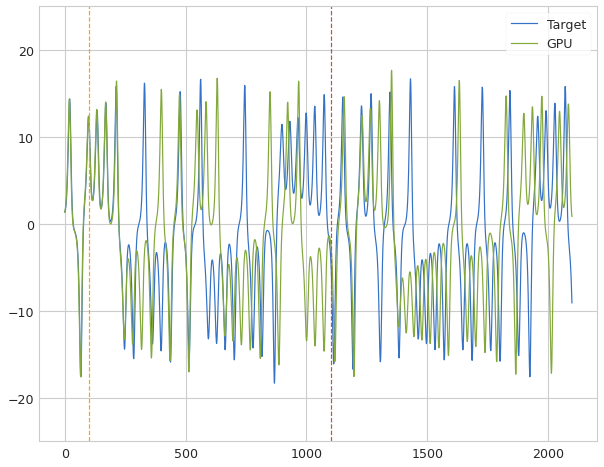

 Iter=11 a=0.761 sr=1.333 amp=1.000  ri=0.087 rr=2.811 loss=0.953806 nrmse=0.248005 CD 0.705801
Iter: 11 #### Time 4.21  NRMSE 0.248 CD 0.706
Iter: 12 #### Time 4.11  NRMSE 0.325 CD 1.063
Iter: 13 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 14 #### Time 4.04  NRMSE 0.289 CD 0.847
Iter: 15 #### Time 4.16  NRMSE 0.870 CD 0.827
Iter: 16 #### Time 4.15  NRMSE 0.290 CD 0.864
Iter: 17 #### Time 4.00  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.15  NRMSE 1.313 CD 0.985
Iter: 20 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.06  NRMSE 3.729 CD 1.018
Iter: 22 #### Time 4.12  NRMSE 0.361 CD 1.009
Iter: 23 #### Time 4.01  NRMSE 0.287 CD 0.934
Iter: 24 #### Time 4.05  NRMSE 0.527 CD 0.966
Iter: 25 #### Time 4.11  NRMSE 0.288 CD 0.778
Iter: 26 #### Time 4.28  NRMSE 0.400 CD 0.963
Iter: 27 #### Time 4.01  NRMSE 18156087980280389632.000 CD 1.000
Iter: 28 #### Time 4.05  NRMSE 0.332 CD 1.032
Iter: 29 #### Time 4.03  NRMSE 0.301 CD 0.986
Iter: 3

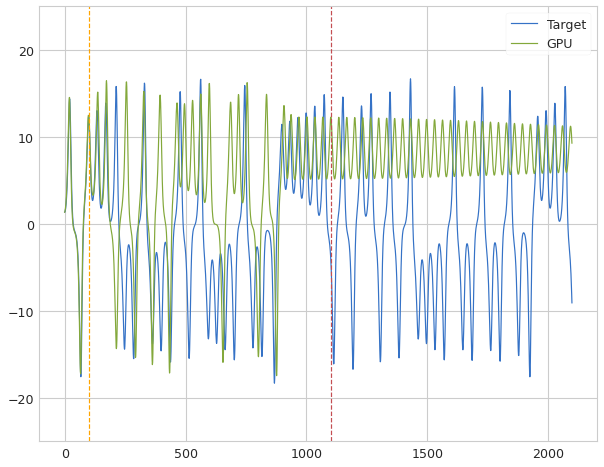

 Iter=72 a=0.523 sr=1.308 amp=1.000  ri=0.086 rr=2.592 loss=0.937247 nrmse=0.249882 CD 0.687365
Iter: 72 #### Time 4.19  NRMSE 0.250 CD 0.687
Iter: 73 #### Time 4.09  NRMSE 1.627 CD 1.002
Iter: 74 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 75 #### Time 4.06  NRMSE 1.815 CD 0.827
Iter: 76 #### Time 4.02  NRMSE 0.362 CD 0.919
Iter: 77 #### Time 4.13  NRMSE 0.322 CD 1.065
Iter: 78 #### Time 4.23  NRMSE 0.290 CD 0.765
Iter: 79 #### Time 4.10  NRMSE 0.326 CD 1.061
Iter: 80 #### Time 4.06  NRMSE 0.339 CD 1.106
Iter: 81 #### Time 4.02  NRMSE 0.485 CD 0.987
Iter: 82 #### Time 4.02  NRMSE 0.285 CD 0.883
Iter: 83 #### Time 4.00  NRMSE 0.272 CD 0.844
Iter: 84 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 85 #### Time 3.99  NRMSE 5.226 CD 0.997
Iter: 86 #### Time 4.02  NRMSE 0.336 CD 1.063
Iter: 87 #### Time 4.06  NRMSE 0.296 CD 0.885
Iter: 88 #### Time 4.09  NRMSE 0.217 CD 0.910
Iter: 89 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 90 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 91 #### Time 3.99  N

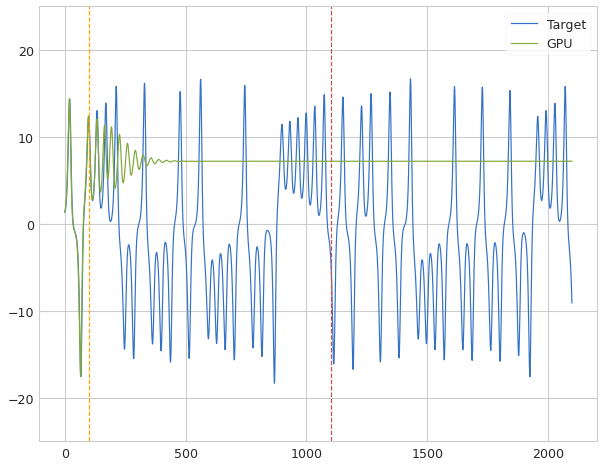

 Iter=6 a=0.638 sr=1.389 amp=1.000  ri=0.092 rr=2.953 loss=1.342146 nrmse=0.289491 CD 1.052655
Iter: 6 #### Time 4.12  NRMSE 0.289 CD 1.053
Iter: 7 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.10  NRMSE 6.484 CD 1.000
Dist 0.947029


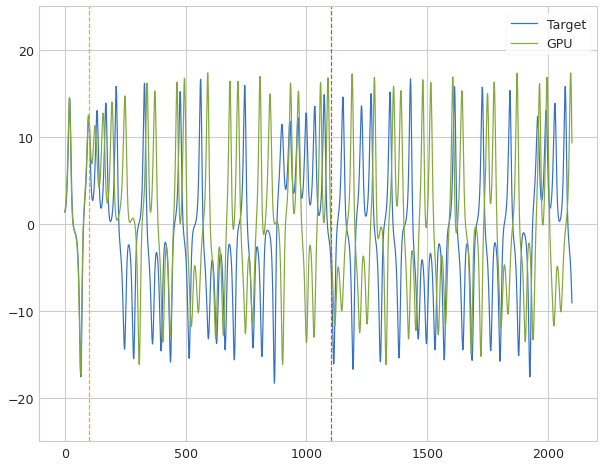

 Iter=9 a=0.634 sr=1.247 amp=1.000  ri=0.053 rr=2.318 loss=1.238359 nrmse=0.291330 CD 0.947029
Iter: 9 #### Time 4.16  NRMSE 0.291 CD 0.947
Iter: 10 #### Time 4.20  NRMSE 1.535 CD 0.999
Iter: 11 #### Time 4.01  NRMSE 0.301 CD 0.990
Iter: 12 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.27  NRMSE 0.888 CD 0.960
Iter: 14 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.02  NRMSE 0.308 CD 1.063
Dist 0.859837


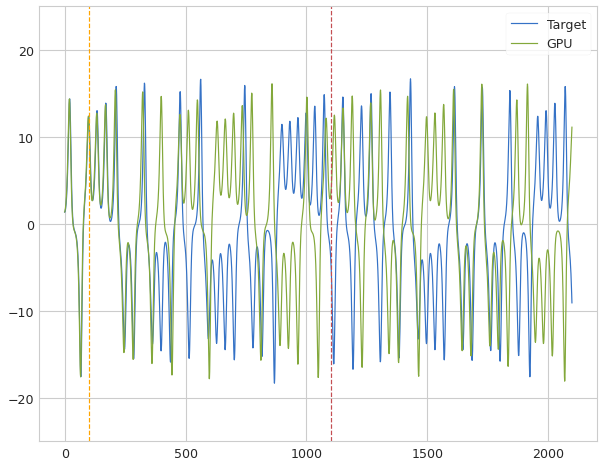

 Iter=16 a=0.708 sr=1.221 amp=1.000  ri=0.061 rr=2.563 loss=1.130597 nrmse=0.270760 CD 0.859837
Iter: 16 #### Time 4.34  NRMSE 0.271 CD 0.860
Iter: 17 #### Time 4.04  NRMSE 0.270 CD 0.956
Iter: 18 #### Time 4.03  NRMSE 0.306 CD 0.927
Iter: 19 #### Time 4.08  NRMSE 0.360 CD 1.192
Iter: 20 #### Time 4.07  NRMSE 0.337 CD 0.959
Iter: 21 #### Time 4.19  NRMSE 1000.000 CD nan
Dist 0.683066


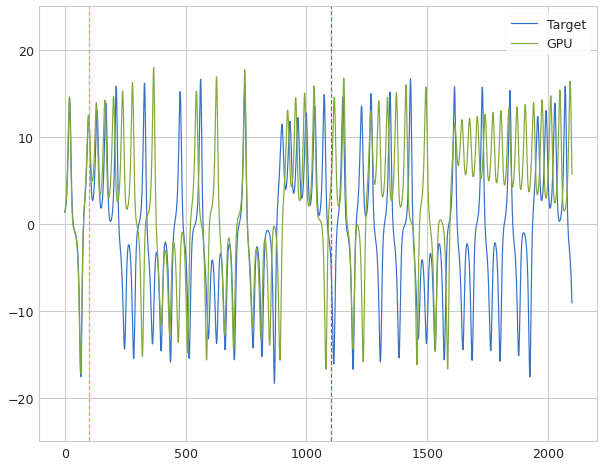

 Iter=22 a=0.768 sr=1.235 amp=1.000  ri=0.084 rr=2.581 loss=0.926460 nrmse=0.243394 CD 0.683066
Iter: 22 #### Time 4.47  NRMSE 0.243 CD 0.683
Iter: 23 #### Time 4.04  NRMSE 0.328 CD 1.082
Iter: 24 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 25 #### Time 4.31  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.08  NRMSE 0.357 CD 1.324
Iter: 27 #### Time 4.10  NRMSE 0.290 CD 0.970
Iter: 28 #### Time 4.13  NRMSE 0.300 CD 1.052
Iter: 29 #### Time 4.06  NRMSE 0.338 CD 1.111
Iter: 30 #### Time 4.11  NRMSE 0.321 CD 1.063
Iter: 31 #### Time 4.12  NRMSE 0.642 CD 0.989
Iter: 32 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 33 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 34 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 35 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 36 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 37 #### Time 4.35  NRMSE 1000.000 CD nan
Iter: 38 #### Time 4.09  NRMSE 0.652 CD 0.938
Iter: 39 #### Time 4.17  NRMSE 1.120 CD 0.993
Iter: 40 #### Time 4.21  NRMSE 1.815 CD 0.995
Iter: 41 #### Time 4.1

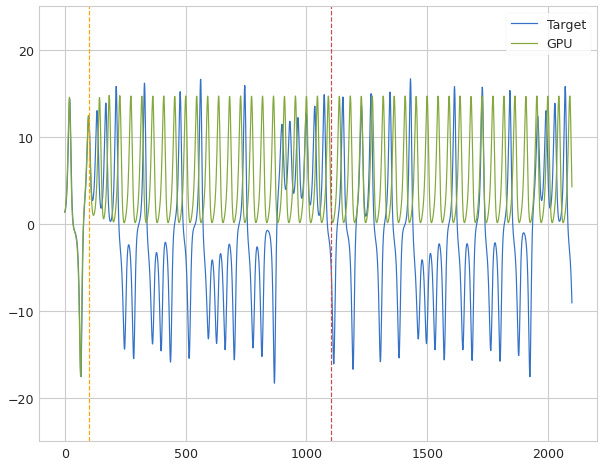

 Iter=7 a=0.528 sr=1.268 amp=1.000  ri=0.092 rr=2.247 loss=1.421443 nrmse=0.299376 CD 1.122067
Iter: 7 #### Time 4.16  NRMSE 0.299 CD 1.122
Iter: 8 #### Time 4.12  NRMSE 0.379 CD 0.941
Dist 0.998174


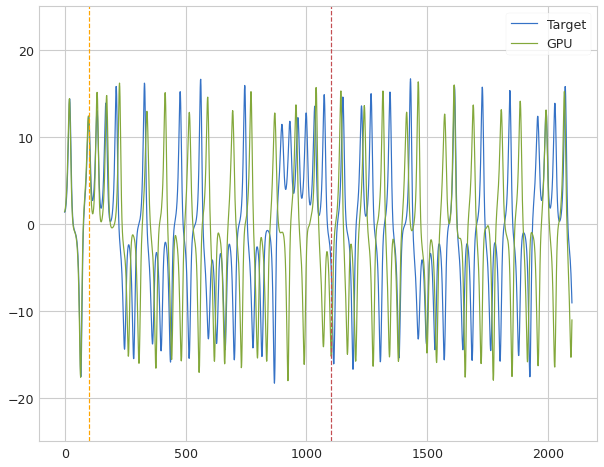

 Iter=9 a=0.597 sr=1.362 amp=1.000  ri=0.097 rr=2.798 loss=1.292343 nrmse=0.294169 CD 0.998174
Iter: 9 #### Time 4.19  NRMSE 0.294 CD 0.998
Iter: 10 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.07  NRMSE 0.411 CD 1.046
Iter: 12 #### Time 4.10  NRMSE 1.293 CD 0.966
Dist 0.811257


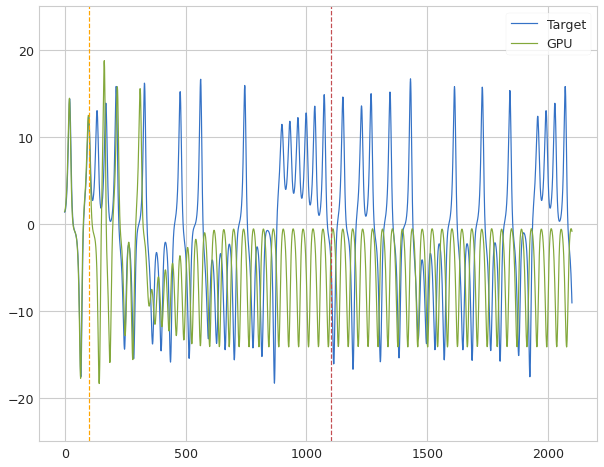

 Iter=13 a=0.635 sr=1.211 amp=1.000  ri=0.047 rr=2.236 loss=1.078901 nrmse=0.267644 CD 0.811257
Iter: 13 #### Time 4.21  NRMSE 0.268 CD 0.811
Iter: 14 #### Time 4.26  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.08  NRMSE 1.682 CD 1.096
Iter: 16 #### Time 4.29  NRMSE 0.747 CD 1.005
Iter: 17 #### Time 4.07  NRMSE 0.294 CD 1.000
Dist 0.579240


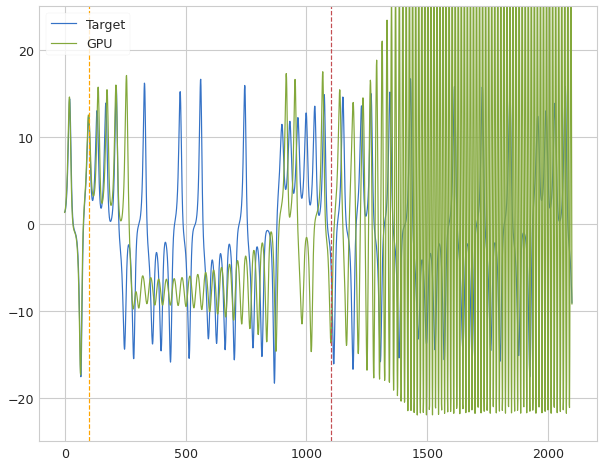

 Iter=18 a=0.576 sr=1.371 amp=1.000  ri=0.043 rr=2.838 loss=0.802948 nrmse=0.223708 CD 0.579240
Iter: 18 #### Time 4.25  NRMSE 0.224 CD 0.579
Iter: 19 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.10  NRMSE 0.694 CD 0.992
Iter: 21 #### Time 4.09  NRMSE 0.318 CD 1.084
Iter: 22 #### Time 4.08  NRMSE 5.976 CD 1.000
Iter: 23 #### Time 4.06  NRMSE 0.388 CD 0.943
Iter: 24 #### Time 4.10  NRMSE 1.619 CD 0.999
Iter: 25 #### Time 4.03  NRMSE 0.286 CD 0.752
Iter: 26 #### Time 4.06  NRMSE 0.523 CD 1.003
Iter: 27 #### Time 4.31  NRMSE 0.831 CD 0.955
Iter: 28 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 29 #### Time 4.02  NRMSE 0.320 CD 1.061
Iter: 30 #### Time 4.02  NRMSE 0.310 CD 0.999
Iter: 31 #### Time 4.13  NRMSE 0.722 CD 0.921
Iter: 32 #### Time 4.00  NRMSE 0.327 CD 1.063
Iter: 33 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 34 #### Time 4.79  NRMSE 0.269 CD 0.811
Iter: 35 #### Time 4.83  NRMSE 52.739 CD 1.002
Iter: 36 #### Time 4.49  NRMSE 0.428 CD 1.091
Iter: 37 #### Time 4.29  N

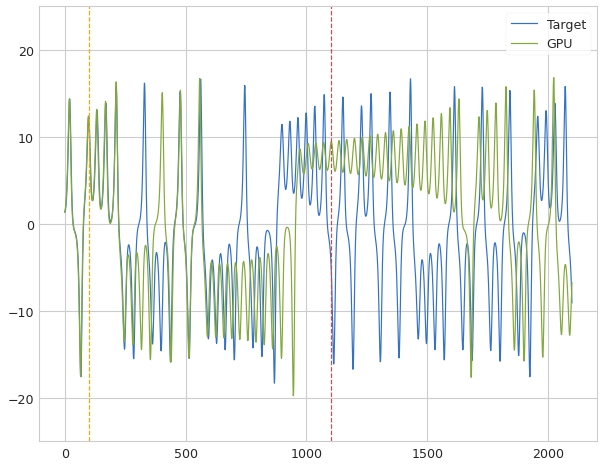

 Iter=44 a=0.810 sr=1.369 amp=1.000  ri=0.053 rr=2.597 loss=0.612207 nrmse=0.193118 CD 0.419089
Iter: 44 #### Time 5.38  NRMSE 0.193 CD 0.419
Iter: 45 #### Time 4.15  NRMSE 1.621 CD 1.004
Iter: 46 #### Time 4.07  NRMSE 0.347 CD 0.966
Iter: 47 #### Time 4.14  NRMSE 0.314 CD 1.063
Iter: 48 #### Time 4.02  NRMSE 0.349 CD 1.055
Iter: 49 #### Time 4.05  NRMSE 1.600 CD 1.028
Iter: 50 #### Time 3.99  NRMSE 0.261 CD 0.938
Iter: 51 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 52 #### Time 4.11  NRMSE 2.953 CD 1.126
Iter: 53 #### Time 4.02  NRMSE 0.319 CD 0.998
Iter: 54 #### Time 4.03  NRMSE 0.275 CD 0.878
Iter: 55 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 56 #### Time 4.10  NRMSE 5.055 CD 1.072
Iter: 57 #### Time 4.17  NRMSE 0.316 CD 1.026
Iter: 58 #### Time 3.97  NRMSE 0.628 CD 1.020
Iter: 59 #### Time 4.12  NRMSE 0.873 CD 0.918
Iter: 60 #### Time 4.02  NRMSE 0.739 CD 1.350
Iter: 61 #### Time 4.06  NRMSE 0.249 CD 0.868
Iter: 62 #### Time 4.07  NRMSE 0.319 CD 1.078
Iter: 63 #### Time 4.09  NRM

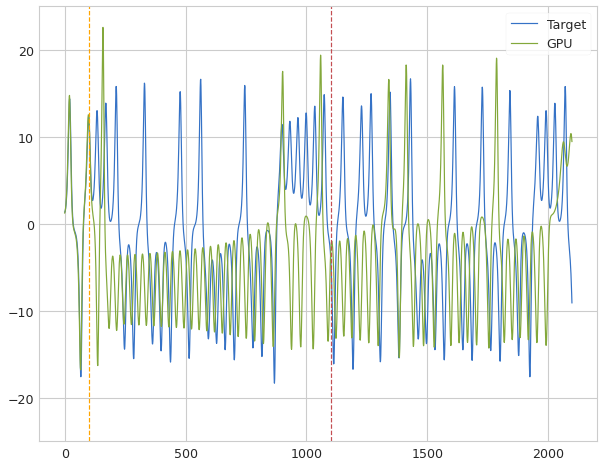

 Iter=2 a=0.537 sr=1.378 amp=1.000  ri=0.072 rr=2.518 loss=1.038563 nrmse=0.260523 CD 0.778040
Iter: 2 #### Time 4.20  NRMSE 0.261 CD 0.778
Iter: 3 #### Time 4.03  NRMSE 0.305 CD 1.075
Iter: 4 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 5 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.04  NRMSE 1.113 CD 0.995
Iter: 7 #### Time 4.02  NRMSE 0.285 CD 0.934
Iter: 8 #### Time 4.09  NRMSE 0.323 CD 1.065
Iter: 9 #### Time 4.07  NRMSE 0.336 CD 1.073
Iter: 10 #### Time 4.13  NRMSE 0.321 CD 1.069
Iter: 11 #### Time 4.09  NRMSE 0.825 CD 0.940
Iter: 12 #### Time 4.07  NRMSE 0.328 CD 1.063
Iter: 13 #### Time 4.09  NRMSE 0.312 CD 1.070
Iter: 14 #### Time 4.04  NRMSE 0.960 CD 0.936
Iter: 15 #### Time 4.05  NRMSE 0.894 CD 0.978
Iter: 16 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 17 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.03  NRMSE 0.326 CD 1.067
Iter: 19 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.09  NRMSE 0.338 CD 0.907
Iter: 21 #### Time 4.09  NRMSE 0.4

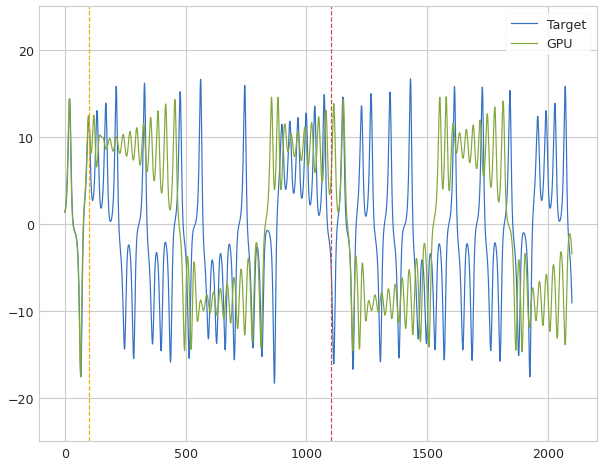

 Iter=141 a=0.900 sr=1.211 amp=1.000  ri=0.066 rr=2.781 loss=0.947744 nrmse=0.259755 CD 0.687989
Iter: 141 #### Time 4.38  NRMSE 0.260 CD 0.688
Iter: 142 #### Time 4.56  NRMSE 1000.000 CD nan
Iter: 143 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 144 #### Time 4.09  NRMSE 2.667 CD 0.997
Iter: 145 #### Time 4.32  NRMSE 0.357 CD 0.936
Iter: 146 #### Time 4.29  NRMSE 0.284 CD 0.995
Iter: 147 #### Time 4.10  NRMSE 0.915 CD 0.990
Iter: 148 #### Time 4.13  NRMSE 0.322 CD 1.060
Iter: 149 #### Time 4.29  NRMSE 0.282 CD 0.938
End Run 3 Time 761.144

Best result = 0.9477438910388871
a = 0.9
sr = 1.2107444122193265
amp = 0.06556580606337592
ri = 2.781337390437146
********** Size 40 -- Run 1 ***********
Dist 1.003428


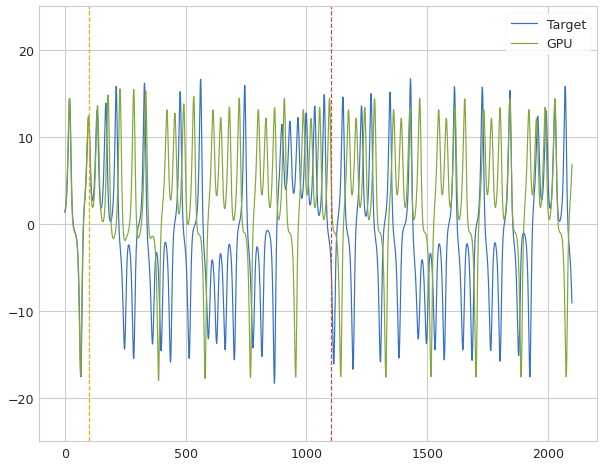

 Iter=0 a=0.556 sr=1.305 amp=1.000  ri=0.076 rr=2.310 loss=1.290079 nrmse=0.286651 CD 1.003428
Iter: 0 #### Time 4.66  NRMSE 0.287 CD 1.003
Iter: 1 #### Time 4.30  NRMSE 0.827 CD 0.946
Dist 0.903854


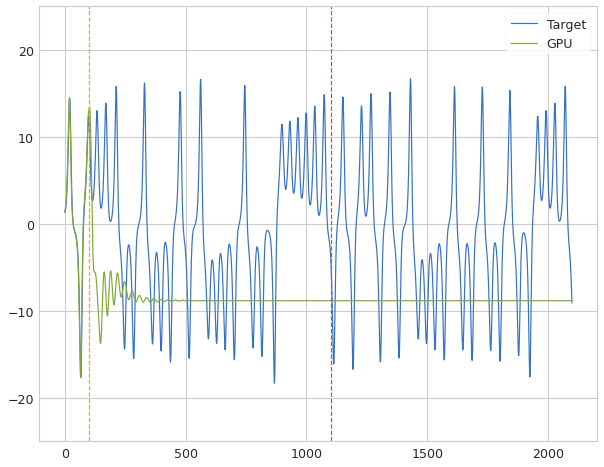

 Iter=2 a=0.552 sr=1.261 amp=1.000  ri=0.058 rr=2.578 loss=1.198297 nrmse=0.294443 CD 0.903854
Iter: 2 #### Time 4.36  NRMSE 0.294 CD 0.904
Iter: 3 #### Time 4.07  NRMSE 0.311 CD 1.029
Iter: 4 #### Time 4.19  NRMSE 1000.000 CD nan
Iter: 5 #### Time 4.23  NRMSE 0.303 CD 1.061
Iter: 6 #### Time 4.06  NRMSE 0.306 CD 1.032
Iter: 7 #### Time 4.04  NRMSE 0.285 CD 0.979
Dist 0.833987


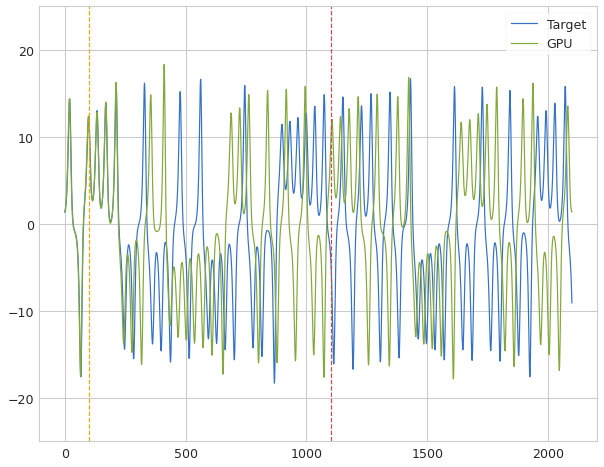

 Iter=8 a=0.745 sr=1.273 amp=1.000  ri=0.051 rr=2.346 loss=1.104049 nrmse=0.270062 CD 0.833987
Iter: 8 #### Time 4.23  NRMSE 0.270 CD 0.834
Iter: 9 #### Time 4.10  NRMSE 0.390 CD 0.986
Dist 0.801746


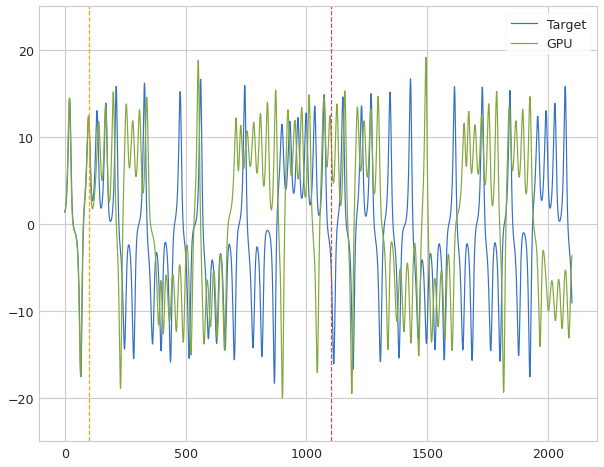

 Iter=10 a=0.569 sr=1.208 amp=1.000  ri=0.095 rr=2.765 loss=1.082228 nrmse=0.280482 CD 0.801746
Iter: 10 #### Time 4.15  NRMSE 0.280 CD 0.802
Iter: 11 #### Time 4.15  NRMSE 843475534690.130 CD 1.105
Iter: 12 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.02  NRMSE 0.293 CD 0.988
Iter: 14 #### Time 4.15  NRMSE 2.541 CD 1.155
Iter: 15 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.32  NRMSE 0.806 CD 1.103
Iter: 17 #### Time 4.04  NRMSE 0.279 CD 0.804
Iter: 18 #### Time 4.20  NRMSE 2.999 CD 1.023
Iter: 19 #### Time 4.05  NRMSE 0.430 CD 1.099
Iter: 20 #### Time 4.05  NRMSE 0.268 CD 0.842
Iter: 21 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 23 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 24 #### Time 4.20  NRMSE 5.193 CD 1.000
Iter: 25 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.08  NRMSE 1.781 CD 0.985
Iter: 27 #### Time 4.08  NRMSE 1.582 CD 1.002
Iter: 28 #### Time 4.06  NRMSE 0.845 CD 1.000
Iter: 29 ####

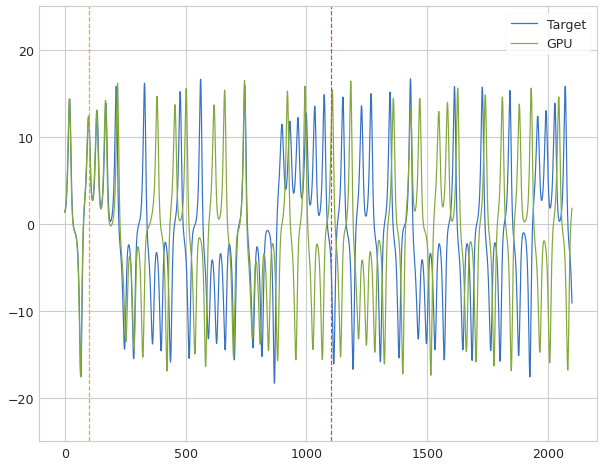

 Iter=44 a=0.787 sr=1.218 amp=1.000  ri=0.040 rr=2.645 loss=1.035810 nrmse=0.257909 CD 0.777902
Iter: 44 #### Time 4.19  NRMSE 0.258 CD 0.778
Iter: 45 #### Time 4.25  NRMSE 1000.000 CD nan
Iter: 46 #### Time 4.22  NRMSE 0.947 CD 0.851
Iter: 47 #### Time 4.10  NRMSE 0.918 CD 0.951
Iter: 48 #### Time 4.13  NRMSE 1.778 CD 0.994
Iter: 49 #### Time 4.08  NRMSE 0.782 CD 1.004
Iter: 50 #### Time 4.11  NRMSE 0.320 CD 1.058
Iter: 51 #### Time 4.22  NRMSE 0.470 CD 0.870
Iter: 52 #### Time 4.01  NRMSE 0.293 CD 0.961
Iter: 53 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 54 #### Time 4.04  NRMSE 0.309 CD 1.051
Iter: 55 #### Time 4.09  NRMSE 1000.000 CD nan
Dist 0.571009


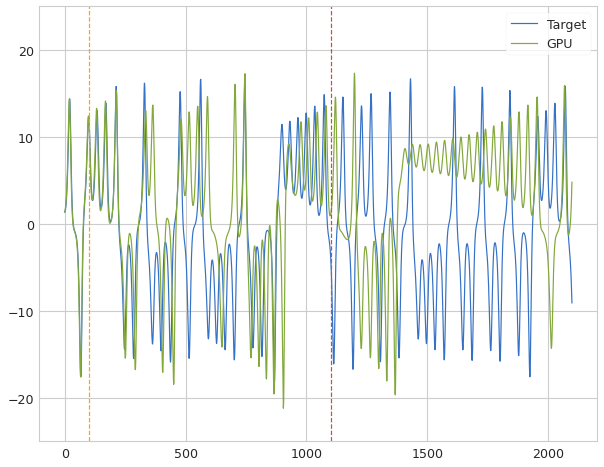

 Iter=56 a=0.630 sr=1.352 amp=1.000  ri=0.010 rr=2.272 loss=0.793082 nrmse=0.222072 CD 0.571009
Iter: 56 #### Time 4.24  NRMSE 0.222 CD 0.571
Iter: 57 #### Time 4.12  NRMSE 0.335 CD 1.099
Iter: 58 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 59 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 60 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 61 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 62 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 63 #### Time 4.03  NRMSE 0.264 CD 1.037
Iter: 64 #### Time 4.03  NRMSE 1.596 CD 0.990
Iter: 65 #### Time 4.19  NRMSE 0.222 CD 1.002
Iter: 66 #### Time 4.07  NRMSE 0.315 CD 1.061
Iter: 67 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 68 #### Time 4.22  NRMSE 0.277 CD 0.870
Iter: 69 #### Time 4.06  NRMSE 0.979 CD 0.788
Iter: 70 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 71 #### Time 4.08  NRMSE 0.319 CD 1.052
Iter: 72 #### Time 4.18  NRMSE 0.418 CD 0.905
Iter: 73 #### Time 4.09  NRMSE 0.349 CD 0.915
Iter: 74 #### Time 4.08  NRMSE 3.902 CD 1.035
Iter: 75 #### Time 4.13

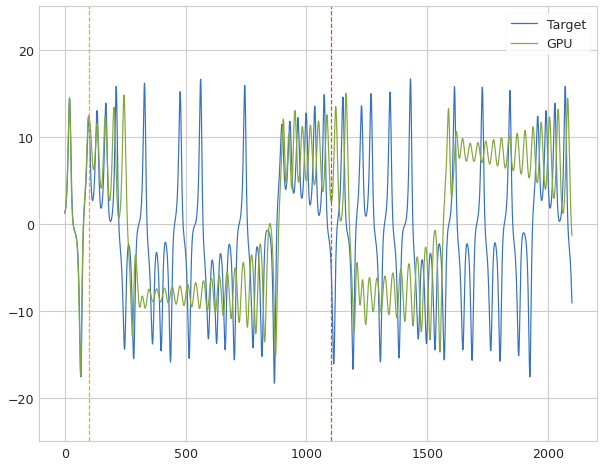

 Iter=117 a=0.656 sr=1.200 amp=1.000  ri=0.066 rr=3.000 loss=0.713967 nrmse=0.212090 CD 0.501877
Iter: 117 #### Time 4.24  NRMSE 0.212 CD 0.502
Iter: 118 #### Time 4.07  NRMSE 1.382 CD 0.996
Iter: 119 #### Time 4.06  NRMSE 0.305 CD 1.060
Iter: 120 #### Time 4.06  NRMSE 0.310 CD 1.058
Iter: 121 #### Time 4.21  NRMSE 1000.000 CD nan
Iter: 122 #### Time 4.12  NRMSE 0.881 CD 0.983
Iter: 123 #### Time 4.16  NRMSE 1.222 CD 0.977
Iter: 124 #### Time 4.06  NRMSE 0.307 CD 1.102
Iter: 125 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 126 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 127 #### Time 4.44  NRMSE 0.571 CD 1.086
Iter: 128 #### Time 4.10  NRMSE 0.280 CD 0.759
Iter: 129 #### Time 4.22  NRMSE 0.309 CD 1.057
Iter: 130 #### Time 4.18  NRMSE 0.324 CD 1.066
Iter: 131 #### Time 4.04  NRMSE 1.346 CD 0.987
Iter: 132 #### Time 4.14  NRMSE 0.244 CD 0.660
Iter: 133 #### Time 3.99  NRMSE 0.319 CD 1.090
Iter: 134 #### Time 4.22  NRMSE 0.316 CD 1.062
Iter: 135 #### Time 4.02  NRMSE 5.215 CD 0.903
Iter: 1

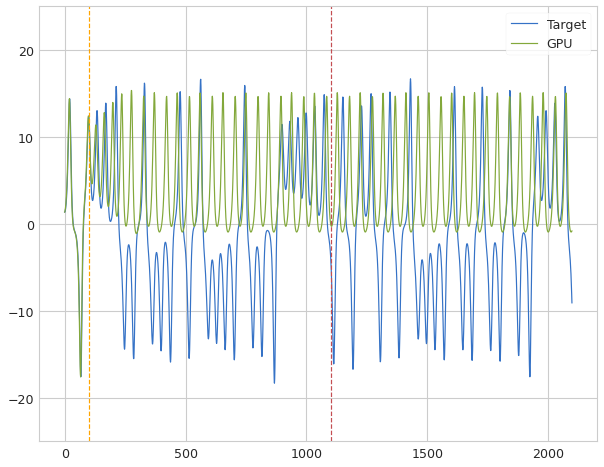

 Iter=16 a=0.709 sr=1.229 amp=1.000  ri=0.031 rr=2.807 loss=1.144106 nrmse=0.260405 CD 0.883701
Iter: 16 #### Time 4.16  NRMSE 0.260 CD 0.884
Iter: 17 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.26  NRMSE 0.435 CD 1.101
Iter: 19 #### Time 4.34  NRMSE 0.321 CD 0.969
Iter: 20 #### Time 4.11  NRMSE 0.286 CD 0.996
Iter: 21 #### Time 4.04  NRMSE 2.863 CD 0.877
Iter: 22 #### Time 4.08  NRMSE 0.291 CD 1.000
Dist 0.780427


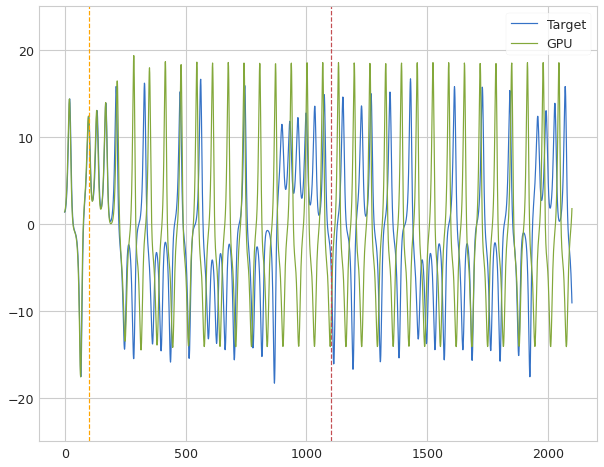

 Iter=23 a=0.640 sr=1.355 amp=1.000  ri=0.090 rr=2.786 loss=1.053041 nrmse=0.272614 CD 0.780427
Iter: 23 #### Time 4.23  NRMSE 0.273 CD 0.780
Iter: 24 #### Time 4.39  NRMSE 0.668 CD 0.916
Iter: 25 #### Time 4.29  NRMSE 0.318 CD 1.038
Iter: 26 #### Time 4.30  NRMSE 0.325 CD 0.941
Iter: 27 #### Time 4.16  NRMSE 0.585 CD 0.933
Iter: 28 #### Time 4.22  NRMSE 0.282 CD 0.823
Iter: 29 #### Time 4.27  NRMSE 0.607 CD 1.031
Iter: 30 #### Time 4.12  NRMSE 0.470 CD 1.099
Iter: 31 #### Time 4.04  NRMSE 0.290 CD 1.058
Iter: 32 #### Time 4.08  NRMSE 0.730 CD 0.996
Iter: 33 #### Time 4.02  NRMSE 0.278 CD 0.944
Dist 0.762360


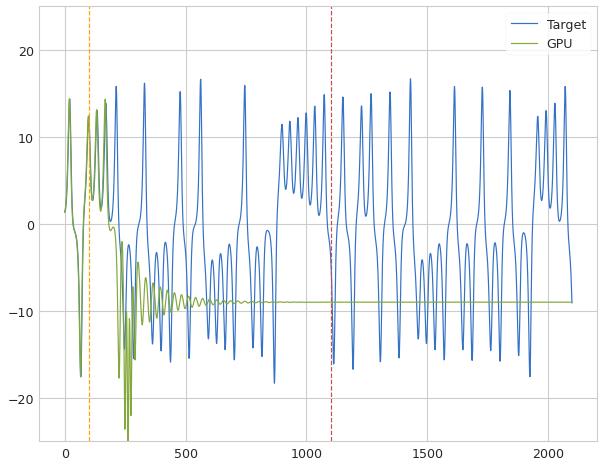

 Iter=34 a=0.688 sr=1.341 amp=1.000  ri=0.035 rr=2.697 loss=1.043143 nrmse=0.280783 CD 0.762360
Iter: 34 #### Time 4.19  NRMSE 0.281 CD 0.762
Iter: 35 #### Time 4.01  NRMSE 1.873 CD 0.999
Iter: 36 #### Time 4.01  NRMSE 0.292 CD 0.964
Iter: 37 #### Time 4.02  NRMSE 0.393 CD 0.890
Iter: 38 #### Time 4.03  NRMSE 0.411 CD 0.847
Iter: 39 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 40 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 41 #### Time 4.08  NRMSE 0.321 CD 1.060
Dist 0.774363


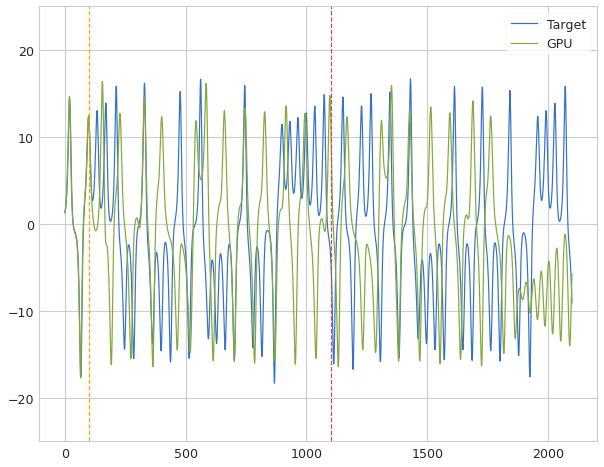

 Iter=42 a=0.645 sr=1.360 amp=1.000  ri=0.072 rr=2.602 loss=1.030416 nrmse=0.256053 CD 0.774363
Iter: 42 #### Time 4.14  NRMSE 0.256 CD 0.774
Iter: 43 #### Time 4.02  NRMSE 3.391 CD 0.901
Iter: 44 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 45 #### Time 4.04  NRMSE 0.287 CD 0.888
Iter: 46 #### Time 4.00  NRMSE 0.363 CD 1.086
Iter: 47 #### Time 4.03  NRMSE 4.704 CD 0.988
Iter: 48 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 49 #### Time 4.03  NRMSE 0.335 CD 1.002
Iter: 50 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 51 #### Time 4.04  NRMSE 2.081 CD 1.112
Iter: 52 #### Time 4.03  NRMSE 2.519 CD 0.990
Iter: 53 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 54 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 55 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 56 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 57 #### Time 4.03  NRMSE 0.784 CD 0.976
Iter: 58 #### Time 4.04  NRMSE 2.230 CD 1.095
Iter: 59 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 60 #### Time 4.06  NRMSE 1.092 CD 1.021
Dist 0.693128


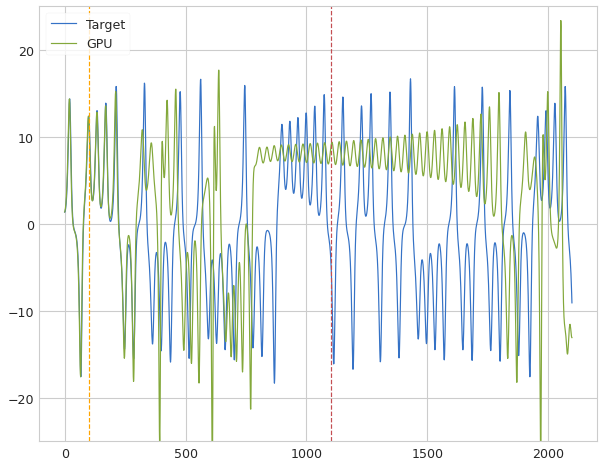

 Iter=61 a=0.540 sr=1.300 amp=1.000  ri=0.080 rr=2.070 loss=0.950515 nrmse=0.257386 CD 0.693128
Iter: 61 #### Time 4.26  NRMSE 0.257 CD 0.693
Iter: 62 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 63 #### Time 4.10  NRMSE 0.692 CD 1.073
Iter: 64 #### Time 4.03  NRMSE 0.440 CD 0.809
Iter: 65 #### Time 4.01  NRMSE 0.292 CD 1.006
Iter: 66 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 67 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 68 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 69 #### Time 4.05  NRMSE 6.354 CD 1.000
Iter: 70 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 71 #### Time 4.11  NRMSE 0.356 CD 1.055
Iter: 72 #### Time 4.04  NRMSE 0.308 CD 1.053
Iter: 73 #### Time 4.09  NRMSE 0.632 CD 0.994
Iter: 74 #### Time 3.98  NRMSE 0.418 CD 0.806
Iter: 75 #### Time 4.02  NRMSE 0.258 CD 0.793
Iter: 76 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 77 #### Time 4.02  NRMSE 0.418 CD 0.939
Iter: 78 #### Time 4.17  NRMSE 0.690 CD 1.007
Iter: 79 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 80 #### Time 4.05

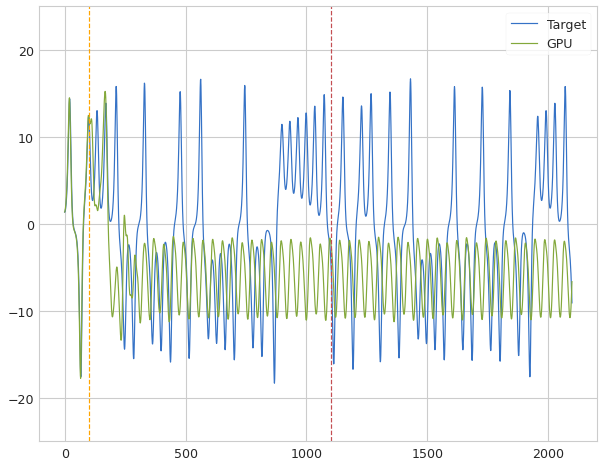

 Iter=2 a=0.610 sr=1.312 amp=1.000  ri=0.003 rr=2.665 loss=1.092790 nrmse=0.255067 CD 0.837724
Iter: 2 #### Time 4.21  NRMSE 0.255 CD 0.838
Dist 0.815759


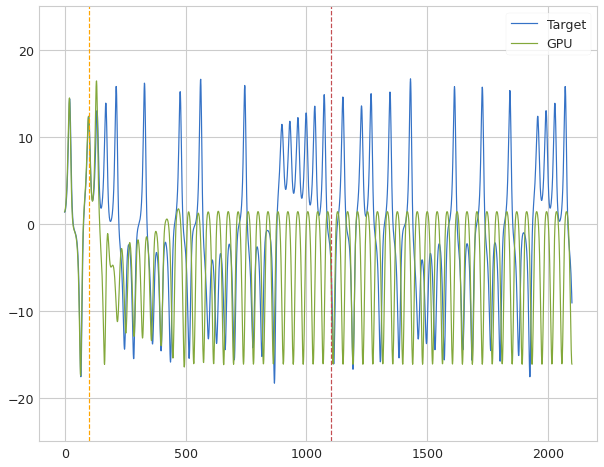

 Iter=3 a=0.661 sr=1.380 amp=1.000  ri=0.074 rr=2.275 loss=1.079433 nrmse=0.263674 CD 0.815759
Iter: 3 #### Time 4.28  NRMSE 0.264 CD 0.816
Iter: 4 #### Time 4.13  NRMSE 0.549 CD 1.022
Iter: 5 #### Time 4.07  NRMSE 0.350 CD 1.018
Iter: 6 #### Time 4.11  NRMSE 0.285 CD 0.803
Iter: 7 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 9 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 10 #### Time 4.07  NRMSE 0.395 CD 1.035
Iter: 11 #### Time 4.06  NRMSE 0.322 CD 1.002
Iter: 12 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.08  NRMSE 0.614 CD 1.034
Iter: 14 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.08  NRMSE 0.313 CD 1.100
Iter: 16 #### Time 4.23  NRMSE 1.290 CD 0.996
Iter: 17 #### Time 4.21  NRMSE 11.002 CD 1.080
Iter: 18 #### Time 4.05  NRMSE 0.297 CD 1.003
Iter: 19 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.16  NRMSE 0.383 CD 1.000
Iter: 21 #### Time 4.11  NRMSE 0.336 CD 1.061
Iter: 22 #### Time 4.14  NRMSE 

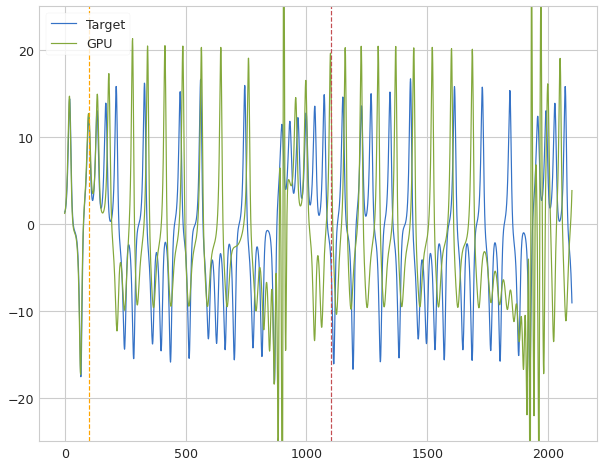

 Iter=35 a=0.573 sr=1.347 amp=1.000  ri=0.077 rr=2.695 loss=0.966191 nrmse=0.262362 CD 0.703829
Iter: 35 #### Time 4.47  NRMSE 0.262 CD 0.704
Iter: 36 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 37 #### Time 4.08  NRMSE 3.583 CD 0.999
Iter: 38 #### Time 4.02  NRMSE 0.368 CD 0.974
Iter: 39 #### Time 4.06  NRMSE 0.324 CD 1.064
Iter: 40 #### Time 4.06  NRMSE 0.335 CD 0.982
Iter: 41 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 42 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 43 #### Time 4.13  NRMSE 0.927 CD 0.982
Iter: 44 #### Time 4.06  NRMSE 0.841 CD 1.137
Iter: 45 #### Time 4.02  NRMSE 0.295 CD 0.925
Iter: 46 #### Time 4.07  NRMSE 0.275 CD 1.014
Iter: 47 #### Time 4.07  NRMSE 0.314 CD 1.075
Iter: 48 #### Time 4.07  NRMSE 0.276 CD 0.893
Iter: 49 #### Time 4.03  NRMSE 1.294 CD 1.002
Iter: 50 #### Time 4.24  NRMSE 1000.000 CD nan
Iter: 51 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 52 #### Time 4.05  NRMSE 2.277 CD 0.997
Iter: 53 #### Time 4.05  NRMSE 0.338 CD 1.026
Iter: 54 #### Time 4.04  

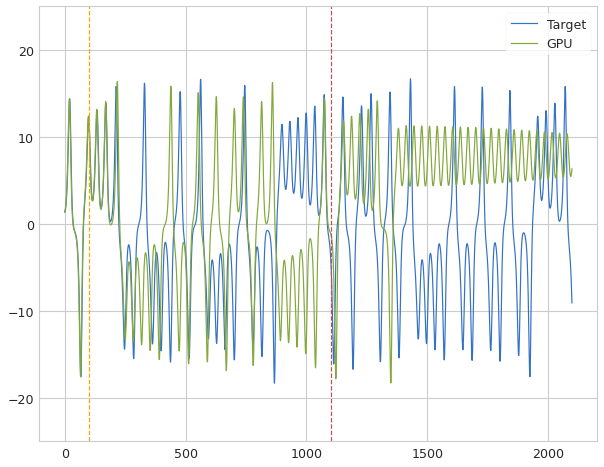

 Iter=6 a=0.827 sr=1.348 amp=1.000  ri=0.057 rr=2.709 loss=1.194641 nrmse=0.282136 CD 0.912505
Iter: 6 #### Time 4.29  NRMSE 0.282 CD 0.913
Iter: 7 #### Time 4.11  NRMSE 0.326 CD 0.972
Iter: 8 #### Time 4.06  NRMSE 1.233 CD 1.025
Iter: 9 #### Time 4.11  NRMSE 1.440 CD 1.023
Iter: 10 #### Time 4.31  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.21  NRMSE 0.307 CD 1.117
Iter: 12 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 14 #### Time 4.05  NRMSE 0.567 CD 0.967
Iter: 15 #### Time 4.08  NRMSE 1.844 CD 0.997
Iter: 16 #### Time 4.07  NRMSE 0.618 CD 1.041
Iter: 17 #### Time 4.10  NRMSE 0.297 CD 0.907
Iter: 18 #### Time 4.05  NRMSE 0.580 CD 0.956
Iter: 19 #### Time 4.09  NRMSE 1000.000 CD nan
Dist 0.783995


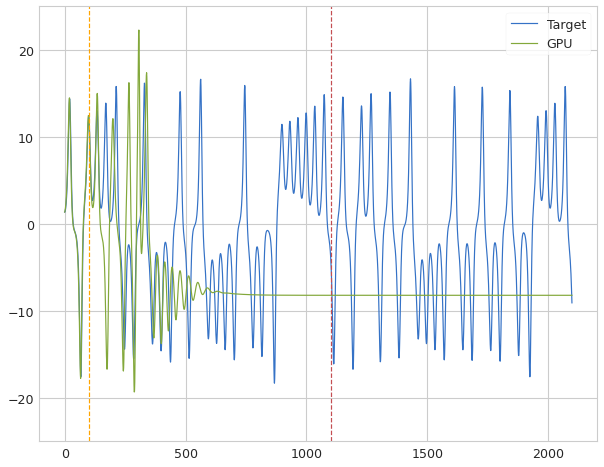

 Iter=20 a=0.580 sr=1.321 amp=1.000  ri=0.077 rr=2.158 loss=1.053048 nrmse=0.269052 CD 0.783995
Iter: 20 #### Time 4.14  NRMSE 0.269 CD 0.784
Iter: 21 #### Time 4.06  NRMSE 2.059 CD 0.946
Iter: 22 #### Time 4.08  NRMSE 2.472 CD 0.994
Iter: 23 #### Time 4.15  NRMSE 0.287 CD 0.933
Iter: 24 #### Time 4.12  NRMSE 0.471 CD 0.987
Iter: 25 #### Time 4.12  NRMSE 1.456 CD 0.988
Iter: 26 #### Time 4.09  NRMSE 0.448 CD 0.913
Iter: 27 #### Time 4.04  NRMSE 0.311 CD 0.841
Iter: 28 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 29 #### Time 4.40  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.11  NRMSE 0.284 CD 0.972
Iter: 31 #### Time 4.27  NRMSE 1000.000 CD nan
Iter: 32 #### Time 4.09  NRMSE 0.330 CD 1.076
Iter: 33 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 34 #### Time 4.10  NRMSE 0.322 CD 1.064
Iter: 35 #### Time 4.08  NRMSE 0.344 CD 1.167
Iter: 36 #### Time 4.04  NRMSE 0.282 CD 1.053
Iter: 37 #### Time 4.04  NRMSE 0.307 CD 1.059
Iter: 38 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 39 #### Time 4.05  

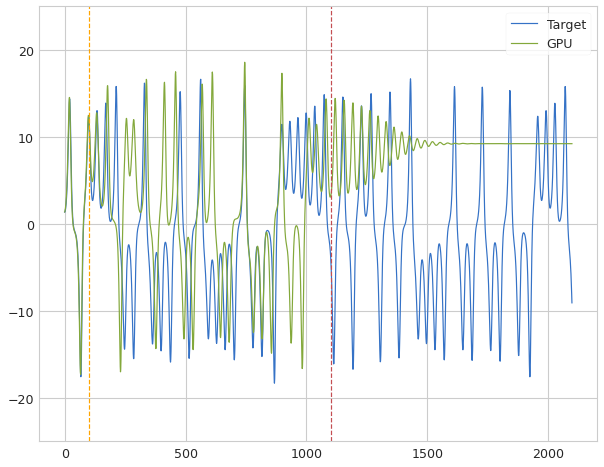

 Iter=62 a=0.505 sr=1.216 amp=1.000  ri=0.020 rr=2.007 loss=0.957144 nrmse=0.246097 CD 0.711047
Iter: 62 #### Time 4.19  NRMSE 0.246 CD 0.711
Iter: 63 #### Time 4.21  NRMSE 0.333 CD 1.062
Iter: 64 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 65 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 66 #### Time 4.32  NRMSE 1.042 CD 1.038
Iter: 67 #### Time 4.23  NRMSE 4.988 CD 1.111
Iter: 68 #### Time 4.17  NRMSE 0.298 CD 1.103
Iter: 69 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 70 #### Time 4.08  NRMSE 1.729 CD 1.101
Iter: 71 #### Time 4.13  NRMSE 0.322 CD 1.055
Iter: 72 #### Time 4.12  NRMSE 0.361 CD 0.950
Iter: 73 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 74 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 75 #### Time 4.10  NRMSE 0.681 CD 1.144
Iter: 76 #### Time 4.10  NRMSE 0.734 CD 0.977
Iter: 77 #### Time 4.05  NRMSE 0.264 CD 1.072
Iter: 78 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 79 #### Time 4.05  NRMSE 0.331 CD 1.181
Iter: 80 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 81 #### Time 4.17

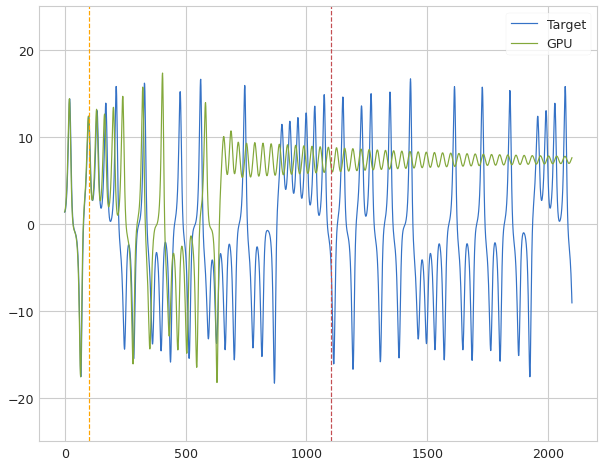

 Iter=10 a=0.517 sr=1.239 amp=1.000  ri=0.048 rr=2.037 loss=1.050317 nrmse=0.258383 CD 0.791933
Iter: 10 #### Time 4.23  NRMSE 0.258 CD 0.792
Iter: 11 #### Time 4.47  NRMSE 0.298 CD 1.050
Iter: 12 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.05  NRMSE 0.303 CD 1.082
Iter: 14 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.11  NRMSE 3.324 CD 0.849
Iter: 16 #### Time 4.12  NRMSE 0.326 CD 1.019
Iter: 17 #### Time 4.23  NRMSE 2.066 CD 0.966
Iter: 18 #### Time 4.27  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.25  NRMSE 0.400 CD 0.986
Iter: 21 #### Time 4.08  NRMSE 0.320 CD 1.088
Iter: 22 #### Time 4.03  NRMSE 0.308 CD 0.983
Iter: 23 #### Time 4.09  NRMSE 0.268 CD 0.820
Iter: 24 #### Time 4.00  NRMSE 0.298 CD 0.901
Iter: 25 #### Time 4.27  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.06  NRMSE 1.569 CD 0.992
Iter: 27 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 28 #### Time 4.04  NRMSE 1.977 CD 0.924
Iter: 29 #### Time 4.08 

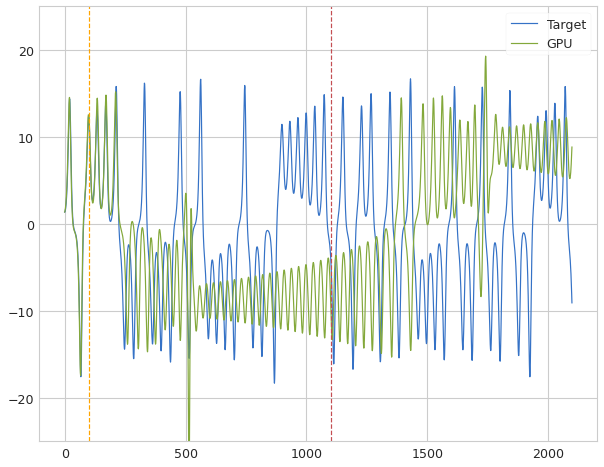

 Iter=127 a=0.668 sr=1.304 amp=1.000  ri=0.071 rr=2.267 loss=1.045128 nrmse=0.268834 CD 0.776293
Iter: 127 #### Time 4.30  NRMSE 0.269 CD 0.776
Dist 0.730754


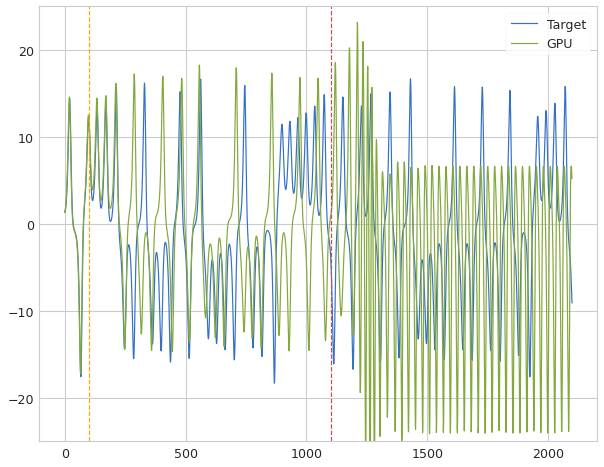

 Iter=128 a=0.673 sr=1.305 amp=1.000  ri=0.071 rr=2.344 loss=0.980919 nrmse=0.250165 CD 0.730754
Iter: 128 #### Time 4.23  NRMSE 0.250 CD 0.731
Iter: 129 #### Time 4.07  NRMSE 0.349 CD 1.067
Iter: 130 #### Time 4.14  NRMSE 0.323 CD 1.063
Iter: 131 #### Time 4.25  NRMSE 0.581 CD 0.964
Iter: 132 #### Time 4.09  NRMSE 0.321 CD 1.064
Iter: 133 #### Time 4.36  NRMSE 1000.000 CD nan
Iter: 134 #### Time 4.26  NRMSE 1.444 CD 0.982
Iter: 135 #### Time 4.30  NRMSE 0.871 CD 1.123
Iter: 136 #### Time 4.25  NRMSE 1000.000 CD nan
Iter: 137 #### Time 4.23  NRMSE 0.315 CD 1.060
Iter: 138 #### Time 4.18  NRMSE 1000.000 CD nan
Iter: 139 #### Time 4.25  NRMSE 0.380 CD 0.871
Iter: 140 #### Time 4.10  NRMSE 0.307 CD 1.035
Iter: 141 #### Time 4.24  NRMSE 1000.000 CD nan
Iter: 142 #### Time 4.15  NRMSE 0.322 CD 1.064
Iter: 143 #### Time 4.30  NRMSE 1000.000 CD nan
Iter: 144 #### Time 4.21  NRMSE 0.301 CD 1.052
Iter: 145 #### Time 4.10  NRMSE 0.690 CD 1.027
Iter: 146 #### Time 4.07  NRMSE 0.250 CD 0.733
Iter:

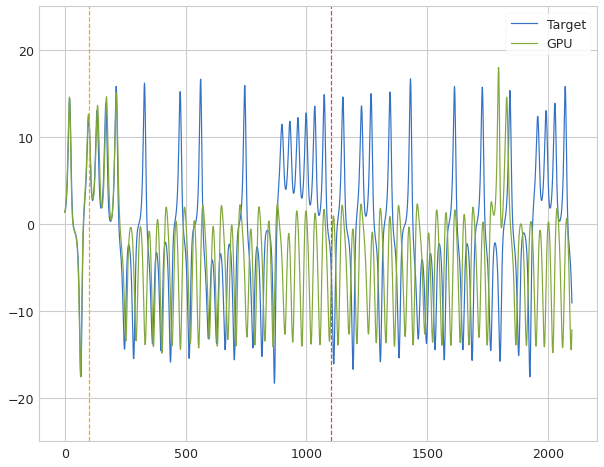

 Iter=4 a=0.538 sr=1.382 amp=1.000  ri=0.068 rr=2.826 loss=0.891190 nrmse=0.233527 CD 0.657664
Iter: 4 #### Time 4.15  NRMSE 0.234 CD 0.658
Iter: 5 #### Time 4.80  NRMSE 0.298 CD 1.051
Iter: 6 #### Time 4.23  NRMSE 0.313 CD 1.062
Iter: 7 #### Time 4.14  NRMSE 0.319 CD 1.068
Iter: 8 #### Time 4.01  NRMSE 0.611 CD 1.111
Iter: 9 #### Time 3.99  NRMSE 0.410 CD 1.100
Iter: 10 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.15  NRMSE 0.324 CD 0.852
Iter: 12 #### Time 4.07  NRMSE 15.529 CD 1.000
Iter: 13 #### Time 4.00  NRMSE 0.993 CD 1.112
Iter: 14 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.02  NRMSE 2.190 CD 1.135
Iter: 17 #### Time 4.00  NRMSE 0.280 CD 0.709
Iter: 18 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.18  NRMSE 0.299 CD 1.044
Iter: 20 #### Time 4.07  NRMSE 0.313 CD 1.006
Iter: 21 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.03  NRMSE 0.315 CD 1.063
Iter: 23 #### Time 4.13  NRMSE 

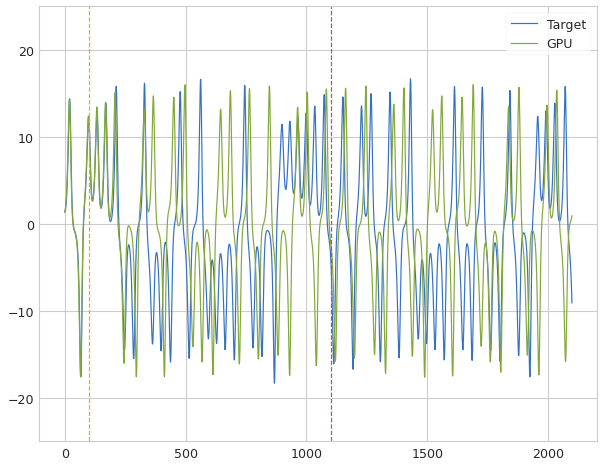

 Iter=2 a=0.537 sr=1.339 amp=1.000  ri=0.015 rr=2.453 loss=1.088250 nrmse=0.264781 CD 0.823469
Iter: 2 #### Time 4.21  NRMSE 0.265 CD 0.823
Iter: 3 #### Time 4.15  NRMSE 0.323 CD 1.059
Iter: 4 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 5 #### Time 4.07  NRMSE 0.334 CD 1.061
Iter: 6 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 7 #### Time 4.53  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.11  NRMSE 1.439 CD 0.963
Iter: 9 #### Time 4.02  NRMSE 0.305 CD 0.896
Dist 0.641983


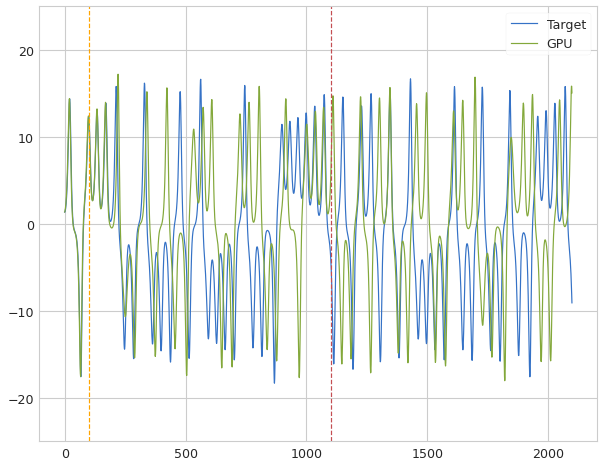

 Iter=10 a=0.725 sr=1.350 amp=1.000  ri=0.061 rr=2.203 loss=0.873458 nrmse=0.231475 CD 0.641983
Iter: 10 #### Time 4.24  NRMSE 0.231 CD 0.642
Iter: 11 #### Time 4.14  NRMSE 0.444 CD 1.029
Iter: 12 #### Time 4.16  NRMSE 0.564 CD 0.972
Iter: 13 #### Time 4.05  NRMSE 0.335 CD 1.060
Iter: 14 #### Time 4.14  NRMSE 0.270 CD 0.838
Iter: 15 #### Time 4.20  NRMSE 0.611 CD 0.983
Iter: 16 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 17 #### Time 4.13  NRMSE 1.435 CD 1.004
Iter: 18 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 19 #### Time 3.98  NRMSE 0.318 CD 0.955
Iter: 20 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.06  NRMSE 0.326 CD 0.874
Iter: 22 #### Time 4.04  NRMSE 0.842 CD 1.035
Iter: 23 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 24 #### Time 4.04  NRMSE 1.258 CD 0.986
Iter: 25 #### Time 4.05  NRMSE 0.321 CD 1.047
Iter: 26 #### Time 4.03  NRMSE 1.076 CD 0.979
Iter: 27 #### Time 4.03  NRMSE 0.338 CD 1.285
Iter: 28 #### Time 4.05  NRMSE 0.955 CD 1.045
Iter: 29 #### Time 4.12  N

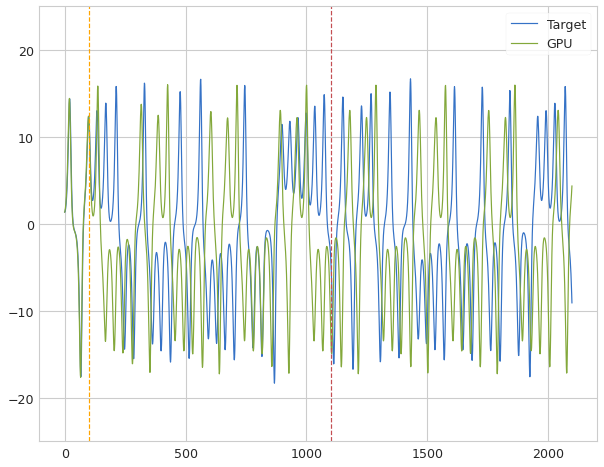

 Iter=11 a=0.734 sr=1.323 amp=1.000  ri=0.082 rr=2.164 loss=1.242632 nrmse=0.291375 CD 0.951257
Iter: 11 #### Time 4.37  NRMSE 0.291 CD 0.951
Iter: 12 #### Time 4.25  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.12  NRMSE 0.304 CD 1.053
Iter: 14 #### Time 4.11  NRMSE 0.741 CD 1.041
Iter: 15 #### Time 4.21  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.13  NRMSE 1.200 CD 1.002
Iter: 17 #### Time 4.25  NRMSE 0.342 CD 1.011
Iter: 18 #### Time 4.23  NRMSE 0.302 CD 0.998
Iter: 19 #### Time 4.25  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.13  NRMSE 0.308 CD 1.070
Iter: 21 #### Time 4.20  NRMSE 0.312 CD 1.136
Iter: 22 #### Time 4.08  NRMSE 0.309 CD 0.870
Iter: 23 #### Time 4.08  NRMSE 0.337 CD 1.069
Iter: 24 #### Time 4.08  NRMSE 0.319 CD 1.066
Iter: 25 #### Time 4.31  NRMSE 1000.000 CD nan
Dist 0.939473


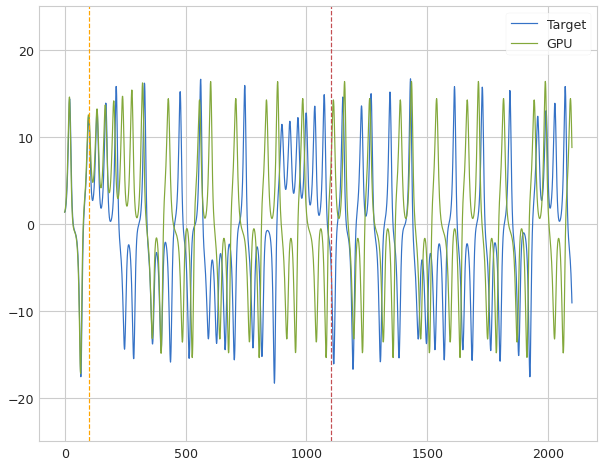

 Iter=26 a=0.894 sr=1.265 amp=1.000  ri=0.040 rr=2.388 loss=1.223062 nrmse=0.283589 CD 0.939473
Iter: 26 #### Time 4.30  NRMSE 0.284 CD 0.939
Iter: 27 #### Time 4.24  NRMSE 0.875 CD 1.006
Iter: 28 #### Time 4.06  NRMSE 0.422 CD 0.957
Iter: 29 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.34  NRMSE 1000.000 CD nan
Iter: 31 #### Time 4.03  NRMSE 0.764 CD 0.953
Iter: 32 #### Time 4.06  NRMSE 384.160 CD 1.128
Iter: 33 #### Time 4.03  NRMSE 3.232 CD 0.986
Iter: 34 #### Time 4.25  NRMSE 1000.000 CD nan
Iter: 35 #### Time 4.10  NRMSE 0.321 CD 1.058
Iter: 36 #### Time 4.05  NRMSE 0.298 CD 1.065
Iter: 37 #### Time 3.98  NRMSE 0.291 CD 1.001
Iter: 38 #### Time 4.02  NRMSE 0.637 CD 1.008
Iter: 39 #### Time 4.07  NRMSE 0.298 CD 0.970
Iter: 40 #### Time 4.04  NRMSE 0.619 CD 1.011
Iter: 41 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 42 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 43 #### Time 4.10  NRMSE 0.359 CD 1.146
Dist 0.799021


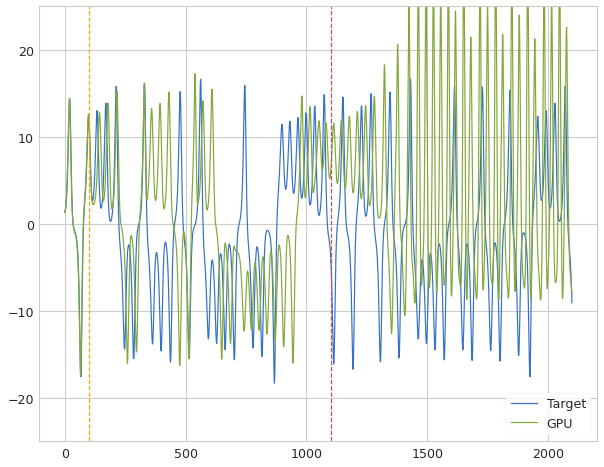

 Iter=44 a=0.809 sr=1.229 amp=1.000  ri=0.078 rr=2.358 loss=1.065436 nrmse=0.266415 CD 0.799021
Iter: 44 #### Time 4.16  NRMSE 0.266 CD 0.799
Iter: 45 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 46 #### Time 4.07  NRMSE 0.286 CD 0.960
Iter: 47 #### Time 4.12  NRMSE 0.311 CD 1.068
Iter: 48 #### Time 4.23  NRMSE 4.821 CD 1.086
Iter: 49 #### Time 4.15  NRMSE 2.052 CD 0.925
Iter: 50 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 51 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 52 #### Time 4.07  NRMSE 1.382 CD 0.998
Iter: 53 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 54 #### Time 4.12  NRMSE 0.297 CD 1.040
Iter: 55 #### Time 4.12  NRMSE 0.310 CD 1.064
Iter: 56 #### Time 4.55  NRMSE 1.216 CD 0.978
Iter: 57 #### Time 4.28  NRMSE 1000.000 CD nan
Iter: 58 #### Time 4.06  NRMSE 0.446 CD 1.088
Iter: 59 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 60 #### Time 4.15  NRMSE 0.309 CD 1.043
Iter: 61 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 62 #### Time 4.05  NRMSE 0.326 CD 1.092
Iter: 63 #### Time 4.09

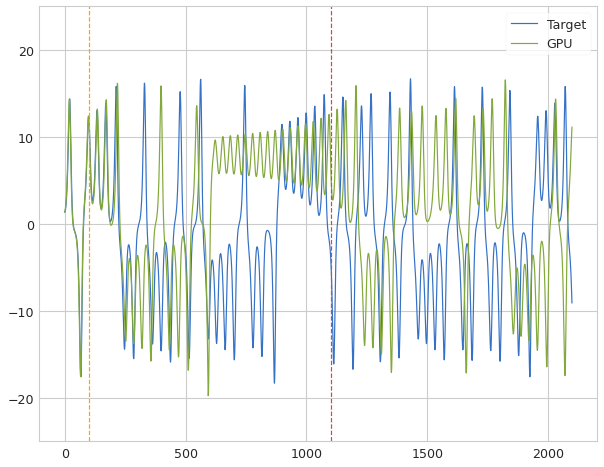

 Iter=94 a=0.847 sr=1.332 amp=1.000  ri=0.059 rr=2.130 loss=1.009045 nrmse=0.256517 CD 0.752528
Iter: 94 #### Time 4.22  NRMSE 0.257 CD 0.753
Iter: 95 #### Time 4.00  NRMSE 0.305 CD 0.889
Iter: 96 #### Time 4.07  NRMSE 1671767667042933504.000 CD 1.000
Iter: 97 #### Time 4.04  NRMSE 0.484 CD 1.018
Iter: 98 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 99 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 100 #### Time 4.09  NRMSE 0.741 CD 1.011
Iter: 101 #### Time 4.05  NRMSE 1.251 CD 1.020
Iter: 102 #### Time 4.12  NRMSE 0.297 CD 1.000
Iter: 103 #### Time 4.11  NRMSE 0.311 CD 1.068
Iter: 104 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 105 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 106 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 107 #### Time 4.07  NRMSE 0.338 CD 1.095
Iter: 108 #### Time 4.07  NRMSE 0.401 CD 0.866
Iter: 109 #### Time 3.99  NRMSE 0.388 CD 0.925
Iter: 110 #### Time 4.03  NRMSE 0.353 CD 1.114
Iter: 111 #### Time 4.05  NRMSE 1.043 CD 0.944
Iter: 112 #### Time 4.08  NRMSE 0.340 CD 

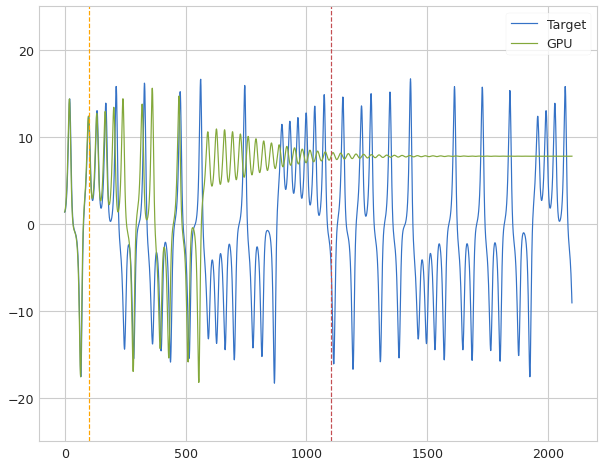

 Iter=1 a=0.683 sr=1.308 amp=1.000  ri=0.033 rr=2.750 loss=1.101112 nrmse=0.266092 CD 0.835020
Iter: 1 #### Time 4.29  NRMSE 0.266 CD 0.835
Iter: 2 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 3 #### Time 4.04  NRMSE 0.301 CD 0.967
Iter: 4 #### Time 4.05  NRMSE 0.675 CD 1.005
Iter: 5 #### Time 4.04  NRMSE 0.692 CD 1.018
Iter: 6 #### Time 4.01  NRMSE 0.285 CD 0.923
Iter: 7 #### Time 4.02  NRMSE 0.305 CD 1.011
Iter: 8 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 9 #### Time 4.06  NRMSE 0.309 CD 1.050
Iter: 10 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.00  NRMSE 0.283 CD 0.913
Iter: 12 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.07  NRMSE 0.315 CD 1.062
Iter: 14 #### Time 4.19  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.01  NRMSE 0.278 CD 0.834
Iter: 16 #### Time 4.07  NRMSE 1.945 CD 0.996
Iter: 17 #### Time 4.06  NRMSE 1.471 CD 1.114
Iter: 18 #### Time 4.08  NRMSE 2.205 CD 1.028
Iter: 19 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.07  NRMSE 0.3

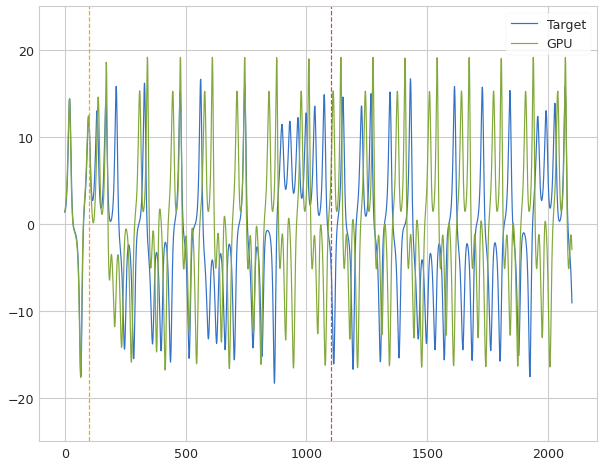

 Iter=58 a=0.595 sr=1.325 amp=1.000  ri=0.090 rr=2.832 loss=1.082853 nrmse=0.271373 CD 0.811480
Iter: 58 #### Time 4.14  NRMSE 0.271 CD 0.811
Iter: 59 #### Time 4.02  NRMSE 1.781 CD 0.997
Dist 0.694576


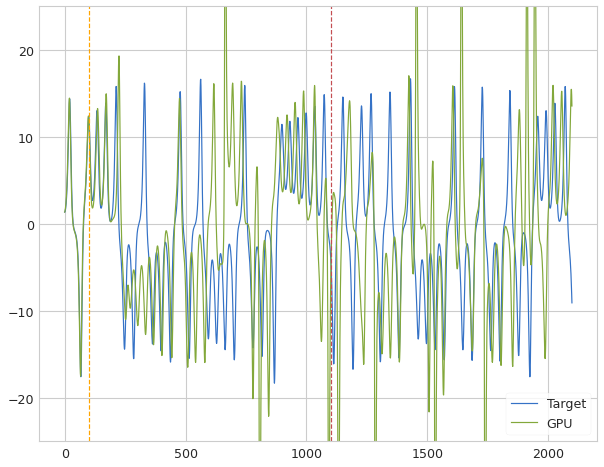

 Iter=60 a=0.779 sr=1.300 amp=1.000  ri=0.061 rr=2.397 loss=0.983826 nrmse=0.289250 CD 0.694576
Iter: 60 #### Time 4.13  NRMSE 0.289 CD 0.695
Iter: 61 #### Time 4.03  NRMSE 0.210 CD 0.941
Iter: 62 #### Time 4.02  NRMSE 0.302 CD 1.066
Iter: 63 #### Time 4.12  NRMSE 0.262 CD 0.797
Iter: 64 #### Time 4.04  NRMSE 173.671 CD 1.000
Iter: 65 #### Time 4.00  NRMSE 0.307 CD 1.052
Iter: 66 #### Time 4.02  NRMSE 0.287 CD 0.947
Iter: 67 #### Time 4.00  NRMSE 0.725 CD 1.069
Iter: 68 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 69 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 70 #### Time 4.05  NRMSE 0.441 CD 0.992
Iter: 71 #### Time 4.07  NRMSE 0.398 CD 1.139
Iter: 72 #### Time 4.00  NRMSE 1.058 CD 0.997
Iter: 73 #### Time 4.13  NRMSE 0.326 CD 0.949
Iter: 74 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 75 #### Time 4.33  NRMSE 1000.000 CD nan
Iter: 76 #### Time 4.20  NRMSE 0.314 CD 0.861
Iter: 77 #### Time 4.04  NRMSE 0.292 CD 0.898
Iter: 78 #### Time 4.08  NRMSE 5.403 CD 0.890
Iter: 79 #### Time 4.23 

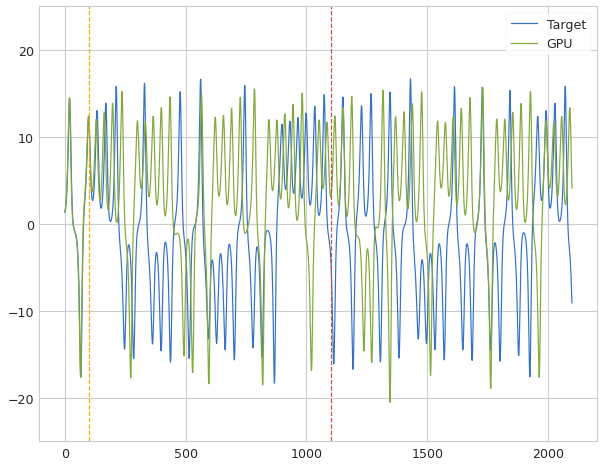

 Iter=2 a=0.537 sr=1.378 amp=1.000  ri=0.072 rr=2.518 loss=1.237071 nrmse=0.286531 CD 0.950540
Iter: 2 #### Time 5.07  NRMSE 0.287 CD 0.951
Iter: 3 #### Time 4.10  NRMSE 1.914 CD 0.999
Iter: 4 #### Time 4.05  NRMSE 0.309 CD 1.062
Iter: 5 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 6 #### Time 4.27  NRMSE 1000.000 CD nan
Iter: 7 #### Time 4.06  NRMSE 1.308 CD 0.998
Iter: 8 #### Time 4.03  NRMSE 0.318 CD 0.989
Iter: 9 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 10 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 11 #### Time 4.10  NRMSE 1.439 CD 0.999
Iter: 12 #### Time 4.05  NRMSE 0.333 CD 1.073
Dist 0.945502


New N best!!!!!!!!!!!!


[30, 0, 0, 13]


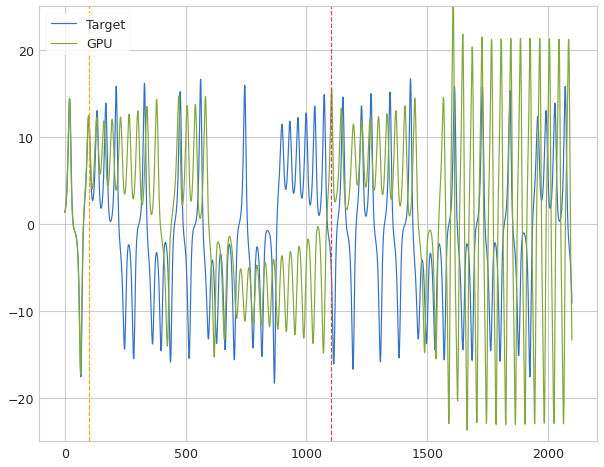

 Iter=13 a=0.605 sr=1.395 amp=1.000  ri=0.067 rr=2.994 loss=1.231570 nrmse=0.286068 CD 0.945502
Iter: 13 #### Time 4.86  NRMSE 0.286 CD 0.946
Iter: 14 #### Time 4.04  NRMSE 0.295 CD 1.063
Dist 0.806978


New N best!!!!!!!!!!!!


[30, 0, 0, 15]


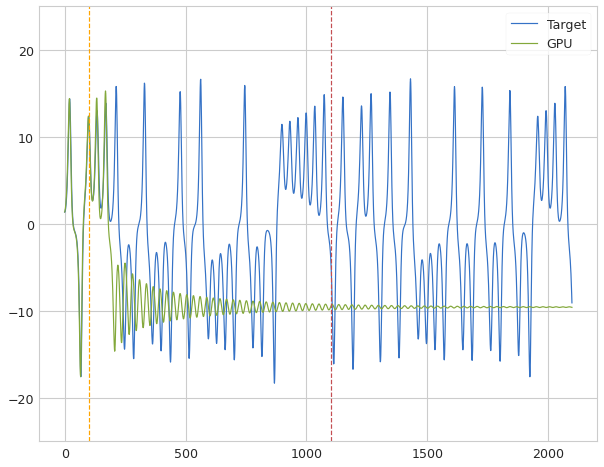

 Iter=15 a=0.634 sr=1.300 amp=1.000  ri=0.072 rr=2.372 loss=1.096608 nrmse=0.289630 CD 0.806978
Iter: 15 #### Time 4.97  NRMSE 0.290 CD 0.807
Iter: 16 #### Time 4.03  NRMSE 0.299 CD 1.059
Iter: 17 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.11  NRMSE 1000.000 CD nan
Iter: 20 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.27  NRMSE 0.324 CD 1.040
Iter: 22 #### Time 4.02  NRMSE 11.885 CD 0.884
Iter: 23 #### Time 4.11  NRMSE 0.291 CD 1.087
Iter: 24 #### Time 4.05  NRMSE 0.284 CD 0.937
Iter: 25 #### Time 4.16  NRMSE 0.284 CD 0.911
Iter: 26 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 27 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 28 #### Time 4.04  NRMSE 0.338 CD 1.051
Iter: 29 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.05  NRMSE 0.301 CD 1.001
Iter: 31 #### Time 4.02  NRMSE 0.328 CD 1.066
Iter: 32 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 33 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 34 #### Time 4

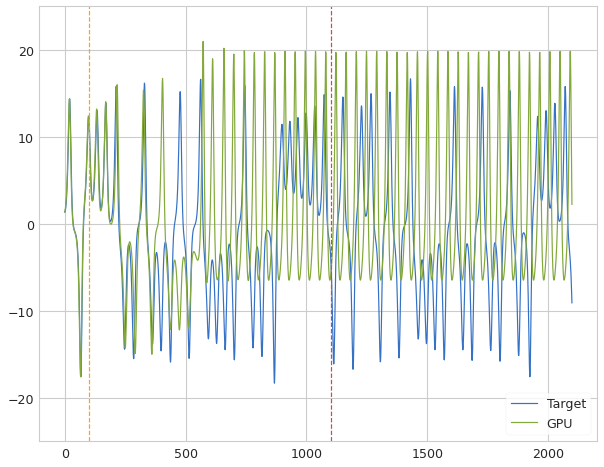

 Iter=69 a=0.844 sr=1.212 amp=1.000  ri=0.060 rr=2.618 loss=1.010875 nrmse=0.261375 CD 0.749500
Iter: 69 #### Time 4.94  NRMSE 0.261 CD 0.750
Iter: 70 #### Time 4.01  NRMSE 0.373 CD 1.094
Iter: 71 #### Time 4.06  NRMSE 26.577 CD 1.010
Iter: 72 #### Time 4.09  NRMSE 0.306 CD 1.055
Iter: 73 #### Time 4.05  NRMSE 0.324 CD 1.142
Iter: 74 #### Time 4.03  NRMSE 0.301 CD 1.070
Iter: 75 #### Time 4.15  NRMSE 7.164 CD 1.142
Iter: 76 #### Time 4.07  NRMSE 0.302 CD 1.056
Iter: 77 #### Time 4.06  NRMSE 0.371 CD 1.013
Iter: 78 #### Time 4.06  NRMSE 0.301 CD 1.055
Iter: 79 #### Time 4.07  NRMSE 0.324 CD 1.058
Iter: 80 #### Time 4.08  NRMSE 0.320 CD 1.062
Iter: 81 #### Time 4.08  NRMSE 0.266 CD 0.954
Iter: 82 #### Time 4.05  NRMSE 0.304 CD 1.062
Iter: 83 #### Time 4.08  NRMSE 0.380 CD 0.937
Iter: 84 #### Time 4.03  NRMSE 0.935 CD 1.014
Iter: 85 #### Time 4.17  NRMSE 0.420 CD 1.143
Iter: 86 #### Time 4.05  NRMSE 0.308 CD 1.011
Iter: 87 #### Time 4.08  NRMSE 0.313 CD 1.070
Iter: 88 #### Time 4.21  NRMS

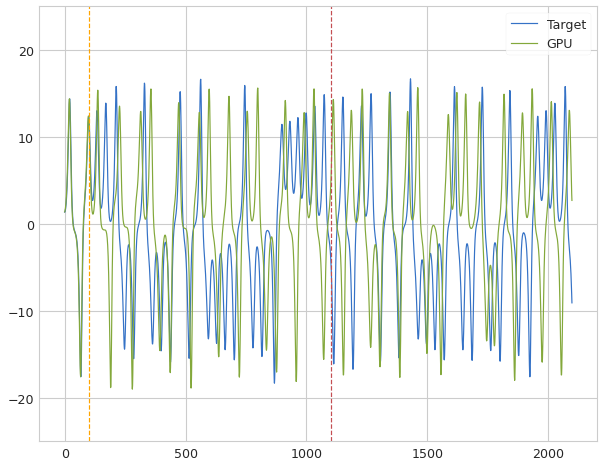

 Iter=121 a=0.524 sr=1.322 amp=1.000  ri=0.025 rr=2.830 loss=0.989855 nrmse=0.249229 CD 0.740626
Iter: 121 #### Time 4.93  NRMSE 0.249 CD 0.741
Iter: 122 #### Time 4.06  NRMSE 0.440 CD 1.102
Iter: 123 #### Time 4.15  NRMSE 0.305 CD 0.925
Iter: 124 #### Time 4.11  NRMSE 18.098 CD 0.909
Iter: 125 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 126 #### Time 4.12  NRMSE 1000.000 CD nan
Iter: 127 #### Time 4.08  NRMSE 0.281 CD 0.983
Iter: 128 #### Time 4.10  NRMSE 0.278 CD 0.993
Iter: 129 #### Time 4.10  NRMSE 0.292 CD 1.052
Iter: 130 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 131 #### Time 4.05  NRMSE 0.290 CD 0.903
Iter: 132 #### Time 4.33  NRMSE 0.296 CD 0.988
Iter: 133 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 134 #### Time 4.17  NRMSE 0.343 CD 0.915
Iter: 135 #### Time 4.10  NRMSE 0.293 CD 0.955
Iter: 136 #### Time 4.19  NRMSE 0.295 CD 1.064
Iter: 137 #### Time 4.08  NRMSE 1.130 CD 0.965
Iter: 138 #### Time 4.05  NRMSE 0.309 CD 1.141
Iter: 139 #### Time 4.29  NRMSE 0.266 CD 0.905
Iter:

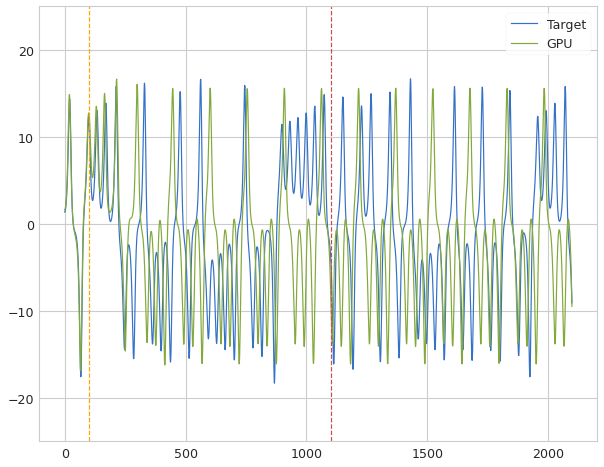

 Iter=11 a=0.842 sr=1.317 amp=1.000  ri=0.093 rr=2.556 loss=1.112956 nrmse=0.267662 CD 0.845294
Iter: 11 #### Time 4.12  NRMSE 0.268 CD 0.845
Iter: 12 #### Time 4.13  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.00  NRMSE 0.324 CD 1.063
Iter: 14 #### Time 4.01  NRMSE 0.318 CD 1.064
Iter: 15 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.03  NRMSE 2.124 CD 0.997
Iter: 17 #### Time 4.15  NRMSE 1000.000 CD nan
Iter: 18 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.30  NRMSE 0.576 CD 0.958
Iter: 20 #### Time 4.27  NRMSE 1000.000 CD nan
Iter: 21 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 22 #### Time 4.23  NRMSE 1000.000 CD nan
Iter: 23 #### Time 4.01  NRMSE 0.874 CD 1.077
Iter: 24 #### Time 4.08  NRMSE 5.079 CD 0.998
Iter: 25 #### Time 4.15  NRMSE 0.347 CD 1.040
Iter: 26 #### Time 4.03  NRMSE 0.471 CD 0.957
Iter: 27 #### Time 4.19  NRMSE 0.312 CD 1.058
Iter: 28 #### Time 4.07  NRMSE 38.247 CD 1.109
Iter: 29 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.

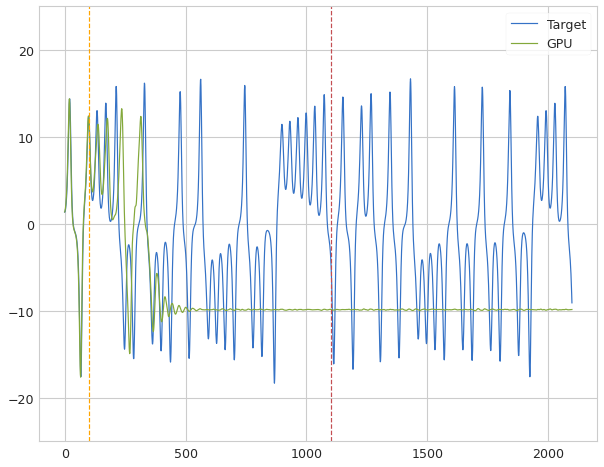

 Iter=68 a=0.669 sr=1.335 amp=1.000  ri=0.006 rr=2.446 loss=1.087190 nrmse=0.286084 CD 0.801106
Iter: 68 #### Time 4.15  NRMSE 0.286 CD 0.801
Iter: 69 #### Time 4.01  NRMSE 17.910 CD 1.097
Iter: 70 #### Time 4.03  NRMSE 0.929 CD 1.061
Iter: 71 #### Time 4.07  NRMSE 0.291 CD 0.998
Iter: 72 #### Time 4.04  NRMSE 1000.000 CD nan
Iter: 73 #### Time 4.09  NRMSE 0.782 CD 1.083
Dist 0.767128


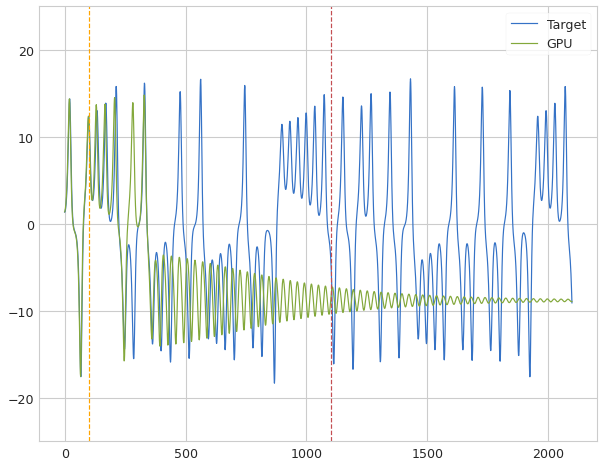

 Iter=74 a=0.677 sr=1.378 amp=1.000  ri=0.084 rr=2.707 loss=1.034821 nrmse=0.267694 CD 0.767128
Iter: 74 #### Time 4.23  NRMSE 0.268 CD 0.767
Iter: 75 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 76 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 77 #### Time 4.03  NRMSE 1000.000 CD nan
Iter: 78 #### Time 4.09  NRMSE 0.326 CD 1.066
Iter: 79 #### Time 4.08  NRMSE 0.314 CD 1.042
Iter: 80 #### Time 4.17  NRMSE 1000.000 CD nan
Iter: 81 #### Time 4.05  NRMSE 0.434 CD 1.119
Iter: 82 #### Time 4.03  NRMSE 0.290 CD 1.055
Iter: 83 #### Time 4.05  NRMSE 1.885 CD 1.120
Iter: 84 #### Time 4.02  NRMSE 2.815 CD 1.001
Iter: 85 #### Time 4.06  NRMSE 0.311 CD 1.076
Iter: 86 #### Time 4.05  NRMSE 0.299 CD 1.074
Iter: 87 #### Time 4.04  NRMSE 0.272 CD 0.828
Iter: 88 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 89 #### Time 4.12  NRMSE 0.343 CD 0.993
Iter: 90 #### Time 4.10  NRMSE 0.308 CD 1.054
Iter: 91 #### Time 4.01  NRMSE 0.463 CD 1.052
Iter: 92 #### Time 4.01  NRMSE 1.923 CD 0.828
Iter: 93 #### Time 4.01  

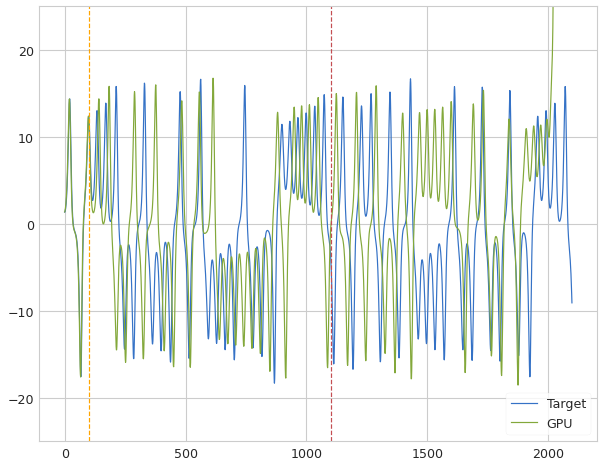

 Iter=130 a=0.556 sr=1.322 amp=1.000  ri=0.053 rr=2.317 loss=1.011554 nrmse=0.258421 CD 0.753133
Iter: 130 #### Time 4.37  NRMSE 0.258 CD 0.753
Iter: 131 #### Time 4.10  NRMSE 1000.000 CD nan
Iter: 132 #### Time 4.22  NRMSE 1.220 CD 0.950
Iter: 133 #### Time 4.09  NRMSE 1.085 CD 1.000
Iter: 134 #### Time 4.09  NRMSE 1.979 CD 0.998
Iter: 135 #### Time 4.05  NRMSE 0.287 CD 0.932
Iter: 136 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 137 #### Time 4.14  NRMSE 0.631 CD 0.924
Iter: 138 #### Time 4.07  NRMSE 0.296 CD 1.016
Iter: 139 #### Time 4.15  NRMSE 0.389 CD 0.979
Iter: 140 #### Time 4.07  NRMSE 0.319 CD 1.068
Iter: 141 #### Time 4.28  NRMSE 0.285 CD 0.921
Iter: 142 #### Time 4.08  NRMSE 0.585 CD 0.904
Iter: 143 #### Time 4.21  NRMSE 0.338 CD 1.277
Iter: 144 #### Time 4.14  NRMSE 0.907 CD 0.997
Iter: 145 #### Time 4.04  NRMSE 0.309 CD 1.027
Iter: 146 #### Time 4.15  NRMSE 0.303 CD 1.067
Iter: 147 #### Time 4.20  NRMSE 1.537 CD 1.010
Iter: 148 #### Time 4.23  NRMSE 0.311 CD 1.054
Iter: 14

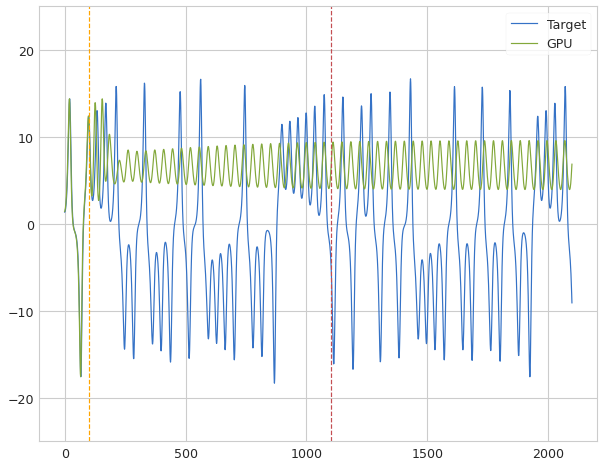

 Iter=8 a=0.824 sr=1.280 amp=1.000  ri=0.043 rr=2.414 loss=1.307668 nrmse=0.278390 CD 1.029279
Iter: 8 #### Time 4.47  NRMSE 0.278 CD 1.029
Iter: 9 #### Time 4.39  NRMSE 0.328 CD 1.078
Iter: 10 #### Time 4.04  NRMSE 0.376 CD 0.982
Dist 0.941053


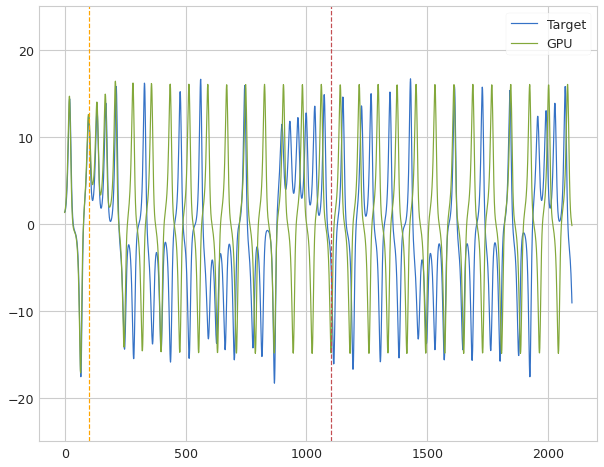

 Iter=11 a=0.761 sr=1.333 amp=1.000  ri=0.087 rr=2.811 loss=1.226074 nrmse=0.285021 CD 0.941053
Iter: 11 #### Time 4.20  NRMSE 0.285 CD 0.941
Iter: 12 #### Time 4.05  NRMSE 0.932 CD 0.992
Iter: 13 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 14 #### Time 4.04  NRMSE 0.424 CD 0.974
Iter: 15 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 16 #### Time 4.07  NRMSE 0.626 CD 1.074
Iter: 17 #### Time 4.05  NRMSE 0.331 CD 1.072
Iter: 18 #### Time 4.07  NRMSE 1000.000 CD nan
Dist 0.872335


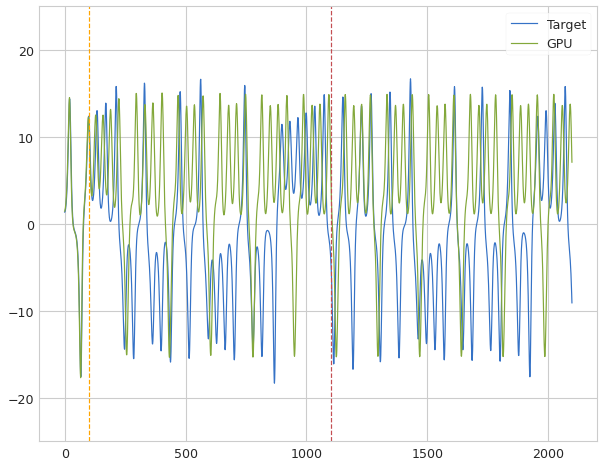

 Iter=19 a=0.611 sr=1.235 amp=1.000  ri=0.099 rr=2.693 loss=1.152898 nrmse=0.280563 CD 0.872335
Iter: 19 #### Time 4.14  NRMSE 0.281 CD 0.872
Iter: 20 #### Time 4.09  NRMSE 0.308 CD 1.036
Dist 0.636511


New N best!!!!!!!!!!!!


[30, 0, 2, 21]


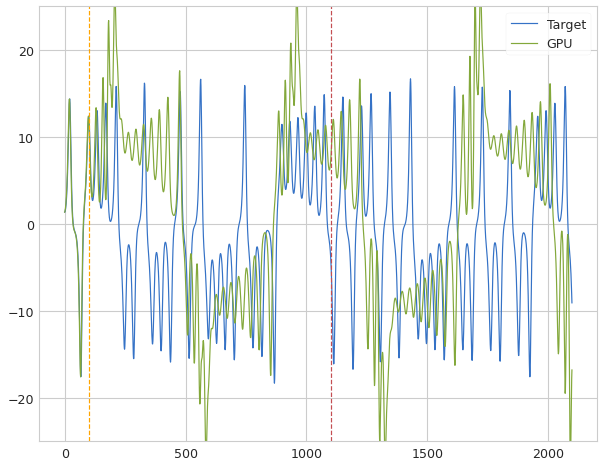

 Iter=21 a=0.632 sr=1.272 amp=1.000  ri=0.053 rr=2.425 loss=0.924760 nrmse=0.288249 CD 0.636511
Iter: 21 #### Time 4.91  NRMSE 0.288 CD 0.637
Iter: 22 #### Time 4.05  NRMSE 0.371 CD 0.947
Iter: 23 #### Time 4.11  NRMSE 0.712 CD 1.100
Iter: 24 #### Time 4.06  NRMSE 0.270 CD 0.829
Iter: 25 #### Time 4.05  NRMSE 1000.000 CD nan
Iter: 26 #### Time 4.09  NRMSE 2.059 CD 0.995
Iter: 27 #### Time 4.01  NRMSE 0.627 CD 1.059
Iter: 28 #### Time 4.02  NRMSE 0.311 CD 1.060
Iter: 29 #### Time 4.07  NRMSE 1000.000 CD nan
Iter: 30 #### Time 4.02  NRMSE 8.817 CD 0.921
Iter: 31 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 32 #### Time 4.03  NRMSE 0.278 CD 0.913
Iter: 33 #### Time 4.09  NRMSE 0.472 CD 0.936
Iter: 34 #### Time 4.23  NRMSE 0.300 CD 1.006
Iter: 35 #### Time 4.05  NRMSE 0.306 CD 1.083
Iter: 36 #### Time 4.14  NRMSE 1000.000 CD nan
Iter: 37 #### Time 4.16  NRMSE 1000.000 CD nan
Iter: 38 #### Time 4.16  NRMSE 0.467 CD 1.028
Iter: 39 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 40 #### Time 4.14 

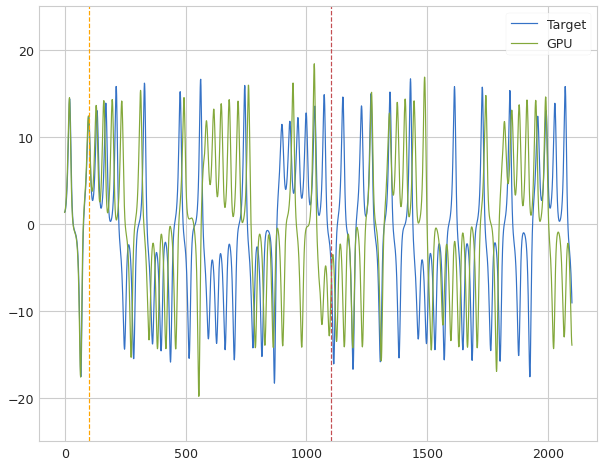

 Iter=6 a=0.638 sr=1.389 amp=1.000  ri=0.092 rr=2.953 loss=1.209490 nrmse=0.283941 CD 0.925550
Iter: 6 #### Time 4.23  NRMSE 0.284 CD 0.926
Iter: 7 #### Time 4.08  NRMSE 1000.000 CD nan
Iter: 8 #### Time 4.06  NRMSE 1000.000 CD nan
Iter: 9 #### Time 4.04  NRMSE 0.932 CD 1.160
Iter: 10 #### Time 4.05  NRMSE 1.656 CD 0.994
Iter: 11 #### Time 4.06  NRMSE 0.337 CD 0.856
Iter: 12 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 13 #### Time 4.10  NRMSE 0.310 CD 1.035
Iter: 14 #### Time 4.06  NRMSE 3.234 CD 0.893
Dist 0.917694


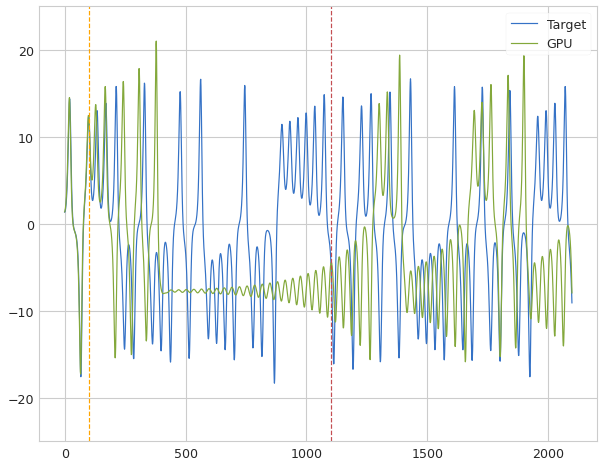

 Iter=15 a=0.673 sr=1.293 amp=1.000  ri=0.071 rr=2.038 loss=1.200684 nrmse=0.282989 CD 0.917694
Iter: 15 #### Time 4.25  NRMSE 0.283 CD 0.918
Iter: 16 #### Time 4.39  NRMSE 2.314 CD 1.000
Iter: 17 #### Time 4.06  NRMSE 0.476 CD 0.924
Iter: 18 #### Time 4.17  NRMSE 0.303 CD 0.987
Dist 0.904366


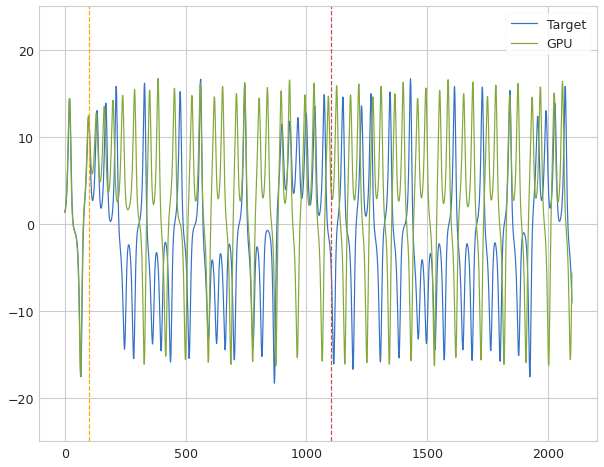

 Iter=19 a=0.856 sr=1.237 amp=1.000  ri=0.032 rr=2.074 loss=1.197694 nrmse=0.293329 CD 0.904366
Iter: 19 #### Time 4.20  NRMSE 0.293 CD 0.904
Dist 0.741181


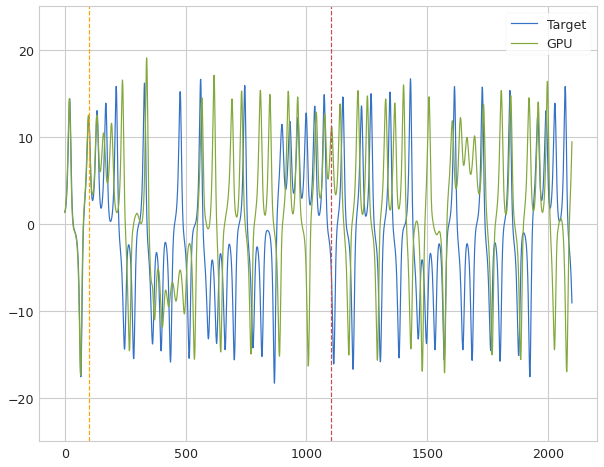

 Iter=20 a=0.630 sr=1.387 amp=1.000  ri=0.094 rr=2.084 loss=0.992447 nrmse=0.251266 CD 0.741181
Iter: 20 #### Time 4.24  NRMSE 0.251 CD 0.741
Iter: 21 #### Time 4.07  NRMSE 1.202 CD 0.982
Iter: 22 #### Time 4.07  NRMSE 0.478 CD 1.161
Iter: 23 #### Time 4.10  NRMSE 0.287 CD 0.935
Iter: 24 #### Time 4.03  NRMSE 3.151 CD 0.928
Iter: 25 #### Time 4.07  NRMSE 0.315 CD 1.089
Iter: 26 #### Time 4.06  NRMSE 0.366 CD 1.004
Iter: 27 #### Time 4.27  NRMSE 1000.000 CD nan
Iter: 28 #### Time 4.04  NRMSE 0.312 CD 1.039
Iter: 29 #### Time 4.10  NRMSE 0.273 CD 0.867
Iter: 30 #### Time 4.09  NRMSE 1000.000 CD nan
Iter: 31 #### Time 4.05  NRMSE 1.575 CD 1.101
Iter: 32 #### Time 4.11  NRMSE 0.328 CD 1.059
Iter: 33 #### Time 4.12  NRMSE 1.197 CD 1.001
Iter: 34 #### Time 4.04  NRMSE 1.984 CD 0.999
Iter: 35 #### Time 4.06  NRMSE 0.309 CD 1.111
Iter: 36 #### Time 4.15  NRMSE 18.618 CD 1.001
Iter: 37 #### Time 4.10  NRMSE 3.405 CD 1.162
Iter: 38 #### Time 4.04  NRMSE 3.121 CD 1.001
Iter: 39 #### Time 3.99  NR

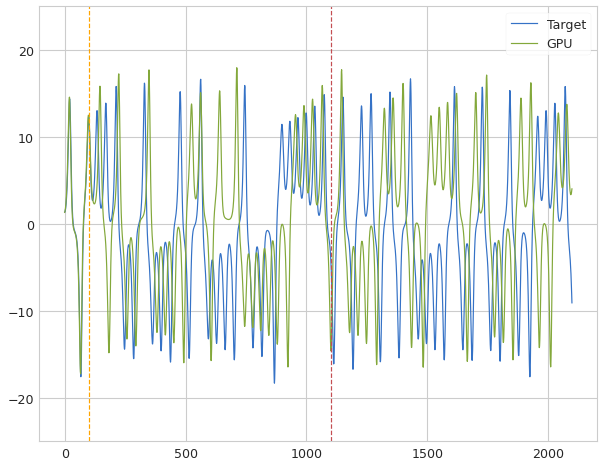

 Iter=91 a=0.689 sr=1.216 amp=1.000  ri=0.075 rr=2.670 loss=0.991036 nrmse=0.250278 CD 0.740758
Iter: 91 #### Time 4.25  NRMSE 0.250 CD 0.741
Iter: 92 #### Time 4.02  NRMSE 0.322 CD 1.063
Iter: 93 #### Time 4.01  NRMSE 1000.000 CD nan
Iter: 94 #### Time 4.03  NRMSE 1.010 CD 0.961
Iter: 95 #### Time 4.01  NRMSE 0.268 CD 0.807
Iter: 96 #### Time 4.06  NRMSE 0.280 CD 1.074
Iter: 97 #### Time 3.99  NRMSE 0.303 CD 1.103
Iter: 98 #### Time 4.37  NRMSE 0.889 CD 0.981
Iter: 99 #### Time 4.24  NRMSE 5.952 CD 0.998
Iter: 100 #### Time 4.22  NRMSE 5.856 CD 1.114
Iter: 101 #### Time 4.13  NRMSE 0.288 CD 0.884
Iter: 102 #### Time 4.04  NRMSE 0.302 CD 0.949
Iter: 103 #### Time 4.08  NRMSE 0.282 CD 0.908
Iter: 104 #### Time 4.03  NRMSE 0.398 CD 0.955
Iter: 105 #### Time 4.19  NRMSE 0.318 CD 1.080
Iter: 106 #### Time 4.06  NRMSE 0.654 CD 1.103
Iter: 107 #### Time 4.08  NRMSE 1.773 CD 0.998
Iter: 108 #### Time 4.13  NRMSE 2.903 CD 1.006
Iter: 109 #### Time 4.09  NRMSE 0.282 CD 0.925
Iter: 110 #### Time

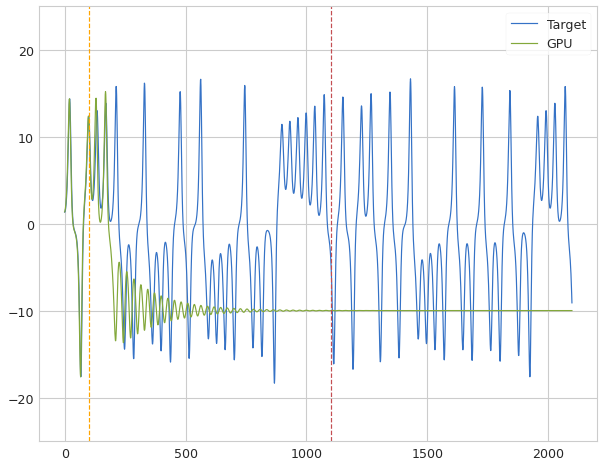

 Iter=0 a=0.896 sr=1.296 amp=1.000  ri=0.057 rr=2.929 loss=1.108708 nrmse=0.296653 CD 0.812056
Iter: 0 #### Time 4.23  NRMSE 0.297 CD 0.812
Iter: 1 #### Time 3.98  NRMSE 1000.000 CD nan
Iter: 2 #### Time 4.03  NRMSE 1.281 CD 1.021
Iter: 3 #### Time 4.01  NRMSE 0.266 CD 0.849
Iter: 4 #### Time 3.97  NRMSE 0.281 CD 0.913
Iter: 5 #### Time 4.23  NRMSE 0.326 CD 1.066
Iter: 6 #### Time 4.19  NRMSE 0.337 CD 1.061
Dist 0.732384


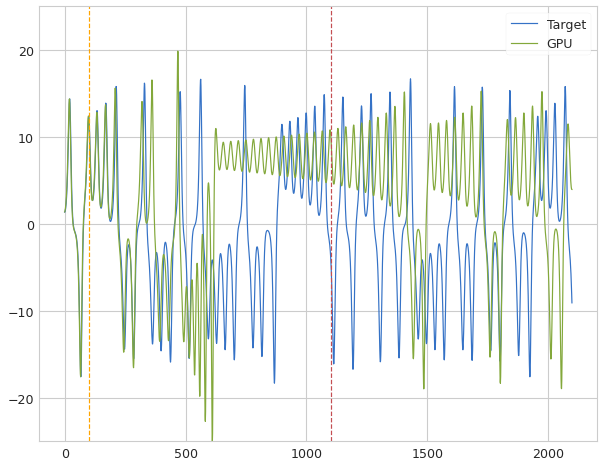

 Iter=7 a=0.528 sr=1.268 amp=1.000  ri=0.092 rr=2.247 loss=0.994079 nrmse=0.261695 CD 0.732384
Iter: 7 #### Time 4.10  NRMSE 0.262 CD 0.732
Iter: 8 #### Time 4.02  NRMSE 1.515 CD 0.958
Iter: 9 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 10 #### Time 4.01  NRMSE 2.449 CD 1.160
Iter: 11 #### Time 3.96  NRMSE 0.301 CD 1.037
Iter: 12 #### Time 3.94  NRMSE 0.337 CD 1.029
Iter: 13 #### Time 3.98  NRMSE 1.146 CD 0.994
Iter: 14 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 15 #### Time 4.02  NRMSE 0.314 CD 1.066
Iter: 16 #### Time 4.00  NRMSE 0.262 CD 0.823
Iter: 17 #### Time 3.97  NRMSE 0.924 CD 0.953
Iter: 18 #### Time 4.02  NRMSE 1000.000 CD nan
Iter: 19 #### Time 4.02  NRMSE 0.284 CD 0.871
Iter: 20 #### Time 4.15  NRMSE 2.407 CD 0.985
Iter: 21 #### Time 3.94  NRMSE 0.311 CD 1.086
Iter: 22 #### Time 3.95  NRMSE 1000.000 CD nan
Iter: 23 #### Time 3.91  NRMSE 0.306 CD 1.007
Iter: 24 #### Time 3.92  NRMSE 3.477 CD 0.910
Iter: 25 #### Time 3.93  NRMSE 0.291 CD 0.982
Iter: 26 #### Time 3.92  NRMSE

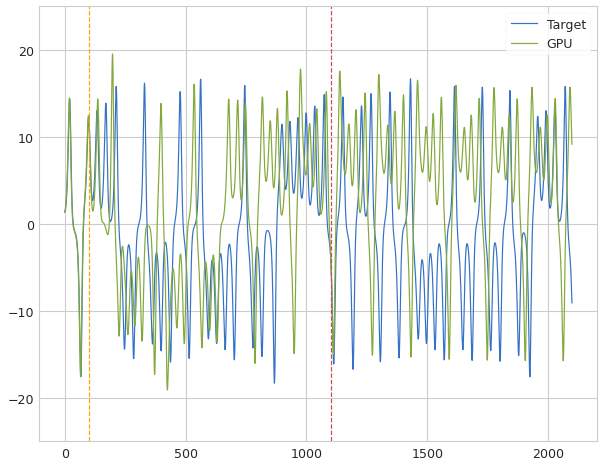

 Iter=1 a=0.542 sr=1.245 amp=1.000  ri=0.090 rr=2.826 loss=1.058331 nrmse=0.268426 CD 0.789905
Iter: 1 #### Time 4.09  NRMSE 0.268 CD 0.790
Iter: 2 #### Time 3.95  NRMSE 0.310 CD 1.110
Iter: 3 #### Time 3.94  NRMSE 6.261 CD 0.841
Iter: 4 #### Time 3.90  NRMSE 2.857 CD 0.925
Iter: 5 #### Time 5.19  NRMSE 3.577 CD 0.913
Iter: 6 #### Time 5.24  NRMSE 0.513 CD 0.928
Iter: 7 #### Time 5.21  NRMSE 0.906 CD 0.990
Iter: 8 #### Time 5.26  NRMSE 1000.000 CD nan
Iter: 9 #### Time 5.22  NRMSE 0.321 CD 1.079
Dist 0.739782


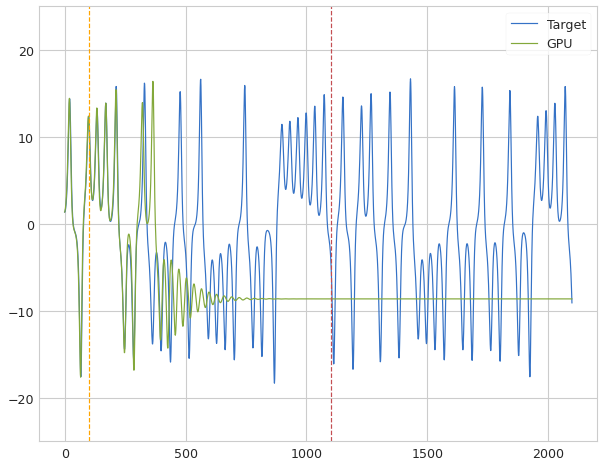

 Iter=10 a=0.517 sr=1.239 amp=1.000  ri=0.048 rr=2.037 loss=1.001258 nrmse=0.261477 CD 0.739782
Iter: 10 #### Time 5.37  NRMSE 0.261 CD 0.740
Iter: 11 #### Time 5.21  NRMSE 0.282 CD 0.968
Iter: 12 #### Time 4.61  NRMSE 0.294 CD 0.832
Iter: 13 #### Time 5.20  NRMSE 0.270 CD 0.851
Iter: 14 #### Time 5.20  NRMSE 0.979 CD 0.949
Iter: 15 #### Time 5.21  NRMSE 0.954 CD 1.007
Iter: 16 #### Time 5.22  NRMSE 0.305 CD 1.023
Iter: 17 #### Time 5.24  NRMSE 0.292 CD 1.007
Iter: 18 #### Time 5.20  NRMSE 0.283 CD 0.961
Iter: 19 #### Time 5.25  NRMSE 1000.000 CD nan
Iter: 20 #### Time 5.20  NRMSE 0.299 CD 1.065
Iter: 21 #### Time 5.27  NRMSE 0.348 CD 0.985
Iter: 22 #### Time 5.25  NRMSE 1000.000 CD nan
Iter: 23 #### Time 5.22  NRMSE 0.286 CD 1.029
Iter: 24 #### Time 5.21  NRMSE 0.297 CD 0.901
Iter: 25 #### Time 5.37  NRMSE 0.313 CD 1.043
Iter: 26 #### Time 5.23  NRMSE 1000.000 CD nan
Iter: 27 #### Time 5.56  NRMSE 0.283 CD 0.940
Iter: 28 #### Time 5.19  NRMSE 0.302 CD 1.068
Iter: 29 #### Time 5.20  NR

In [ ]:
CALLS = 150
s = torch.torch.from_numpy(signal).cuda(DEVICE).type(dtype)
# Skipped 1000, 900
size = [50,40,30,20,10]
rand_state = [11,37,3,24,91]

dict_counters = {}
dict_model = {}
for N in size:
    model_counter = 0
    error_per_N = []
    best_N_model = [N,0,0,0]
    
    min_a, max_a = .5, .9
    min_sr, max_sr = 1.2, 1.4
    min_g, max_g = .4, 1.1
    min_ri, max_ri = .001, .1
    min_rr, max_rr = 2, 3
    space = [Real(min_a, max_a, name='a'),
             Real(min_sr, max_sr, name='sr'),
             Real(min_ri, max_ri, name='ri'),
             Real(min_rr, max_rr, name='rr')
            ]
    error_over_N = 1000
    for ref in range(5):
        
        alphas = []
        rhos = []
        gammas = []
        inScales = []
        resScales = []
        
        for rn in range(5):
            start = time.time()
            running_error = 1000
            counter = 0 
            print(f'********** Size {N} -- Run {rn} ***********')
            result_gp = gp_minimize(loop,
                                    space,
                                    n_calls=CALLS,
                                    random_state=rand_state[rn],
                                    n_jobs=4,
                                    n_initial_points=100)
            end = time.time()-start
            print(f'End Run {ref} Time {end:.3f}')
            print(f'\nBest result = {result_gp.fun}')
            names = ['a','sr','amp','ri','rr']
            for i in range(len(space)):
                print(f'{names[i]} = {result_gp.x[i]}')
                
        min_a, max_a   = resize_spaces(min_a, max_a,
                                       np.array(alphas),
                                       isAlpha=True)
        min_sr, max_sr = resize_spaces(min_sr, max_sr, np.array(rhos))
        min_g, max_g   = resize_spaces(min_g, max_g, np.array(gammas))
        min_ri, max_ri = resize_spaces(min_ri, max_ri, np.array(inScales))
        min_rr, max_rr = resize_spaces(min_rr, max_rr, np.array(resScales))
        print('Refined search bounds:\n')
        print(f'Alpha ({min_a}, {max_a})\n')
        print(f'Rho ({min_sr}, {max_sr})\n')
        print(f'Gamma ({min_g}, {max_g})\n')
        print(f'r-in ({min_ri}, {max_ri})\n')
        print(f'r-res ({min_rr}, {max_rr})\n')
        end = time.time()-start
        print(f'End Refinement Run {ref} Time {end:.3f}')
        
    print(model_counter)
    dict_counters[str(N)] = {'numModels': model_counter,
                             'meanError': np.mean(np.array(error_per_N)).tolist(),
                             'varError' : np.var(np.array(error_per_N)).tolist()}
    with open('Dicts/diag_Lx50.json', 'w') as fp:
        json.dump(dict_counters, fp, cls=NumpyArrayEncoder)
    with open('Dicts/models_Lx50.json', 'w') as fp:
        json.dump(dict_model, fp, cls=NumpyArrayEncoder)
print(dict_counters)



In [ ]:
fpath = 'Dicts/diag_Lx50.json'
with open(fpath,'r') as j:
    dict_diag = json.loads(j.read())

fpath = 'Dicts/models_Lx50.json'
with open(fpath,'r') as j:
    dict_models = json.loads(j.read())

In [ ]:
size = [50,40,30,20,10]
plt.figure(figsize=(15,8))
plt.plot(signal[TRAINLENGTH:TRAINLENGTH + TEST], color='g', label='target')
for n in [300]:
    preds = dict_models[str(n)]['Preds']
    error_testset = rca.NRMSE(signal[TRAINLENGTH:TRAINLENGTH + TEST],
                              preds[TRAINLENGTH:TRAINLENGTH + TEST],
                              MINMAX)
    kl,_,_,_ = rca.distribution(signal[TRAINLENGTH:TRAINLENGTH + TEST],
                                preds[TRAINLENGTH:TRAINLENGTH + TEST],
                                 np.min(signal[:TRAINLENGTH+TEST]),
                                 np.max(signal[:TRAINLENGTH+TEST]),
                                 bins=50)
    print(f'N={n}   Error = {error_testset:3f} Div = {kl:.3f}')
    plt.plot(preds[TRAINLENGTH:TRAINLENGTH + TEST],
             linestyle='dotted', label=f'preds{n}')
plt.legend()
plt.show()

### Get ranks

In [ ]:
from scipy.optimize import fsolve
def rank_curve(cplus, tols):
    rank_tols = []
    for i in tols:
        rank_tols.append(rca.rank(cplus, i))
    return np.array(rank_tols)

K = 1
L = 1
tols = [1/10**x for x in range(0,30)]
plt.figure()
for n in size:
    mat = np.array(dict_models[str(n)]['Wnet'])
    Wr, Wi = rca.get_mats(None, K,n, matrix=mat)
    # params [alpha, spectralradius, gamma, ri, rr, loss]
    p = dict_models[str(n)]['Params']
    a,g = p[0], p[2]
    print(f'Alpha {a} --- Gamma {g}')
    x0 = np.zeros((n,1))
    u0 = np.zeros((K,1))
    A = rca.leaky_jacobian(x0, u0, a, g, Wi, Wr)
    B = rca.partial_u(x0, u0, a, g, Wi, Wr)
    rhoA = np.max(np.abs(rca.eig_spectrum(A)))
    Cn = np.nan_to_num(rca.reachable_matrix(A,B))
    if(K != 3): # Square Cn
        Cn = Cn/np.max(np.abs(rca.eig_spectrum(Cn)))
    else:            # Non-square Cn
        Cn = Cn/np.max(np.abs(np.linalg.svd(Cn, compute_uv=False)))

    rkc = rank_curve(Cn, tols)
    v = np.argmax(np.gradient(rkc))
    plt.plot(rkc, label=f'N={n}')
    plt.vlines([v],0,50)
    ave_rank = (rkc[v]+rkc[v+1])//2
    print(f'Ave rank for N={n} is {ave_rank} Tolerance {tols[v]} Rho A {rhoA.round(3)}')
plt.ylim(0,50)
plt.show()

### Get divergence

In [ ]:
def Rxy(x,y):
    return np.dot(x.T,y)/(np.linalg.norm(x)*np.linalg.norm(y))

thresh = []
start = TRAINLENGTH - 1000
stop = M+FREERUN
k_list = [28]
plt.figure(figsize=(15,5))
for k in k_list:
    lengthTC = (stop-start)-k
    trainCorr = np.zeros(lengthTC) # 21000-k
    pred = np.array(dict_models[str(k)]['Preds'])
    for j in range(start,stop-k):
        tar = signal[j:j+k].reshape((k,1))
        prd = pred[j:j+k].reshape((k,1))
        trainCorr[j-start] = Rxy(tar,prd)
    minVal = trainCorr[:1000].min()
    threshold = minVal*.95
    thresholdLoc = np.where(trainCorr[1000:]<threshold)[0][0]
    thresh.append(thresholdLoc)
    print(f'k-size={k} Trainingset min={minVal.round(3)}  threshold={threshold:.3f}',
          f' Location={thresholdLoc}')
    plt.plot(trainCorr[500:2000], color='r', label=f'k={k}')
plt.plot(signal[TRAINLENGTH-500:TRAINLENGTH+TEST], color='k', label='target')
plt.plot(pred[TRAINLENGTH-500:TRAINLENGTH+TEST],color='b', label='pred')
plt.axvline(500+thresholdLoc,color='r')
plt.axvline(500,color='r',linestyle='dashed')
plt.ylabel('$\mathbf{R}_{xy}$')
plt.xlabel('Time-steps $t$')
plt.legend(fontsize=24,loc='lower left')
plt.title('Prediction divergence (red lines) by $\mathbf{R}_{xy}[k]$ for $k=30$')
plt.show()

### Chaos plot